# Sommaire
<br>1 - Préparation des données des 'Multi-Orders Customers'
<br>2 - <a href="#E2">Partitionnement avec le k-means</a>
<br>3 - <a href="#E3">Partitionnement de l'ensemble des données avec le k-means</a>
<br>4 - <a href="#E4">Partitionnement de l'ensemble des données avec une DBSCAN</a>
<br>5 - <a href="#E5">Partitionnement de l'ensemble des données avec la C.A.H.</a>
<br>6 - <a href="#E6">Prise en compte additionnelles du 'review score' et partitionnement avec le k-means</a>
<br>7 - <a href="#E7">Classification des données catégorielles avec le k-modes</a>

**Travaillons maintenant pour la segmentation RFM des 'MOC' (Multi-Orders Customers).**
<br>Concernant la fréquence, nous allons la calculer en moyenne annuelle depuis la date de la première commande. Elle peut s'exprimer par F = (nombre total de commandes - 1) x 365.25 / (Récence de la première commande, en jours)
<br>Commençons la constitution du dataframe :

In [1]:
import pandas as pd
import numpy as np
from datetime import date, datetime, timedelta

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import NearestNeighbors

from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer

from scipy.cluster.hierarchy import dendrogram, linkage

from kmodes.kmodes import KModes

In [2]:
customers = pd.read_csv('olist_customers_dataset.csv')
orders = pd.read_csv('olist_orders_dataset.csv')

In [3]:
MOC_DF = customers.loc[customers['customer_unique_id'].duplicated(keep=False),\
                       ['customer_unique_id','customer_id']]

In [4]:
# creation of three new columns, filled with temp. values :
MOC_DF[['order_purchase_date','order_id','order_status']] = \
['2020-02-02 20:20:20','temp','temp']

In [5]:
# now fill them with actual values : (for remind the 'customer_id' is unique
# and linked to only one invoice)
for i in range(len(MOC_DF)):
    tmp = orders.loc[orders['customer_id'] == MOC_DF.iloc[i,1], \
                     ['order_purchase_timestamp','order_id','order_status']]
    MOC_DF.iloc[i,2] = tmp.iloc[0,0]
    MOC_DF.iloc[i,3] = tmp.iloc[0,1]
    MOC_DF.iloc[i,4] = tmp.iloc[0,2]
MOC_DF.head()

,customer_unique_id,customer_id,order_purchase_date,order_id,order_status
5,4c93744516667ad3b8f1fb645a3116a4,879864dab9bc3047522c92c82e1212b8,2017-09-14 18:14:31,5741ea1f91b5fbab2bd2dc653a5b5099,delivered
8,1175e95fb47ddff9de6b2b06188f7e0d,5adf08e34b2e993982a47070956c5c65,2018-01-18 12:35:44,1ebeea841c590e86a14a0d7a48e7d062,delivered
13,295c05e81917928d76245e842748184d,eabebad39a88bb6f5b52376faec28612,2018-03-07 15:57:14,852d2f4d37773bcbc21c8e09a05a4ea5,delivered
32,e9dd12dca17352644a959d9dea133935,2d5831cb2dff7cdefba62e950ae3dc7b,2018-04-18 09:42:53,19c0c76962278b152cc44fc63ffd5e48,delivered
33,e079b18794454de9d2be5c12b4392294,b2bed119388167a954382cca36c4777f,2017-06-14 18:31:54,77b062be7c5bd21712905feb8e1cfeed,delivered


In [6]:
MOC_DF['order_status'].unique()

array(['delivered', 'shipped', 'canceled', 'unavailable', 'invoiced',
       'processing', 'created'], dtype=object)

In [7]:
MOC_DF.loc[MOC_DF['order_status'] == 'canceled', :]

,customer_unique_id,customer_id,order_purchase_date,order_id,order_status
1087,ef0103e9602d12594d19c2b666219bc1,ad2eb5d02c0808bcd8743117f6383cf6,2018-09-17 17:21:16,bd35b677fd239386e9861d11ae98ab56,canceled
1922,f72d1ee92d55688d07ca88506300715e,3885c59916b2b261205c303fe0a10abf,2018-02-02 16:06:44,885935156ba43094f3ae95f3c14e0381,canceled
2910,ea8a37a119980ee4681e28145b39bb3b,b16ed08790d757ebcbc3533101fb1ace,2018-03-03 09:44:30,9c83e5ae8ff2b5cad999c3dc6129a888,canceled
3198,788313d21c3507fe890921f6e17aa679,b1253701171dfb298f52a221f824e45b,2018-08-02 15:23:07,afed0d88ec7753e7be8744bb66e860d1,canceled
3601,b46143871bd7f63bcbd5acd898b5e1ee,6ef5c9f7a060756a678e74a07a3bdfd5,2018-01-24 12:12:58,9f0e70e8d046d9e0626bbdaf1aff88c4,canceled
...,...,...,...,...,...
93685,cce3432f546c60893bd2ad7a2001148a,936da706de2dfa07d2f5f8e3934836ca,2018-08-24 16:38:44,ec88cd13421e27489ffc1f352247f3a4,canceled
93823,58aa424ba24df5dc745e1a3941abc5a3,ed7ef682569428c1afaf73b39a2f602b,2017-01-13 11:06:56,c5a468ae781ffb0ec6d36ae89fe512b0,canceled
94124,597e54e653cbc1ce5df1e6d97bbc448c,5c5b874cbcfdabe3f6cd0e3494a0ec34,2018-03-28 15:49:07,f7dca277a6bb273200598f0e36319d94,canceled
95528,d35b852498996bd67a141c266e92f35b,719ed1620e6d57e729521a5408f6e9dd,2017-06-20 12:39:25,66e4a36ff490014773971a6ee0b6a0e4,canceled


In [8]:
MOC_DF.loc[MOC_DF['order_status'] == 'unavailable', :].count()

customer_unique_id     44
customer_id            44
order_purchase_date    44
order_id               44
order_status           44
dtype: int64

In [9]:
# let's remove the invalid orders :
invalid = ['canceled','unavailable']
MOC_DF = MOC_DF.loc[~MOC_DF['order_status'].isin(invalid), :]

In [10]:
# now there are probably customers that are became 'UOC',
# we will not keep these few cases as 'MOC' :
MOC_DF.loc[~MOC_DF['customer_unique_id'].duplicated(keep=False), :].count()

customer_unique_id     101
customer_id            101
order_purchase_date    101
order_id               101
order_status           101
dtype: int64

In [11]:
# we will have a look to these cases maybe later, so keeping them in another DF :
MOC_DF_invalid_invoice = MOC_DF.loc[~MOC_DF['customer_unique_id']\
                                    .duplicated(keep=False), :]
MOC_DF = MOC_DF.loc[MOC_DF['customer_unique_id'].duplicated(keep=False), :]
MOC_DF.shape

(6105, 5)

In [13]:
items =  pd.read_csv('olist_order_items_dataset.csv')

In [14]:
# one more column for the order amount :
MOC_DF['order_amount'] = 0.0
for i in range(len(MOC_DF)):
    MOC_DF.iloc[i,5] = items.loc[items['order_id'] == MOC_DF.iloc[i,3], \
                                 ['price','freight_value']].sum().sum()


In [15]:
MOC_DF.head()

,customer_unique_id,customer_id,order_purchase_date,order_id,order_status,order_amount
5,4c93744516667ad3b8f1fb645a3116a4,879864dab9bc3047522c92c82e1212b8,2017-09-14 18:14:31,5741ea1f91b5fbab2bd2dc653a5b5099,delivered,282.21
8,1175e95fb47ddff9de6b2b06188f7e0d,5adf08e34b2e993982a47070956c5c65,2018-01-18 12:35:44,1ebeea841c590e86a14a0d7a48e7d062,delivered,39.10
13,295c05e81917928d76245e842748184d,eabebad39a88bb6f5b52376faec28612,2018-03-07 15:57:14,852d2f4d37773bcbc21c8e09a05a4ea5,delivered,36.39
32,e9dd12dca17352644a959d9dea133935,2d5831cb2dff7cdefba62e950ae3dc7b,2018-04-18 09:42:53,19c0c76962278b152cc44fc63ffd5e48,delivered,67.05
33,e079b18794454de9d2be5c12b4392294,b2bed119388167a954382cca36c4777f,2017-06-14 18:31:54,77b062be7c5bd21712905feb8e1cfeed,delivered,134.25


In [ ]:
MOC_DF.to_csv('MOC_DF.csv')
MOC_DF_invalid_invoice.to_csv('MOC_DF_inv_inv.csv')

In [3]:
MOC_DF = MOC_DF.sort_values('order_purchase_date')
MOC_DF = MOC_DF.groupby('customer_unique_id')\
.agg({'customer_id': 'count','order_purchase_date': ['first', 'last'], \
      'order_id': 'first', 'order_status': 'first', 'order_amount': 'sum',})
MOC_DF.head()

customer_id  order_purchase_date  \
                                       count                first   
customer_unique_id                                                  
004288347e5e88a27ded2bb23747066c           2  2017-07-27 14:13:03   
004b45ec5c64187465168251cd1c9c2f           2  2017-09-01 12:11:23   
00a39521eb40f7012db50455bf083460           2  2018-05-23 20:14:21   
00cc12a6d8b578b8ebd21ea4e2ae8b27           2  2017-03-21 19:25:22   
011575986092c30523ecb71ff10cb473           2  2018-02-17 15:54:49   

                                                       \
                                                 last   
customer_unique_id                                      
004288347e5e88a27ded2bb23747066c  2018-01-14 07:36:54   
004b45ec5c64187465168251cd1c9c2f  2018-05-26 19:42:48   
00a39521eb40f7012db50455bf083460  2018-06-03 10:12:57   
00cc12a6d8b578b8ebd21ea4e2ae8b27  2017-03-21 19:25:23   
011575986092c30523ecb71ff10cb473  2018-04-18 21:58:08   

                                                          order_id  \
                                                             first   
customer_unique_id                                                   
004288347e5e88a27ded2bb23747066c  a61d617fbe5bd006e40d3a0988fc844b   
004b45ec5c64187465168251cd1c9c2f  90ae229a4addcfead792e2564554f09c   
00a39521eb40f7012db50455bf083460  7d32c87acba91ed87ebd98310fe1c54d   
00cc12a6d8b578b8ebd21ea4e2ae8b27  64307ceb91666760cf3ff463618302fd   
011575986092c30523ecb71ff10cb473  0f28d51fdd4828907bdc58b57f672e84   

                                 order_status order_amount  
                                        first          sum  
customer_unique_id                                          
004288347e5e88a27ded2bb23747066c    delivered       354.37  
004b45ec5c64187465168251cd1c9c2f      shipped       147.72  
00a39521eb40f7012db50455bf083460    delivered       123.25  
00cc12a6d8b578b8ebd21ea4e2ae8b27    delivered       126.20  
011575986092c30523ecb71ff10cb473    delivered       214.90

In [4]:
MOC_DF.columns

MultiIndex([(        'customer_id', 'count'),
            ('order_purchase_date', 'first'),
            ('order_purchase_date',  'last'),
            (           'order_id', 'first'),
            (       'order_status', 'first'),
            (       'order_amount',   'sum')],
           )

In [5]:
MOC_DF = MOC_DF.reset_index()
MOC_DF.columns

MultiIndex([( 'customer_unique_id',      ''),
            (        'customer_id', 'count'),
            ('order_purchase_date', 'first'),
            ('order_purchase_date',  'last'),
            (           'order_id', 'first'),
            (       'order_status', 'first'),
            (       'order_amount',   'sum')],
           )

In [6]:
MOC_DF.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2888 entries, 0 to 2887
Data columns (total 7 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   (customer_unique_id, )        2888 non-null   object 
 1   (customer_id, count)          2888 non-null   int64  
 2   (order_purchase_date, first)  2888 non-null   object 
 3   (order_purchase_date, last)   2888 non-null   object 
 4   (order_id, first)             2888 non-null   object 
 5   (order_status, first)         2888 non-null   object 
 6   (order_amount, sum)           2888 non-null   float64
dtypes: float64(1), int64(1), object(5)
memory usage: 158.1+ KB


In [7]:
MOC_DF.columns = ['customer_unique_id','order_count','first_purchase_date',\
                  'last_purchase_date','first_order_id',\
                  'first_order_status','orders_total_amount']

In [8]:
# converting string to datetime :
MOC_DF['first_purchase_date'] = MOC_DF['first_purchase_date']\
.apply(lambda x: datetime.strptime(x,'%Y-%m-%d %H:%M:%S'))
MOC_DF['last_purchase_date'] = MOC_DF['last_purchase_date']\
.apply(lambda x: datetime.strptime(x,'%Y-%m-%d %H:%M:%S'))

In [9]:
MOC_DF['last_purchase_date'].describe()

count                             2888
mean     2018-01-20 05:51:01.762811648
min                2016-10-07 08:28:29
25%         2017-10-13 13:39:13.500000
50%                2018-02-10 00:00:36
75%                2018-05-16 12:26:48
max                2018-09-03 09:06:57
Name: last_purchase_date, dtype: object

In [10]:
# The max above allows to select a relevent ref. date :
ref_date = datetime.strptime('2018-09-04 00:00:00','%Y-%m-%d %H:%M:%S')
MOC_DF['recency'] = ref_date - MOC_DF['last_purchase_date']
MOC_DF['recency'] = MOC_DF['recency'].apply(lambda x: x.days)
MOC_DF['frequency'] = ref_date - MOC_DF['first_purchase_date']
MOC_DF['frequency'] = MOC_DF['frequency'].apply(lambda x: x.days)
MOC_DF['frequency'] = (MOC_DF['order_count'] - 1)* 365.25 / MOC_DF['frequency']
MOC_DF.head()

,customer_unique_id,order_count,first_purchase_date,last_purchase_date,first_order_id,first_order_status,orders_total_amount,recency,frequency
0,004288347e5e88a27ded2bb23747066c,2,2017-07-27 14:13:03,2018-01-14 07:36:54,a61d617fbe5bd006e40d3a0988fc844b,delivered,354.37,232,0.906328
1,004b45ec5c64187465168251cd1c9c2f,2,2017-09-01 12:11:23,2018-05-26 19:42:48,90ae229a4addcfead792e2564554f09c,shipped,147.72,100,0.995232
2,00a39521eb40f7012db50455bf083460,2,2018-05-23 20:14:21,2018-06-03 10:12:57,7d32c87acba91ed87ebd98310fe1c54d,delivered,123.25,92,3.546117
3,00cc12a6d8b578b8ebd21ea4e2ae8b27,2,2017-03-21 19:25:22,2017-03-21 19:25:23,64307ceb91666760cf3ff463618302fd,delivered,126.20,531,0.687853
4,011575986092c30523ecb71ff10cb473,2,2018-02-17 15:54:49,2018-04-18 21:58:08,0f28d51fdd4828907bdc58b57f672e84,delivered,214.90,138,1.844697


In [11]:
MOC_DF['frequency'].describe()

count    2888.000000
mean        1.951808
std         2.465116
min         0.522532
25%         0.883849
50%         1.290636
75%         1.953209
max        40.583333
Name: frequency, dtype: float64

In [12]:
MOC_DF.loc[MOC_DF['frequency'] > 20, :]

,customer_unique_id,order_count,first_purchase_date,last_purchase_date,first_order_id,first_order_status,orders_total_amount,recency,frequency
52,059e7585d8fcd2430a33375bdbcbb990,2,2018-08-19 11:55:56,2018-08-19 12:03:34,a3a38cd51c4d299f206bc73c6daaf2b9,delivered,498.47,15,24.350000
1167,683459cab0129375a071efb00da7c191,2,2018-08-17 11:12:26,2018-08-25 12:54:41,75fd71aadc94da494ae8e9010c38d4d1,delivered,467.58,9,21.485294
1297,72e05cde2a8e5d8f08ca3ef3bcfadc63,2,2018-08-17 16:53:17,2018-08-17 16:53:17,ef22458e7cfa237cd68b3be657f4f0c8,delivered,120.50,17,21.485294
1674,931a4a1a3e2cf8b4b4d33922f1469dbe,2,2018-08-17 23:14:16,2018-08-17 23:21:15,7f6a7361266d9b404f05250ef42cdc6d,delivered,164.56,17,21.485294
2109,b948343ff2e4e183e27e22ca63968d2b,2,2018-08-16 10:30:31,2018-08-16 10:30:31,84aa61a900410cfe26b57337d376a1ae,delivered,133.07,18,20.291667
2272,c8460e4251689ba205045f3ea17884a1,4,2018-08-07 09:03:02,2018-08-08 14:27:15,cb1f3a44e8b8527e16913306a4d3de2f,delivered,4655.88,26,40.583333
2425,d649357bd5b1b116bf9662f41259db37,2,2018-08-22 18:03:39,2018-08-22 18:03:39,81710e0039b0dcda11c1f114e3dda5cf,delivered,182.23,12,30.437500
2849,fb7e29c65321441231990afc201c1b14,2,2018-08-22 20:43:48,2018-08-28 19:32:05,35f7b5bd54e85367e42167d104f06813,delivered,314.33,6,30.437500
2883,ff22e30958c13ffe219db7d711e8f564,2,2018-08-24 17:02:19,2018-09-03 09:06:57,6ca46f2b9a1592929647682510800e0e,shipped,332.92,0,36.525000


Les clients qui ont commandé plusieurs fois dans le mois avant la date de référence, et jamais auparavant, ont une fréquence très élevée puisqu'elle est interprétée comme étant régulière sur un an, ce qui ne sera probablement pas le cas en réalité; Mais l'information ainsi présentée est pertinente car tout à fait significative associée à la récence.
<br>Il y a un problème pour quelques commandes qui ont exactement la même date à la seconde près (pour le même client), ce qui fausse éventuellement la récence ou la fréquence selon que l'erreur concerne 'last_purchase_date' ou 'first_purchase_date'. Mais c'est compliqué à corriger, cela aurait été déjà plus envisageable de traiter ce problème avant le 'group by'. Combien de clients sont concernés exactement ?

In [13]:
MOC_DF.loc[MOC_DF['first_purchase_date'] == MOC_DF['last_purchase_date'], :]\
.count()

customer_unique_id     250
order_count            250
first_purchase_date    250
last_purchase_date     250
first_order_id         250
first_order_status     250
orders_total_amount    250
recency                250
frequency              250
dtype: int64

In [14]:
MOC_DF.to_csv('MOC_DF_RFM.csv')

(array([444., 505., 517., 435., 359., 277., 203.,  98.,  47.,   3.]),
 array([  0. ,  69.6, 139.2, 208.8, 278.4, 348. , 417.6, 487.2, 556.8,
        626.4, 696. ]),
 <BarContainer object of 10 artists>)

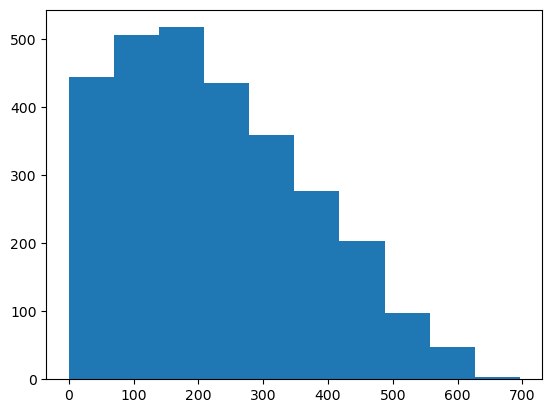

In [15]:
# Let's have a glimpse to this RFM data :
plt.hist(MOC_DF['recency'])

(array([2.694e+03, 1.310e+02, 3.200e+01, 1.400e+01, 9.000e+00, 4.000e+00,
        0.000e+00, 2.000e+00, 1.000e+00, 1.000e+00]),
 array([ 0.52253219,  4.5286123 ,  8.53469242, 12.54077253, 16.54685265,
        20.55293276, 24.55901288, 28.56509299, 32.5711731 , 36.57725322,
        40.58333333]),
 <BarContainer object of 10 artists>)

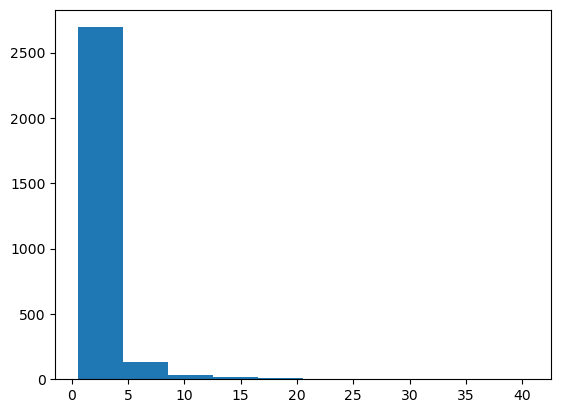

In [16]:
plt.hist(MOC_DF['frequency'])

(0.0, 25.0)

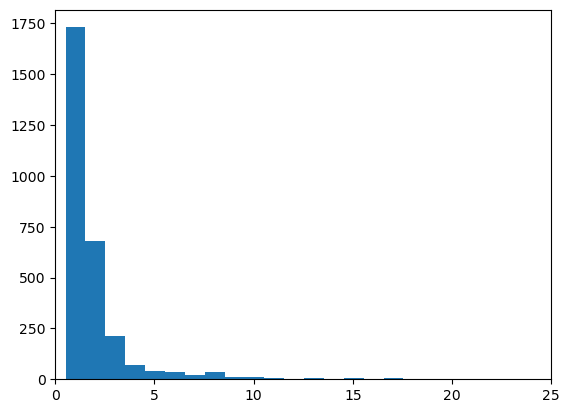

In [17]:
# same data, more detailed :
plt.hist(MOC_DF['frequency'], bins=40)
plt.xlim(0,25)

(array([2.84e+03, 2.90e+01, 1.40e+01, 3.00e+00, 0.00e+00, 1.00e+00,
        0.00e+00, 0.00e+00, 0.00e+00, 1.00e+00]),
 array([ 2. ,  3.4,  4.8,  6.2,  7.6,  9. , 10.4, 11.8, 13.2, 14.6, 16. ]),
 <BarContainer object of 10 artists>)

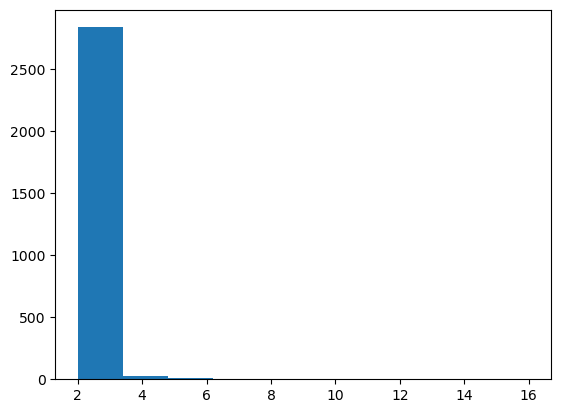

In [18]:
plt.hist(MOC_DF['order_count'])

(2.0, 7.0)

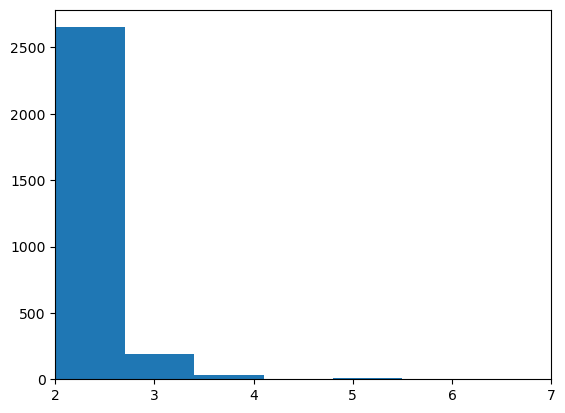

In [19]:
plt.hist(MOC_DF['order_count'], bins=20)
plt.xlim(2,7)

(array([2.746e+03, 1.160e+02, 1.700e+01, 5.000e+00, 2.000e+00, 0.000e+00,
        1.000e+00, 0.000e+00, 0.000e+00, 1.000e+00]),
 array([  35.94 ,  789.509, 1543.078, 2296.647, 3050.216, 3803.785,
        4557.354, 5310.923, 6064.492, 6818.061, 7571.63 ]),
 <BarContainer object of 10 artists>)

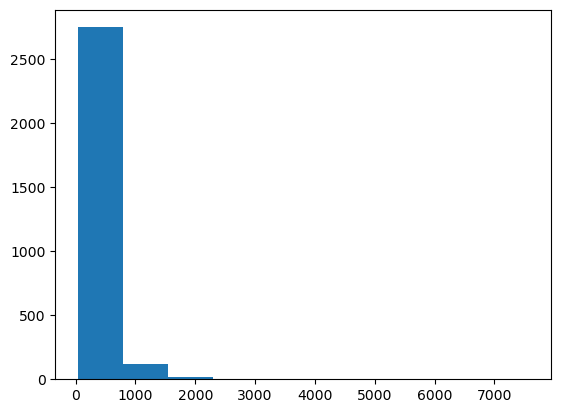

In [20]:
plt.hist(MOC_DF['orders_total_amount'])

(0.0, 2000.0)

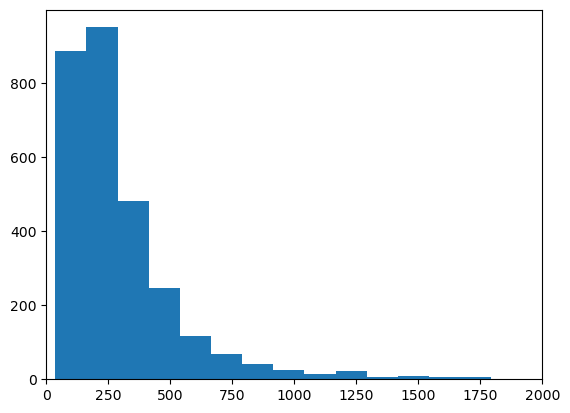

In [21]:
plt.hist(MOC_DF['orders_total_amount'], bins=60)
plt.xlim(0,2000)

<a name='E2'>

Nous n'allons pas cette fois réaliser une segmentation manuelle un peu laborieuse, mais utiliser l'algorithme du k-means. Pour qu'il fonctionne bien, nous allons déjà, étant donnée l'étalement des valeurs, utiliser une transformation logarithmique pour la récence et le montant, puis normaliser les champs que nous allons utiliser.

In [22]:
MOC_DF['M'] = np.log(MOC_DF['orders_total_amount'] + 1)
MOC_DF['R'] = np.log(MOC_DF['recency'] + 1)
MOC_DF.head()

,customer_unique_id,order_count,first_purchase_date,last_purchase_date,first_order_id,first_order_status,orders_total_amount,recency,frequency,M,R
0,004288347e5e88a27ded2bb23747066c,2,2017-07-27 14:13:03,2018-01-14 07:36:54,a61d617fbe5bd006e40d3a0988fc844b,delivered,354.37,232,0.906328,5.873160,5.451038
1,004b45ec5c64187465168251cd1c9c2f,2,2017-09-01 12:11:23,2018-05-26 19:42:48,90ae229a4addcfead792e2564554f09c,shipped,147.72,100,0.995232,5.002065,4.615121
2,00a39521eb40f7012db50455bf083460,2,2018-05-23 20:14:21,2018-06-03 10:12:57,7d32c87acba91ed87ebd98310fe1c54d,delivered,123.25,92,3.546117,4.822296,4.532599
3,00cc12a6d8b578b8ebd21ea4e2ae8b27,2,2017-03-21 19:25:22,2017-03-21 19:25:23,64307ceb91666760cf3ff463618302fd,delivered,126.20,531,0.687853,4.845761,6.276643
4,011575986092c30523ecb71ff10cb473,2,2018-02-17 15:54:49,2018-04-18 21:58:08,0f28d51fdd4828907bdc58b57f672e84,delivered,214.90,138,1.844697,5.374815,4.934474


In [23]:
inertia = []
KM_data = StandardScaler().fit_transform(MOC_DF.take([8,9,10], axis=1))

for k in range(2,20):
    kmeans = KMeans(n_clusters=k, n_init=10)
    kmeans.fit(KM_data)
    inertia.append(kmeans.inertia_)


In [24]:
inertia

[6030.112238914253,
 4495.92179579356,
 3333.4449306998995,
 2854.040302502438,
 2405.376815494196,
 2116.7520855452904,
 1912.81246310758,
 1741.998367935378,
 1582.5955592864784,
 1461.5707539809862,
 1349.6184638309317,
 1267.3121443841637,
 1193.953842806311,
 1132.1231498500617,
 1070.3612986725511,
 1025.1767324114642,
 976.102177260903,
 946.8350719976694]

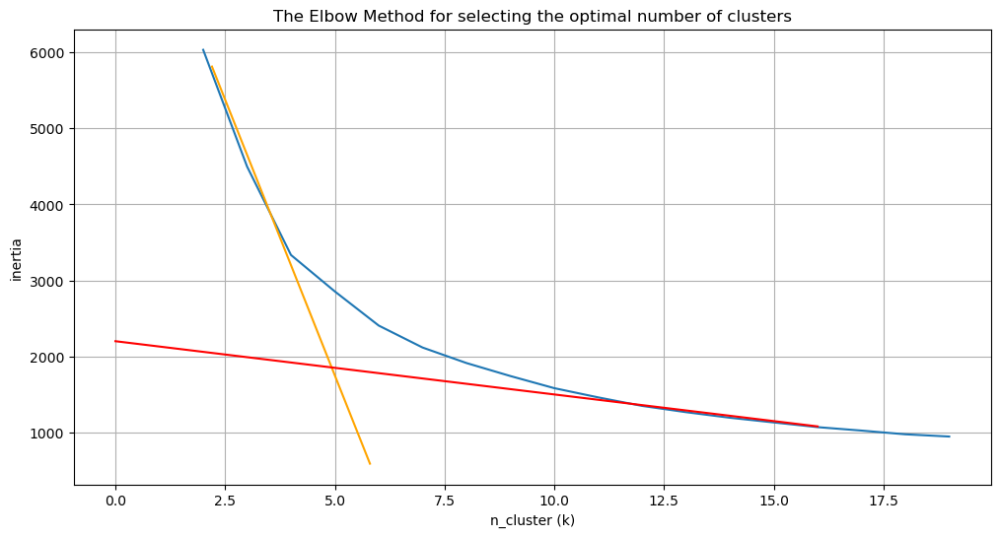

In [31]:
fig, graph = plt.subplots(1,1,figsize=(12,6))

graph.set_ylabel("inertia")
graph.set_xlabel("n_cluster (k)")
graph.plot(range(2,20), inertia)
graph.plot(np.arange(2.2,6,0.3), [9000-1450*x for x in np.arange(2.2,6,0.3)],\
           c='orange' )
graph.plot(np.arange(0,17,1), [2200-70*x for x in np.arange(0,17,1)], c='red')
plt.title('The Elbow Method for selecting the optimal number of clusters')
plt.grid()

In [32]:
kmeans = KMeans(n_clusters=5, n_init=10)
kmeans.fit(KM_data)
kmeans.labels_

array([2, 1, 1, ..., 2, 0, 0])

In [33]:
# let's check that KM_data and MOC_DF are still sorted the same way :
MOC_DF.iloc[2800:2810,8:11]

,frequency,M,R
2800,0.865521,4.803529,4.584967
2801,1.515560,5.757039,5.056246
2802,8.494186,5.872765,3.737670
2803,2.767045,4.556505,4.890349
2804,0.802747,5.673323,6.122493
2805,0.904084,6.492543,6.003887
2806,0.524032,5.396668,6.546785
2807,0.590065,3.694862,6.408529
2808,0.602723,3.669697,6.408529
2809,0.768947,5.916714,5.768321


In [34]:
KM_data[2800:2810,:]

array([[-0.44073983, -0.95597235, -0.63247967],
       [-0.1769991 ,  0.42075013, -0.09436664],
       [ 2.6544439 ,  0.58784171, -1.59993773],
       [ 0.33076695, -1.31263745, -0.28379009],
       [-0.4662092 ,  0.29987762,  1.123091  ],
       [-0.4250937 ,  1.48270559,  0.98766509],
       [-0.57929272, -0.09956981,  1.60755498],
       [-0.55250108, -2.55671911,  1.44969139],
       [-0.54736528, -2.59305337,  1.44969139],
       [-0.47992285,  0.65129677,  0.71869204]])

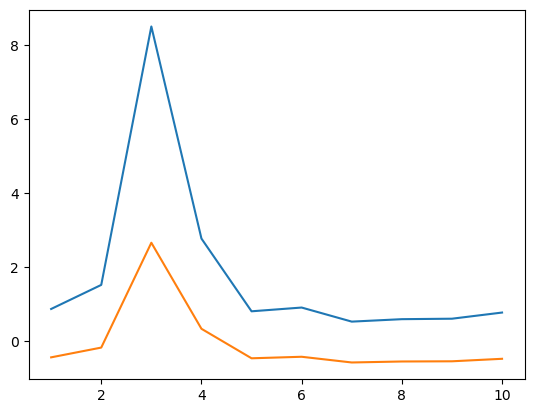

In [35]:
# I can see it's OK, let's show this more clearly :
fig, graph = plt.subplots(1,1)
graph.plot(range(1,11), MOC_DF.iloc[2800:2810,8])
graph.plot(range(1,11), KM_data[2800:2810,0])

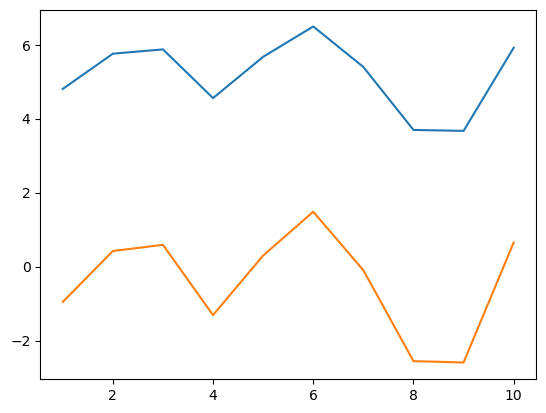

In [36]:
fig, graph = plt.subplots(1,1)
graph.plot(range(1,11), MOC_DF.iloc[2800:2810,9])
graph.plot(range(1,11), KM_data[2800:2810,1])

In [37]:
# and the same for the third. So, we can easily save the clusters in MOC_DF :
MOC_DF['kMeans_clust'] = kmeans.labels_

In [38]:
MOC_DF.to_csv('MOC_DF_RFM.csv')

<Axes: xlabel='recency', ylabel='frequency'>

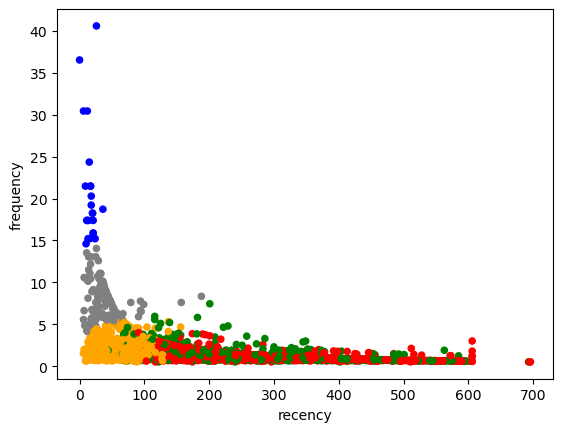

In [39]:
# a first glimpse to the culsters :
colors = ['red','orange','green','blue','grey']
MOC_DF['color'] = MOC_DF['kMeans_clust'].map(lambda p: colors[p])
MOC_DF.plot(kind='scatter', x='recency', y='frequency', c=MOC_DF['color']) #c=colors.index(MOC_DF['kMeans_clust']))

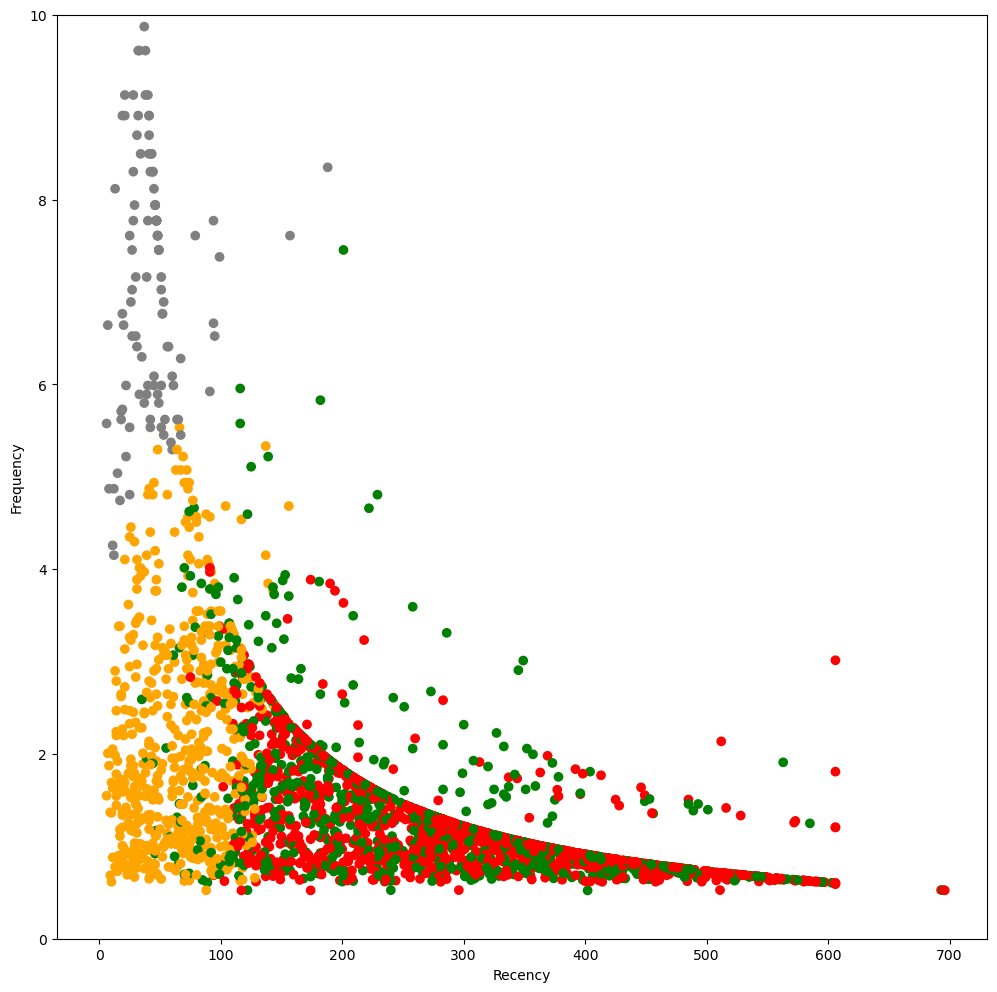

In [41]:
# A zoom on the most populated area :
fig, graph = plt.subplots(1,1,figsize=(12,12))
plt.ylim(0,10)
graph.scatter(MOC_DF['recency'], MOC_DF['frequency'], c=MOC_DF['color'])
graph.set_xlabel('Recency')
graph.set_ylabel('Frequency')
plt.show()

<Axes: xlabel='frequency', ylabel='orders_total_amount'>

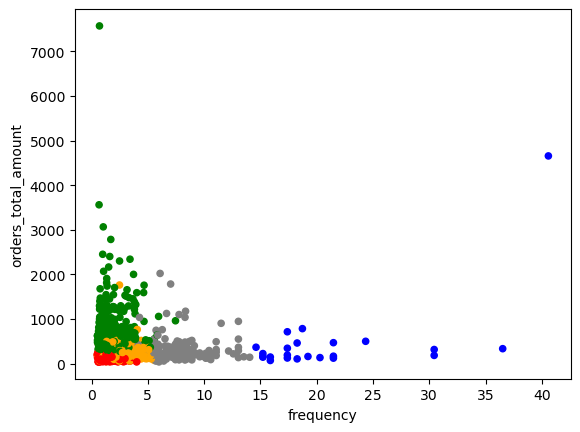

In [42]:
MOC_DF.plot(kind='scatter', x='frequency', y='orders_total_amount',\
            c=MOC_DF['color'])

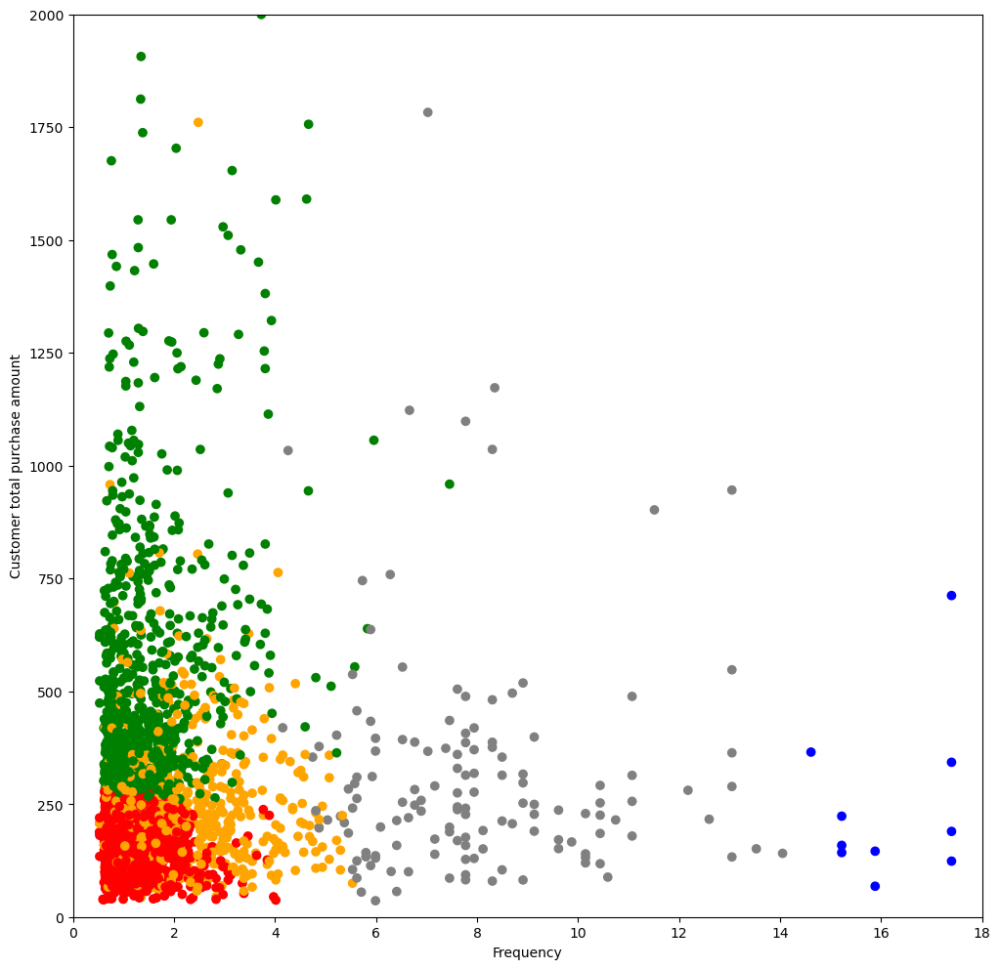

In [43]:
fig, graph = plt.subplots(1,1,figsize=(12,12))
plt.xlim(0,18)
plt.ylim(0,2000)
graph.scatter(MOC_DF['frequency'], MOC_DF['orders_total_amount'],\
              c=MOC_DF['color'])
graph.set_xlabel('Frequency')
graph.set_ylabel('Customer total purchase amount')
plt.show()

On voit ici clairement que ce qui distingue les verts des rouges c'est le montant dépensé, avec une séparation vers 250 reals.
<br>Mais ces deux groupes n'achètent pas fréquemment.
<br>Les gris et les bleus ont les plus grandes frequences d'achat, et ont d'ailleurs acheté récemment.
<br>les oranges n'ont pas une haute fréquence mais ont aussi acheté récemment.
<br>**Les groupes sont donc caractérisés de la façon suivante :**
<br>ROUGES : Achats pas très fréquents, pas très récents et peu onéreux
<br>VERTS : Achats pas très fréquents, pas très récents et plutôt onéreux
<br>ORANGES : Achats peu ou moyennement fréquents mais récents
<br>GRIS : Achats fréquents (et donc assez récents)
<br>BLEUS : Achats très fréquents (et donc très récents)
On peut connaître les tailles de ces groupes:

In [44]:
print('RED    : ' + str(MOC_DF.loc[MOC_DF['color'] == 'red',\
                                   'customer_unique_id'].count()))
print('GREEN  : ' + str(MOC_DF.loc[MOC_DF['color'] == 'green',\
                                   'customer_unique_id'].count()))
print('ORANGE : ' + str(MOC_DF.loc[MOC_DF['color'] == 'orange',\
                                   'customer_unique_id'].count()))
print('GREY   : ' + str(MOC_DF.loc[MOC_DF['color'] == 'grey',\
                                   'customer_unique_id'].count()))
print('BLUE   : ' + str(MOC_DF.loc[MOC_DF['color'] == 'blue',\
                                   'customer_unique_id'].count()))

RED    : 1298
GREEN  : 873
ORANGE : 556
GREY   : 138
BLUE   : 23


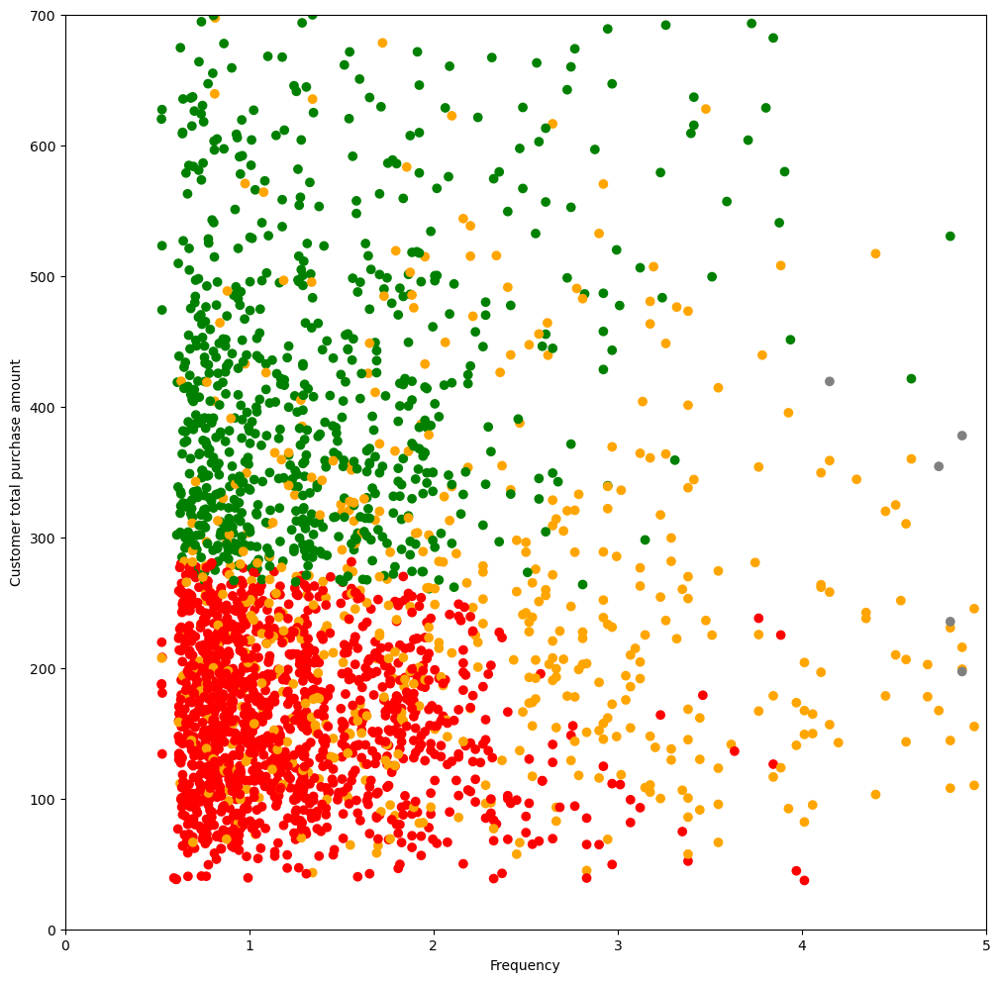

In [45]:
fig, graph = plt.subplots(1,1,figsize=(12,12))
plt.xlim(0,5)
plt.ylim(0,700)
graph.scatter(MOC_DF['frequency'], MOC_DF['orders_total_amount'],\
              c=MOC_DF['color'])
graph.set_xlabel('Frequency')
graph.set_ylabel('Customer total purchase amount')
plt.show()

In [46]:
# the border between reds and greens is rather arround 280 reals
MOC_DF.to_csv('MOC_DF_RFM.csv')

The day after ... K-Means has a random side, so I've checked whether a second computation generates the same clusters, and observed that indeed a new computation doesn't challenge the clusters.
<br>Let's see which would be the clusters if we want to have six, as it is also an interesting value, from the elbow method :

<Axes: xlabel='recency', ylabel='frequency'>

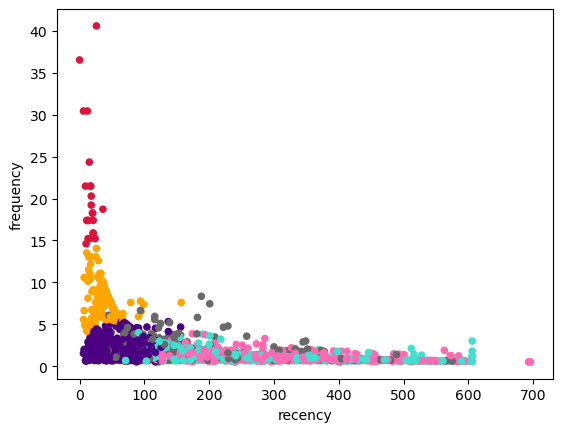

In [4]:
KM_data = StandardScaler().fit_transform(MOC_DF.take([8,9,10], axis=1))
kmeans = KMeans(n_clusters=6, n_init=10)
kmeans.fit(KM_data)
MOC_DF['kMeans_clust2'] = kmeans.labels_
colors = ['crimson','hotpink','turquoise','indigo','dimgrey','orange']
MOC_DF['color2'] = MOC_DF['kMeans_clust2'].map(lambda p: colors[p])
MOC_DF.plot(kind='scatter', x='recency', y='frequency', c=MOC_DF['color2'])

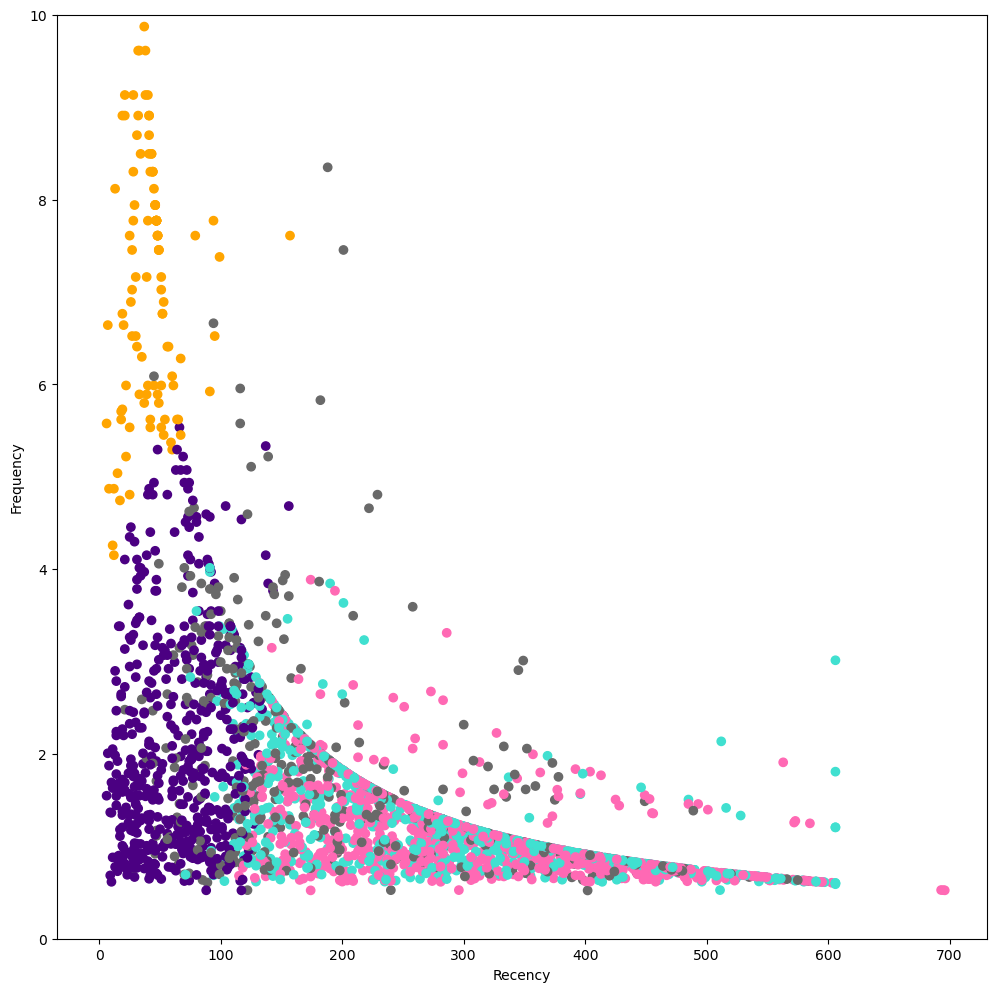

In [6]:
fig, graph = plt.subplots(1,1,figsize=(12,12))
plt.ylim(0,10)
graph.scatter(MOC_DF['recency'], MOC_DF['frequency'], c=MOC_DF['color2'])
graph.set_xlabel('Recency')
graph.set_ylabel('Frequency')
plt.show()

<Axes: xlabel='frequency', ylabel='orders_total_amount'>

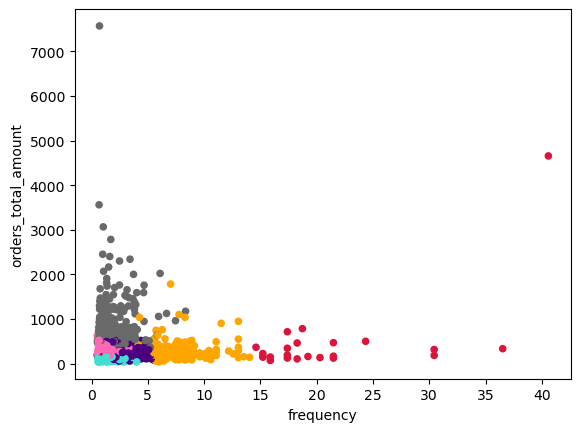

In [5]:
MOC_DF.plot(kind='scatter', x='frequency', y='orders_total_amount',\
            c=MOC_DF['color2'])

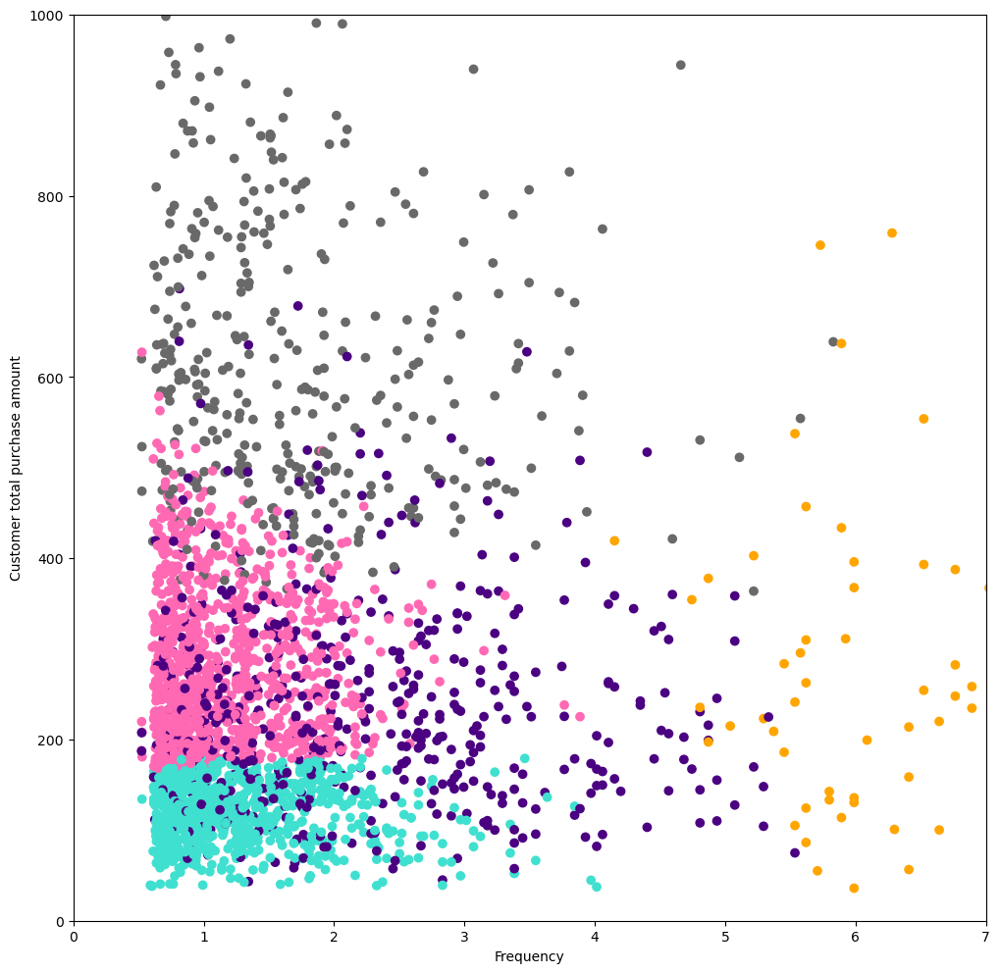

In [8]:
fig, graph = plt.subplots(1,1,figsize=(12,12))
plt.xlim(0,7)
plt.ylim(0,1000)
graph.scatter(MOC_DF['frequency'], MOC_DF['orders_total_amount'],\
              c=MOC_DF['color2'])
graph.set_xlabel('Frequency')
graph.set_ylabel('Customer total purchase amount')
plt.show()

L'effet d'un sixième cluster est principalement de diviser un peu plus les deux groupes :
<br>ROUGES : Achats pas très fréquents, pas très récents et peu honéreux
<br>VERTS  : Achats pas très fréquents, pas très récents et plutôt honéreux
<br>en trois groupes :
<br>GRIS      : Achats pas très fréquents, pas très récents et honéreux
<br>ROSE      : Achats pas très fréquents, pas très récents et moyennement honéreux
<br>TURQUOISE : Achats pas très fréquents, pas très récents et très peu honéreux
<br>Donc plus (+) de distinction par rapport au montant dépensé. Pour les autres, ils sont restés assez identiques, on peut voir les cardinaux:

In [10]:
print('PINK      : ' + str(MOC_DF.loc[MOC_DF['color2'] == 'hotpink',\
                                   'customer_unique_id'].count()))
print('TURQUOISE : ' + str(MOC_DF.loc[MOC_DF['color2'] == 'turquoise',\
                                   'customer_unique_id'].count()))
print('INDIGO    : ' + str(MOC_DF.loc[MOC_DF['color2'] == 'indigo',\
                                   'customer_unique_id'].count()))
print('GREY      : ' + str(MOC_DF.loc[MOC_DF['color2'] == 'dimgrey',\
                                   'customer_unique_id'].count()))
print('ORANGE    : ' + str(MOC_DF.loc[MOC_DF['color2'] == 'orange',\
                                   'customer_unique_id'].count()))
print('RED       : ' + str(MOC_DF.loc[MOC_DF['color2'] == 'crimson',\
                                   'customer_unique_id'].count()))

PINK      : 991
TURQUOISE : 773
INDIGO    : 528
GREY      : 438
ORANGE    : 135
RED       : 23


Avec cinq classes nous avions :
<br>RED    : 1298
<br>GREEN  : 873
<br>ORANGE : 556
<br>GREY   : 138
<br>BLUE   : 23
<br>Donc c'est en fait trois classes qui sont devenues quatre. Il me semble que cinq classes est un meilleur choix, pour la clarté de leur interpretation.
<br>D'ailleurs nous avons une méthode de sélection performante : le coefficient 'silhouette' qui indique, avec graphique à l'appui, la qualité de la répartition des individus parmis les classes. Regardons ce que cela donne pour K = 5 et K = 6: (et au passage utiliser le score de Calinski-Harabasz pour la méthode du coude puisque nous allons utiliser la librairie Yellowbrick qui offre cette option).

C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of

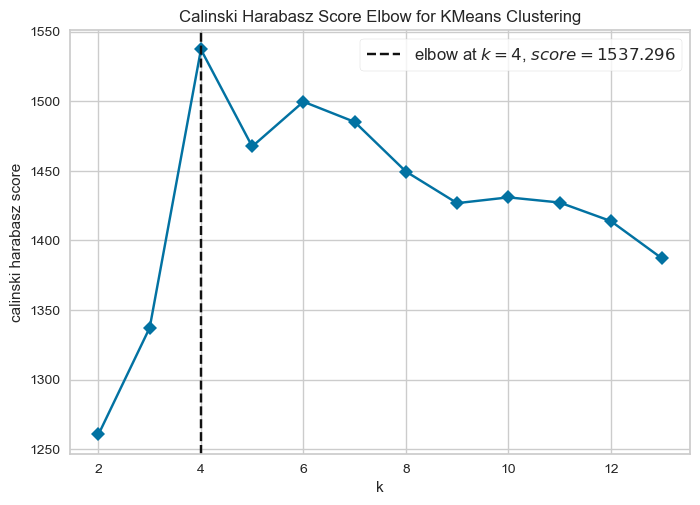

<Axes: title={'center': 'Calinski Harabasz Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='calinski harabasz score'>

In [4]:
visualizer = KElbowVisualizer(KMeans(), k=(2,14), metric='calinski_harabasz', timings=False)
visualizer.fit(KM_data)
visualizer.poof()

C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


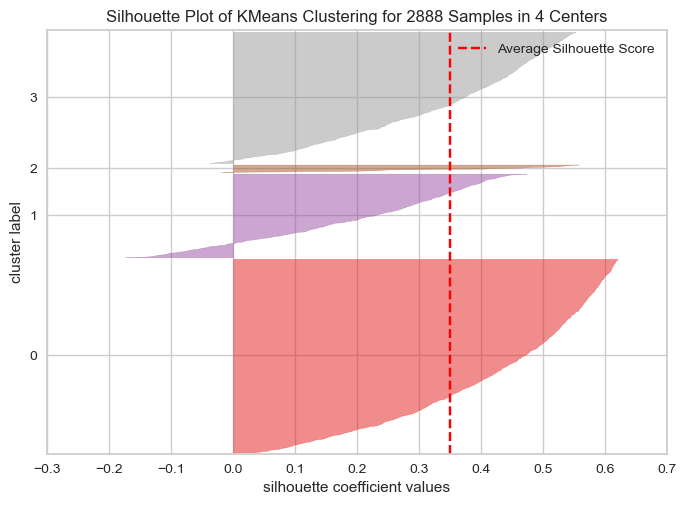

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 2888 Samples in 4 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [5]:
# finaly, the optimum k value seems to be 4 !
visualizer = SilhouetteVisualizer(KMeans(4))
visualizer.fit(KM_data)
visualizer.poof()

C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


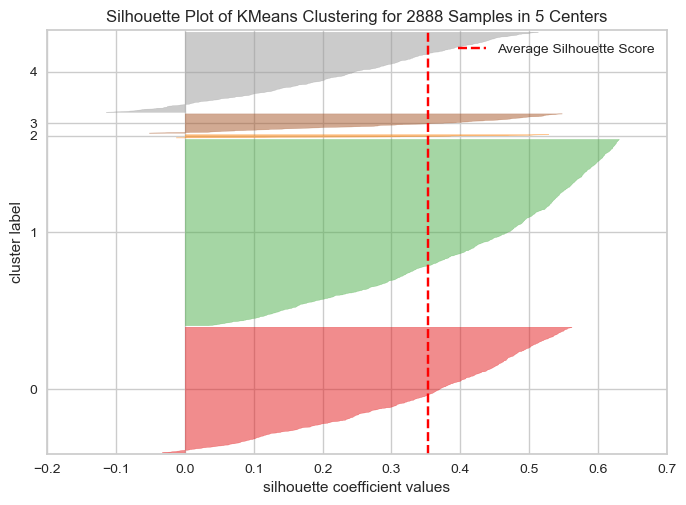

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 2888 Samples in 5 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [6]:
visualizer = SilhouetteVisualizer(KMeans(5))
visualizer.fit(KM_data)
visualizer.poof()

C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


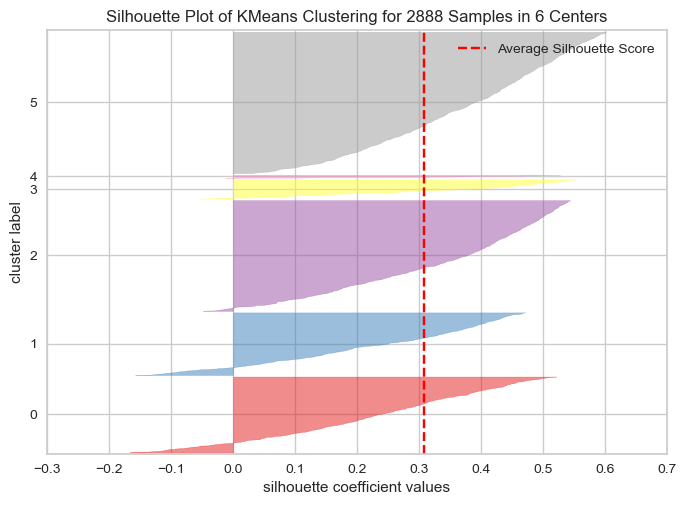

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 2888 Samples in 6 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [7]:
# from the silhouette coef. the value k = 5 is not worse than k = 4,
# and with 6 finally ?
visualizer = SilhouetteVisualizer(KMeans(6))
visualizer.fit(KM_data)
visualizer.poof()

En effet k=6 offre une moins bonne partition que pour 4 ou 5. Nous pouvons rester sur 5 à ce stade.
Au passage (mais pas gardé ici) j'ai revérifié la stabilité de la partition avec k=5 : toujours exactement la même !
<br><a name='E3'>

Nous allons maintenant considérer l'ensemble des données, c'est à dire regrouper les UOC et les MOC, en affectant aux UOC la fréquence (optimiste) de 0.5, puisqu'ils ont tous fait une commande en deux ans environ.
<br>Puis nous allons de nouveau déterminer des classes avec le k-means, voir ce que cela donne sur les UOC, et si nous allons retrouver les mêmes classes sur les MOC ?

In [11]:
UOC_DF = pd.read_csv('UOC_DF.csv')
UOC_DF = UOC_DF.drop('Unnamed: 0', axis=1)
UOC_DF.columns

Index(['customer_unique_id', 'customer_id', 'order_purchase_date', 'order_id',
       'order_status', 'order_amount', 'recency'],
      dtype='object')

In [13]:
Full_DF = UOC_DF.take([0,2,5,6], axis=1)
Full_DF = Full_DF.rename(columns={'order_purchase_date':'first_purchase_date',\
                                  'order_amount':'orders_total_amount'})
print(Full_DF.shape)
Full_DF.head()

(92001, 4)


,customer_unique_id,first_purchase_date,orders_total_amount,recency
0,861eff4711a542e4b93843c6dd7febb0,2017-05-16 15:05:35,146.87,533
1,290c77bc529b7ac935b93aa66c333dc3,2018-01-12 20:48:24,335.48,292
2,060e732b5b29e8181a18229c7b0b2b5e,2018-05-19 16:07:45,157.73,165
3,259dac757896d24d7702b9acbbff3f3c,2018-03-13 16:06:38,173.30,232
4,345ecd01c38d18a9036ed96c73b8d066,2018-07-29 09:51:30,252.25,94


In [14]:
Full_DF.insert(1,'order_count',1)
Full_DF.insert(3,'last_purchase_date',pd.NA)
Full_DF['frequency'] = 0.5
Full_DF.head()

,customer_unique_id,order_count,first_purchase_date,last_purchase_date,orders_total_amount,recency,frequency
0,861eff4711a542e4b93843c6dd7febb0,1,2017-05-16 15:05:35,<NA>,146.87,533,0.5
1,290c77bc529b7ac935b93aa66c333dc3,1,2018-01-12 20:48:24,<NA>,335.48,292,0.5
2,060e732b5b29e8181a18229c7b0b2b5e,1,2018-05-19 16:07:45,<NA>,157.73,165,0.5
3,259dac757896d24d7702b9acbbff3f3c,1,2018-03-13 16:06:38,<NA>,173.30,232,0.5
4,345ecd01c38d18a9036ed96c73b8d066,1,2018-07-29 09:51:30,<NA>,252.25,94,0.5


Nous devons homogénéiser la date de référence pour les deux jeux avant de les regrouper. Pour les UOC nous avions : '2018-08-31 00:00:00' et pour les MOC : '2018-09-04 00:00:00'. Nous prenons la moins ancienne des deux soit '2018-09-04 00:00:00', de ce fait il faut aouter 4 (jours) à la récence des UOC :

In [15]:
Full_DF['recency'] = Full_DF['recency'] + 4

In [16]:
Full_DF = pd.concat([Full_DF, MOC_DF.take([0,1,2,3,6,7,8], axis=1)],\
                    ignore_index=True)
print(Full_DF.shape)
Full_DF.head()

(94889, 7)


,customer_unique_id,order_count,first_purchase_date,last_purchase_date,orders_total_amount,recency,frequency
0,861eff4711a542e4b93843c6dd7febb0,1,2017-05-16 15:05:35,NaN,146.87,537,0.5
1,290c77bc529b7ac935b93aa66c333dc3,1,2018-01-12 20:48:24,NaN,335.48,296,0.5
2,060e732b5b29e8181a18229c7b0b2b5e,1,2018-05-19 16:07:45,NaN,157.73,169,0.5
3,259dac757896d24d7702b9acbbff3f3c,1,2018-03-13 16:06:38,NaN,173.30,236,0.5
4,345ecd01c38d18a9036ed96c73b8d066,1,2018-07-29 09:51:30,NaN,252.25,98,0.5


In [17]:
Full_DF.to_csv('Full_DF.csv')
Full_DF.tail()

,customer_unique_id,order_count,first_purchase_date,last_purchase_date,orders_total_amount,recency,frequency
94884,ff22e30958c13ffe219db7d711e8f564,2,2018-08-24 17:02:19,2018-09-03 09:06:57,332.92,0,36.525000
94885,ff44401d0d8f5b9c54a47374eb48c1b8,2,2017-05-19 21:20:54,2017-05-19 21:20:54,68.00,472,0.773835
94886,ff8892f7c26aa0446da53d01b18df463,2,2017-05-24 16:09:14,2017-11-26 23:25:43,330.14,281,0.782120
94887,ff922bdd6bafcdf99cb90d7f39cea5b3,3,2017-02-22 12:26:42,2017-09-14 14:24:04,139.60,354,1.309140
94888,ffe254cc039740e17dd15a5305035928,2,2017-04-02 16:33:30,2017-04-02 16:33:30,80.12,519,0.703757


In [18]:
inertia = []
KM_data = StandardScaler().fit_transform(Full_DF.take([4,5,6], axis=1))

for k in range(2,20):
    kmeans = KMeans(n_clusters=k, n_init=10)
    kmeans.fit(KM_data)
    inertia.append(kmeans.inertia_)


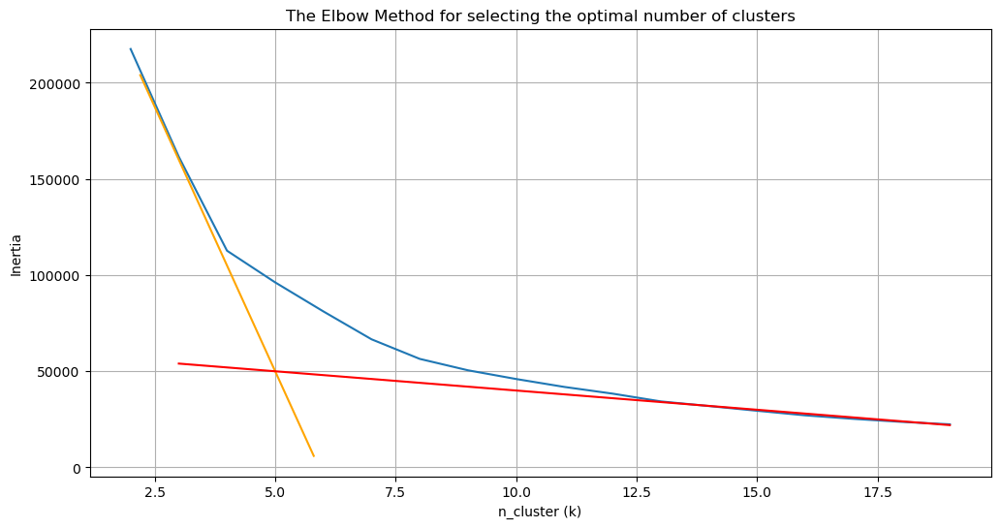

In [29]:
fig, graph = plt.subplots(1,1,figsize=(12,6))

graph.set_ylabel("Inertia")
graph.set_xlabel("n_cluster (k)")
graph.plot(range(2,20), inertia)
graph.plot(np.arange(2.2,6,0.3), [325000-55000*x for x in np.arange(2.2,6,0.3)],\
           c='orange' )
graph.plot(np.arange(3,20,1), [60000-2000*x for x in np.arange(3,20,1)], c='red')
plt.title('The Elbow Method for selecting the optimal number of clusters')
plt.grid()

In [30]:
# the optimal k could be from 4 to 7, let's begin with 5 again :
kmeans = KMeans(n_clusters=5, n_init=10)
kmeans.fit(KM_data)
Full_DF['kMeans_clust'] = kmeans.labels_

<Axes: xlabel='recency', ylabel='frequency'>

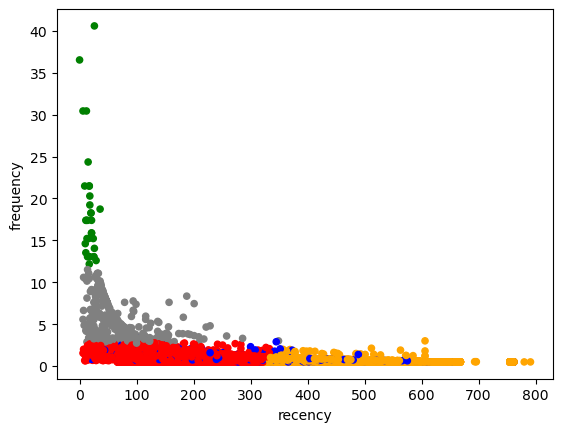

In [31]:
# a first glimpse to the culsters :
colors = ['red','orange','green','blue','grey']
Full_DF['color'] = Full_DF['kMeans_clust'].map(lambda p: colors[p])
Full_DF.plot(kind='scatter', x='recency', y='frequency', c=Full_DF['color'])

<Axes: xlabel='frequency', ylabel='orders_total_amount'>

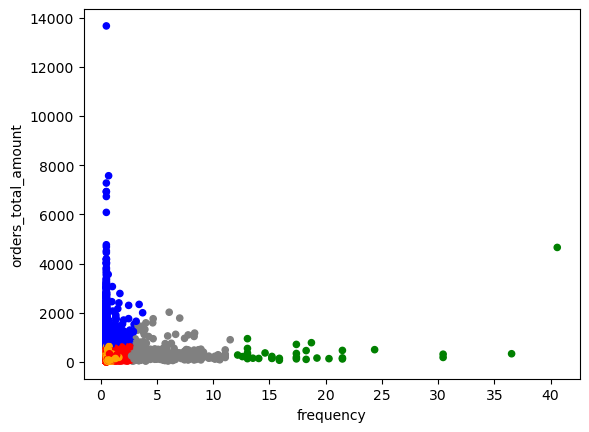

In [32]:
Full_DF.plot(kind='scatter', x='frequency', y='orders_total_amount', c=Full_DF['color'])

In [34]:
print('RED    : ' + str(Full_DF.loc[Full_DF['color'] == 'red',\
                                   'customer_unique_id'].count()))
print('ORANGE : ' + str(Full_DF.loc[Full_DF['color'] == 'orange',\
                                   'customer_unique_id'].count()))
print('BLUE   : ' + str(Full_DF.loc[Full_DF['color'] == 'blue',\
                                   'customer_unique_id'].count()))
print('GREY   : ' + str(Full_DF.loc[Full_DF['color'] == 'grey',\
                                   'customer_unique_id'].count()))
print('GREEN  : ' + str(Full_DF.loc[Full_DF['color'] == 'green',\
                                   'customer_unique_id'].count()))

RED    : 52756
ORANGE : 38756
BLUE   : 2971
GREY   : 374
GREEN  : 32


<Axes: xlabel='order_count', ylabel='orders_total_amount'>

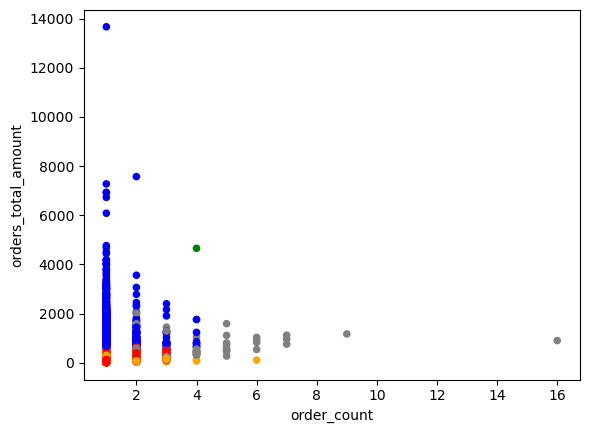

In [35]:
Full_DF.plot(kind='scatter', x='order_count', y='orders_total_amount',\
             c=Full_DF['color'])

C:\Users\jlper\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


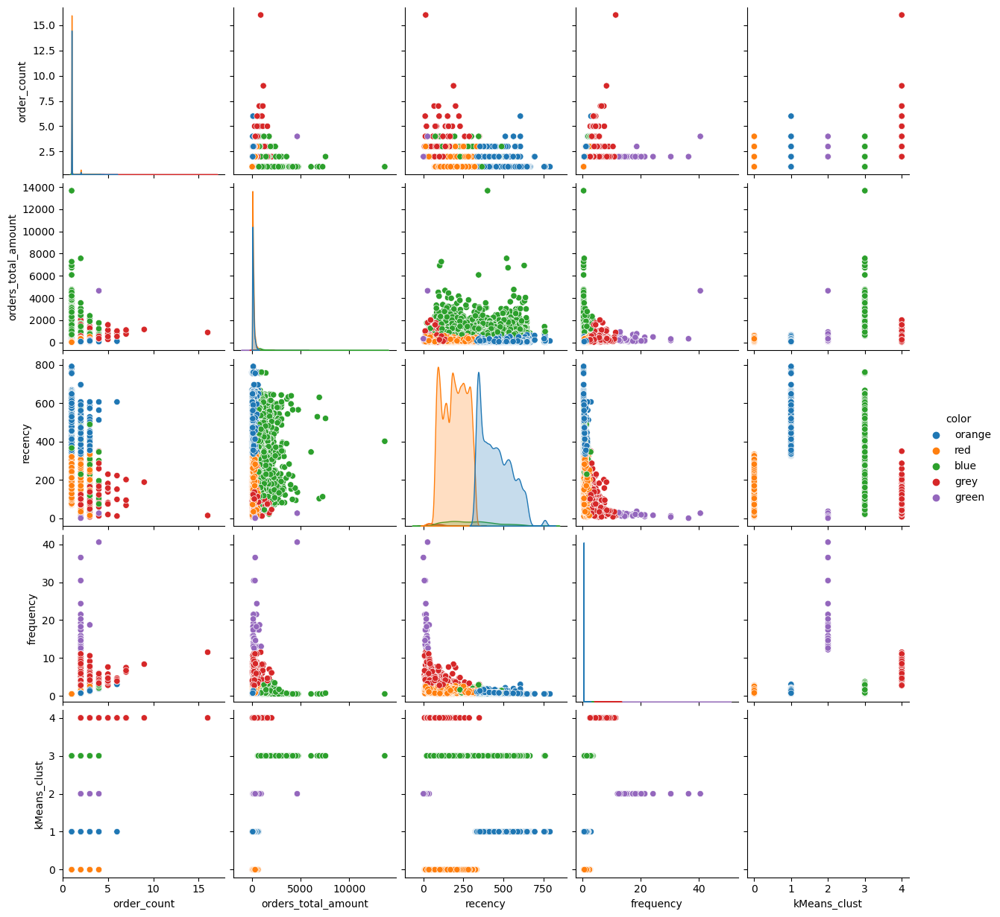

In [36]:
sns.pairplot(Full_DF, hue="color")

Pour exploiter ce 'pairplot' avec plus de facilité, je vais changer les couleurs dans mes données pour m'aligner à celles de seaborn, et on pourra ignorer la legende à droite.

In [37]:
Full_DF.loc[Full_DF['color'] == 'orange', 'color'] = 'dodgerblue'

In [38]:
Full_DF.loc[Full_DF['color'] == 'green', 'color'] = 'mediumpurple'
Full_DF.loc[Full_DF['color'] == 'grey', 'color'] = 'crimson'
Full_DF.loc[Full_DF['color'] == 'red', 'color'] = 'darkorange'
Full_DF.loc[Full_DF['color'] == 'blue', 'color'] = 'limegreen'

<Axes: xlabel='recency', ylabel='frequency'>

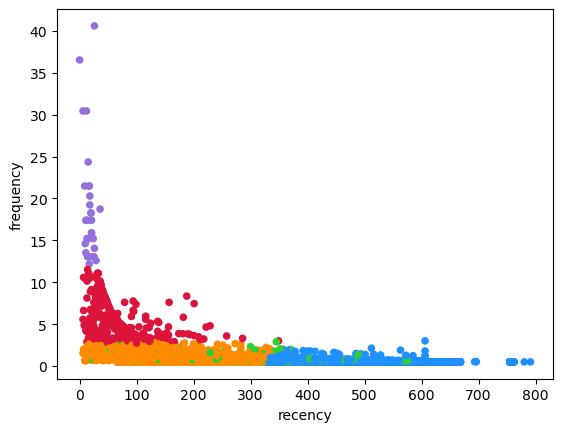

In [41]:
Full_DF.plot(kind='scatter', x='recency', y='frequency', c=Full_DF['color'])

In [43]:
print('ORANGE : ' + str(Full_DF.loc[Full_DF['color'] == 'darkorange',\
                                   'customer_unique_id'].count()))
print('BLUE   : ' + str(Full_DF.loc[Full_DF['color'] == 'dodgerblue',\
                                   'customer_unique_id'].count()))
print('GREEN  : ' + str(Full_DF.loc[Full_DF['color'] == 'limegreen',\
                                   'customer_unique_id'].count()))
print('RED    : ' + str(Full_DF.loc[Full_DF['color'] == 'crimson',\
                                   'customer_unique_id'].count()))
print('PURPLE : ' + str(Full_DF.loc[Full_DF['color'] == 'mediumpurple',\
                                   'customer_unique_id'].count()))

ORANGE : 52756
BLUE   : 38756
GREEN  : 2971
RED    : 374
PURPLE : 32


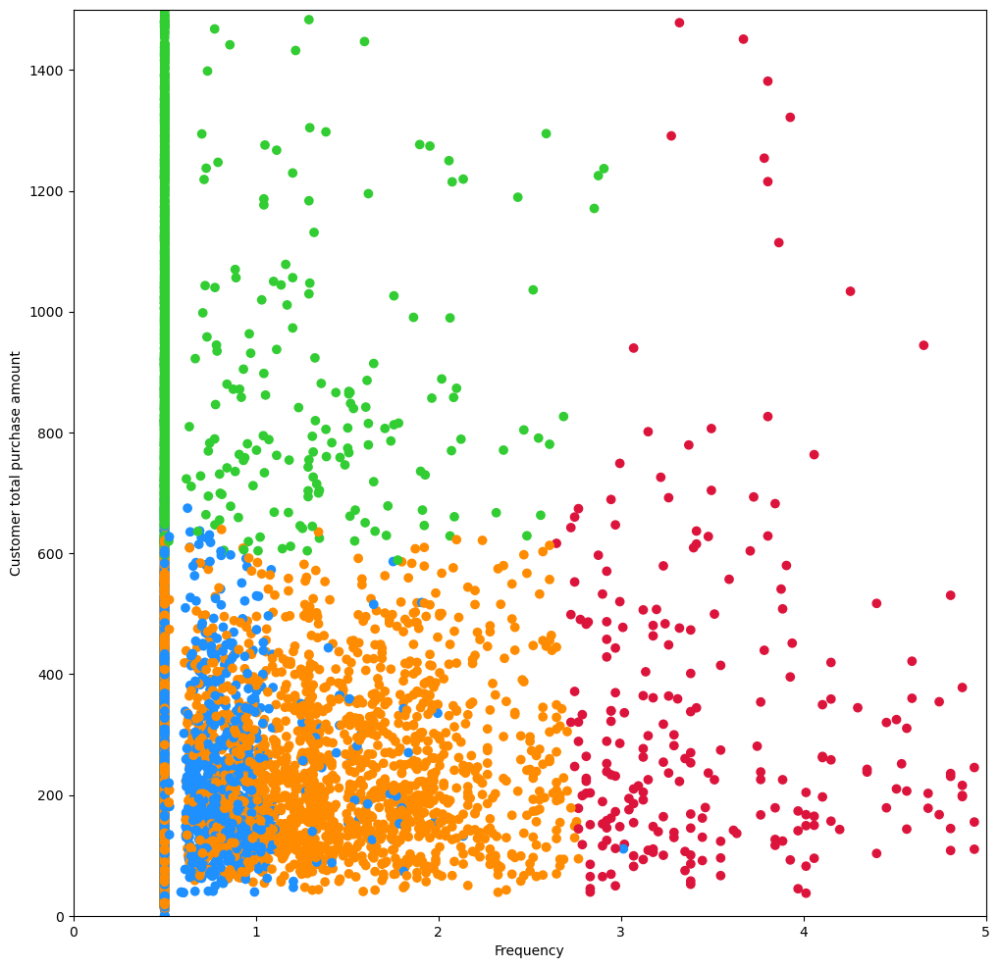

In [44]:
fig, graph = plt.subplots(1,1,figsize=(12,12))
plt.xlim(0,5)
plt.ylim(0,1500)
graph.scatter(Full_DF['frequency'], Full_DF['orders_total_amount'],\
              c=Full_DF['color'])
graph.set_xlabel('Frequency')
graph.set_ylabel('Customer total purchase amount')
plt.show()

Voici **le bilan de ces observations, caractérisant les clusters :** ('client' désigne ci-dessous une personne unique, ayant donc pu passer plusieurs commandes; Les tendances indiquées ne prennent pas en compte quelques 'layouts')
<br>**ORANGE** : 52756 clients, ayant passé commande dans l'année écoulée, mais totalisant moins de trois commandes par an, pour un montant total < 650 reals.
<br>**BLEU**   : 38756 clients, n'ayant pas commandé depuis plus de 9 mois, et pour la plupart une seule commande, en tout cas pour un montant total < 650 reals.
<br>**VERT**   : 2971 clients, ne commandant pas souvent (moins de trois fois par an) mais pour un montant total > 600 reals.
<br>**ROUGE**  : 374 clients, ayant passé commande dans l'année écoulée, totalisant plus de 2,7 commandes par an, et ayant assuremment réalisé au moins deux commandes depuis leur première (incluse)
<br>**VIOLET** : 32 clients, qui commandent souvent (au moins 10 fois par an) et ayant donc réalisé au moins deux commandes depuis leur première (incluse)

In [49]:
Limited_Full_DF = Full_DF.loc[(Full_DF['frequency'] < 6) &\
                              (Full_DF['orders_total_amount'] < 1500) &\
                              (Full_DF['recency'] < 500),\
                              ['frequency','orders_total_amount',\
                               'recency','color']]
fig= px.scatter_3d(Limited_Full_DF, x='frequency',
                   y='orders_total_amount',
                   z='recency', color='color',
                   opacity=0.8)
fig.update_traces(marker_size = 3)
#fig.update_layout(margin=dict(l=3, r=3, b=3, t=3))
fig.show()

In [ ]:
# Colors are not respected (??) but it's nice to have the clusters in 3D
# Let's try with k=4 to see how the clusters will be defined :

In [1]:
import pandas as pd
Full_DF = pd.read_csv('Full_DF.csv')
Full_DF = Full_DF.drop('Unnamed: 0', axis=1)
Full_DF.columns

C:\Users\jlper\AppData\Local\Temp\ipykernel_10960\2446421721.py:2: DtypeWarning: Columns (4) have mixed types. Specify dtype option on import or set low_memory=False.
  Full_DF = pd.read_csv('Full_DF.csv')


Index(['customer_unique_id', 'order_count', 'first_purchase_date',
       'last_purchase_date', 'orders_total_amount', 'recency', 'frequency'],
      dtype='object')

In [2]:
Full_DF['orders_total_amount'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 94889 entries, 0 to 94888
Series name: orders_total_amount
Non-Null Count  Dtype  
--------------  -----  
94889 non-null  float64
dtypes: float64(1)
memory usage: 741.4 KB


In [3]:
Full_DF['last_purchase_date'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 94889 entries, 0 to 94888
Series name: last_purchase_date
Non-Null Count  Dtype 
--------------  ----- 
2888 non-null   object
dtypes: object(1)
memory usage: 741.4+ KB


In [4]:
# a step I've forgotten for the first k-means with Full_DF :
Full_DF['M'] = np.log(Full_DF['orders_total_amount'] + 1)
Full_DF['R'] = np.log(Full_DF['recency'] + 1)
Full_DF.head()

,customer_unique_id,order_count,first_purchase_date,last_purchase_date,orders_total_amount,recency,frequency,M,R
0,861eff4711a542e4b93843c6dd7febb0,1,2017-05-16 15:05:35,NaN,146.87,537,0.5,4.996334,6.287859
1,290c77bc529b7ac935b93aa66c333dc3,1,2018-01-12 20:48:24,NaN,335.48,296,0.5,5.818539,5.693732
2,060e732b5b29e8181a18229c7b0b2b5e,1,2018-05-19 16:07:45,NaN,157.73,169,0.5,5.067205,5.135798
3,259dac757896d24d7702b9acbbff3f3c,1,2018-03-13 16:06:38,NaN,173.30,236,0.5,5.160778,5.468060
4,345ecd01c38d18a9036ed96c73b8d066,1,2018-07-29 09:51:30,NaN,252.25,98,0.5,5.534377,4.595120


<Axes: xlabel='recency', ylabel='frequency'>

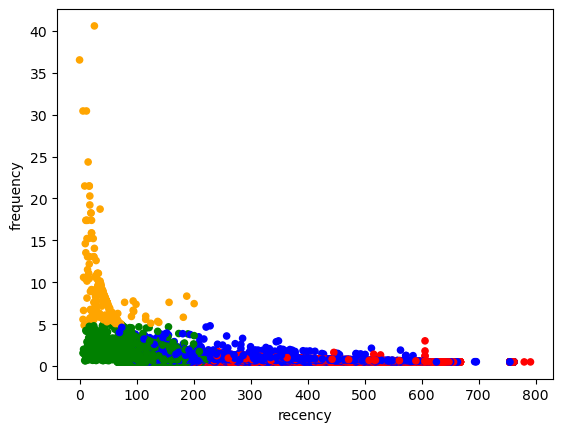

In [6]:
Full_DF.to_csv('Full_DF.csv')
KM_data = StandardScaler().fit_transform(Full_DF.take([6,7,8], axis=1))
kmeans = KMeans(n_clusters=4, n_init=10)
kmeans.fit(KM_data)
Full_DF['kMeans_clust'] = kmeans.labels_
colors = ['red','blue','green','orange']
Full_DF['color'] = Full_DF['kMeans_clust'].map(lambda p: colors[p])
Full_DF.plot(kind='scatter', x='recency', y='frequency', c=Full_DF['color'])

<Axes: xlabel='frequency', ylabel='orders_total_amount'>

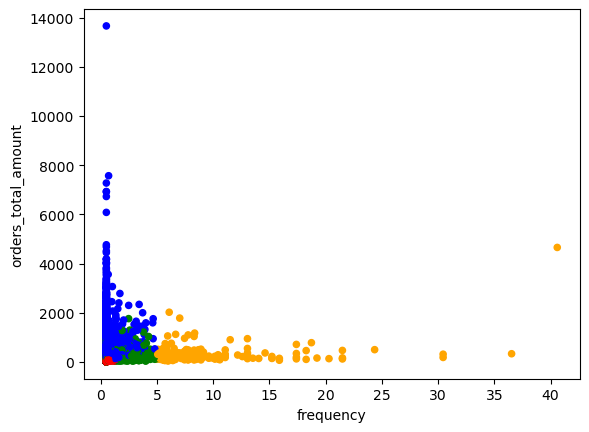

In [7]:
Full_DF.plot(kind='scatter', x='frequency', y='orders_total_amount',\
             c=Full_DF['color'])

In [10]:
print('RED    : ' + str(Full_DF.loc[Full_DF['color'] == 'red',\
                                   'customer_unique_id'].count()))
print('BLUE   : ' + str(Full_DF.loc[Full_DF['color'] == 'blue',\
                                   'customer_unique_id'].count()))
print('GREEN  : ' + str(Full_DF.loc[Full_DF['color'] == 'green',\
                                   'customer_unique_id'].count()))
print('ORANGE : ' + str(Full_DF.loc[Full_DF['color'] == 'orange',\
                                   'customer_unique_id'].count()))

RED    : 39491
BLUE   : 28679
GREEN  : 26548
ORANGE : 171


<Axes: xlabel='frequency', ylabel='order_count'>

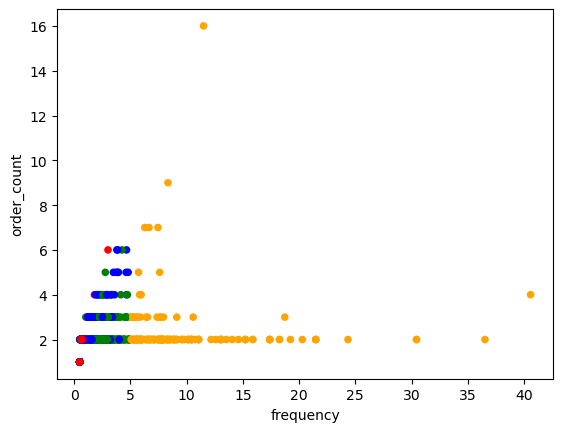

In [11]:
Full_DF.plot(kind='scatter', x='frequency', y='order_count', c=Full_DF['color'])

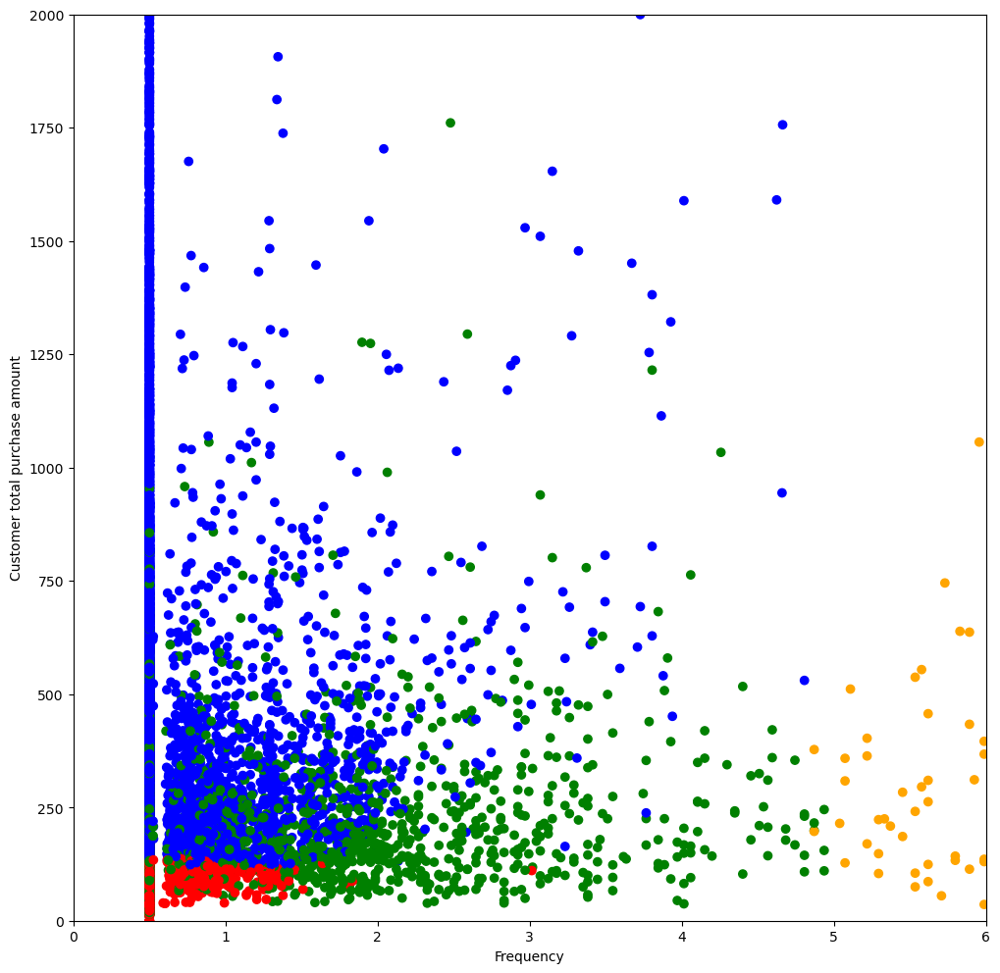

In [12]:
fig, graph = plt.subplots(1,1,figsize=(12,12))
plt.xlim(0,6)
plt.ylim(0,2000)
graph.scatter(Full_DF['frequency'], Full_DF['orders_total_amount'],\
              c=Full_DF['color'])
graph.set_xlabel('Frequency')
graph.set_ylabel('Customer total purchase amount')
plt.show()

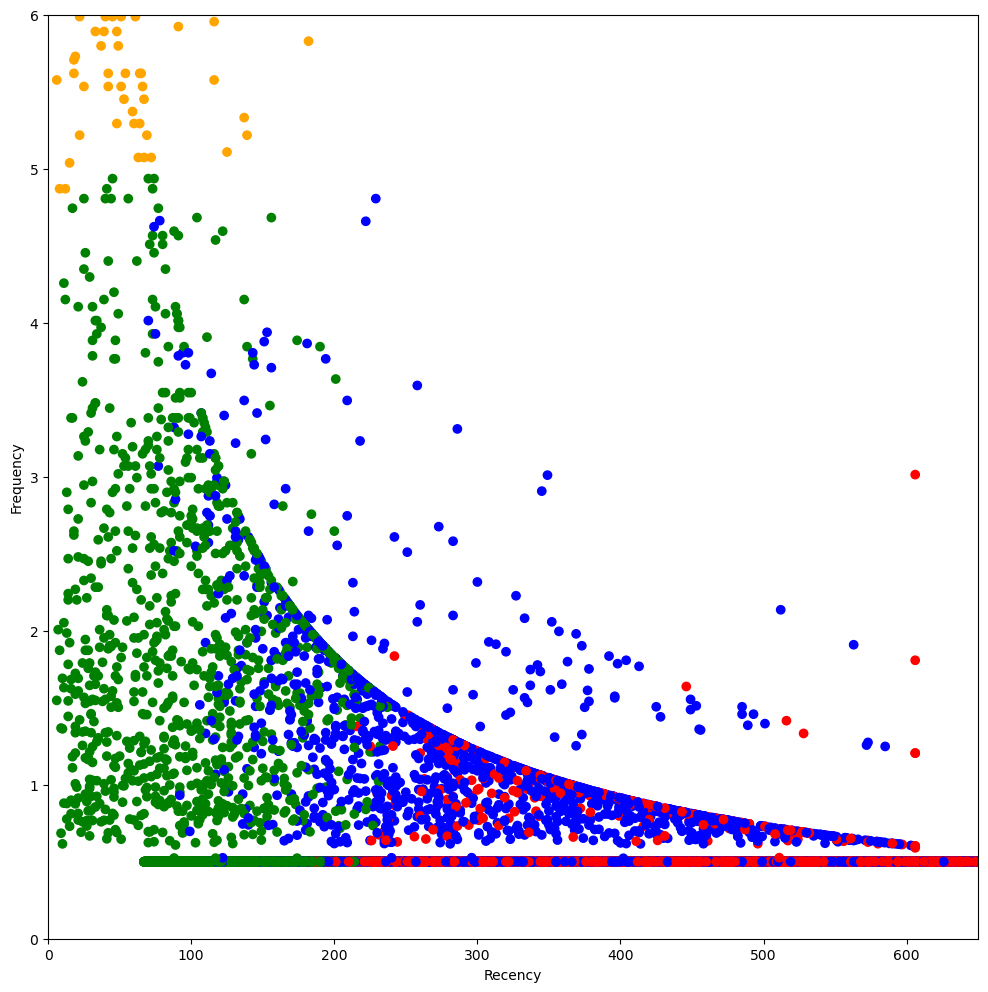

In [16]:
fig, graph = plt.subplots(1,1,figsize=(12,12))
plt.xlim(0,650)
plt.ylim(0,6)
graph.scatter(Full_DF['recency'], Full_DF['frequency'], c=Full_DF['color'])
graph.set_xlabel('Recency')
graph.set_ylabel('Frequency')
plt.show()

Cette fois **les ORANGES** sont les quelques clients qui commandent le plus souvent (fréquence >= 5) à l'exclusion de ceux qui ont commandé très récemment.
<br>**Les ROUGES** sont au contraire ceux qui ne commandent pas très souvent, et pour un montant total assez bas, moins de 150 reals. De plus, ils n'ont rien commandé depuis au moins 200 jours.
<br>**Les VERTS** ont tous commandé il y a moins de 250 jours, mais ne commandent pas très souvent.
<br>Enfin **les BLEUS** n'ont pas commandé depuis 75 jours au moins, mais totalisent un montant d'achat supérieur à 125 reals.
<br>C'est une segmentation interressante qui peut affiner celle à cinq classes (ou qui est affinée par celle à cinq classes)
<br>Entre temps j'ai découvert Yellowbrick et vais l'utiliser pour faciliter le choix :

C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of

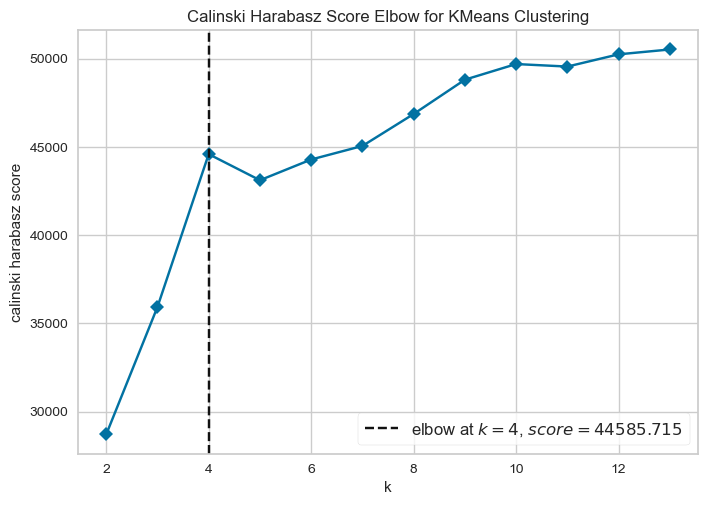

<Axes: title={'center': 'Calinski Harabasz Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='calinski harabasz score'>

In [10]:
KM_data = StandardScaler().fit_transform(Full_DF.take([6,7,8], axis=1))

visualizer = KElbowVisualizer(KMeans(), k=(2,14), metric='calinski_harabasz',\
                              timings=False)
visualizer.fit(KM_data)
visualizer.poof()

C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


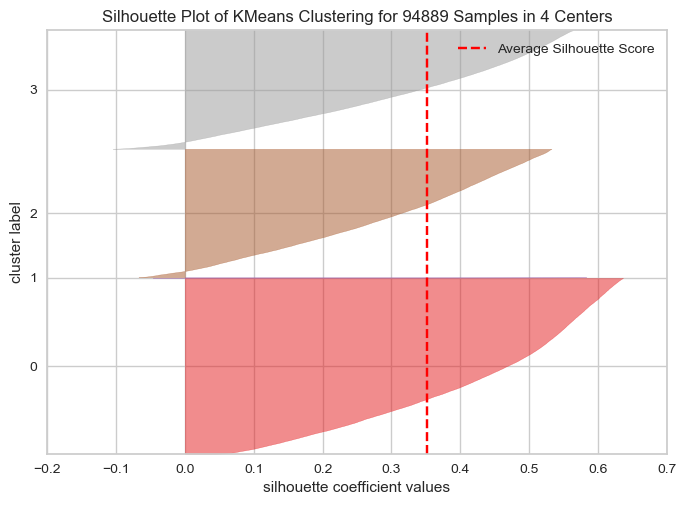

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 94889 Samples in 4 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [11]:
# We can see that the scores for k > 6 are higher than the one for 4.
# Let's have a look to the silhouette coef. :
visualizer = SilhouetteVisualizer(KMeans(4))
visualizer.fit(KM_data)
visualizer.poof()

C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


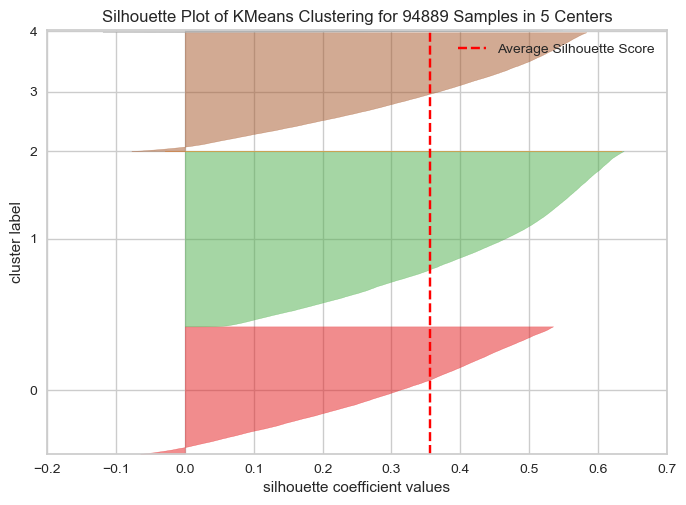

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 94889 Samples in 5 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [12]:
# the processing time is a lot longer with Full_DF than with MOC_DF !
visualizer = SilhouetteVisualizer(KMeans(5))
visualizer.fit(KM_data)
visualizer.poof()

C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


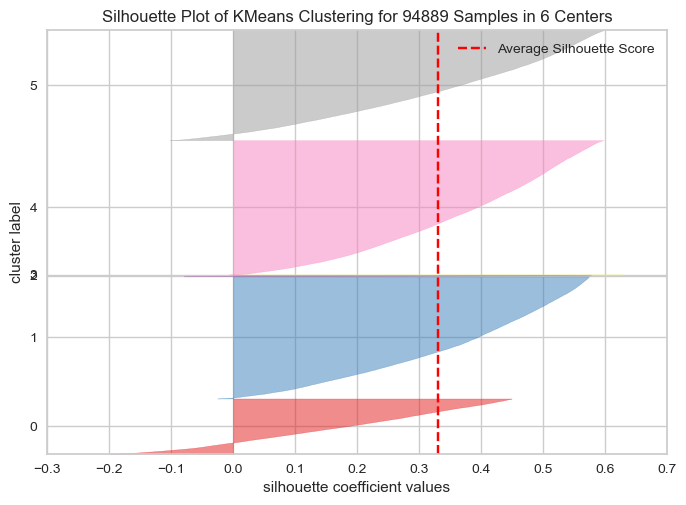

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 94889 Samples in 6 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [13]:
# from the silhouette coef. the value k = 5 is a little better than k = 4,
# and with 6 ?
visualizer = SilhouetteVisualizer(KMeans(6))
visualizer.fit(KM_data)
visualizer.poof()

C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


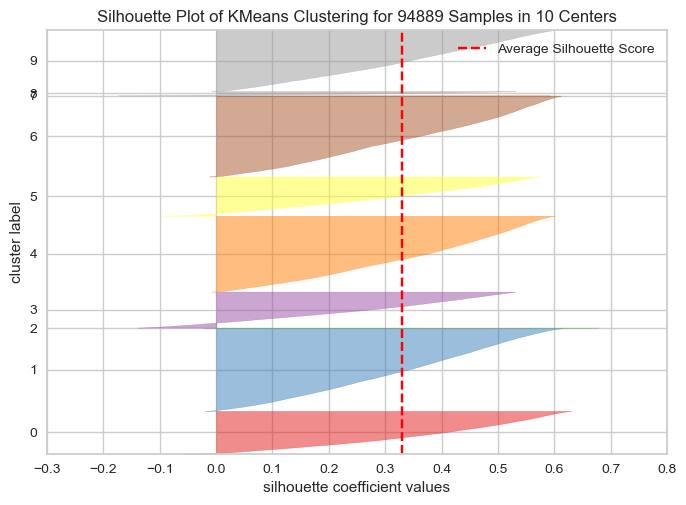

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 94889 Samples in 10 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [14]:
# with 6 it's not so good, and with 10 (higher C-H score) ?
visualizer = SilhouetteVisualizer(KMeans(10))
visualizer.fit(KM_data)
visualizer.poof()

Avant cette analyse avec Yellowbrick j'avais voulu voir ce que nous apporterait une segmentation k-means à six classes :

<Axes: xlabel='recency', ylabel='frequency'>

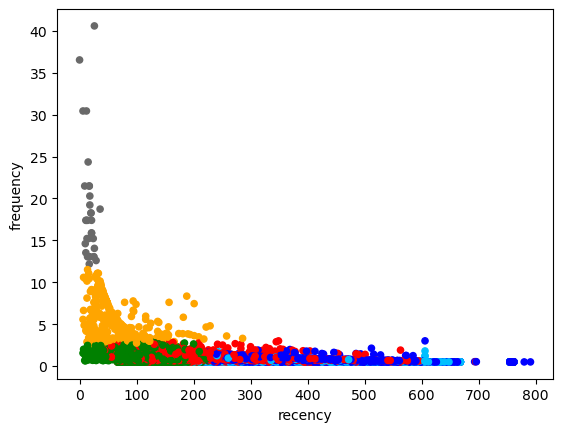

In [17]:
kmeans = KMeans(n_clusters=6, n_init=10)
kmeans.fit(KM_data)
Full_DF['kMeans_clust'] = kmeans.labels_
colors = ['red','blue','green','orange','deepskyblue','dimgrey']
Full_DF['color'] = Full_DF['kMeans_clust'].map(lambda p: colors[p])
Full_DF.plot(kind='scatter', x='recency', y='frequency', c=Full_DF['color'])

In [19]:
print('DARK BLUE : ' + str(Full_DF.loc[Full_DF['color'] == 'blue',\
                                   'customer_unique_id'].count()))
print('CLEAR BLUE: ' + str(Full_DF.loc[Full_DF['color'] == 'deepskyblue',\
                                   'customer_unique_id'].count()))
print('GREEN     : ' + str(Full_DF.loc[Full_DF['color'] == 'green',\
                                   'customer_unique_id'].count()))
print('RED       : ' + str(Full_DF.loc[Full_DF['color'] == 'red',\
                                   'customer_unique_id'].count()))
print('ORANGE    : ' + str(Full_DF.loc[Full_DF['color'] == 'orange',\
                                   'customer_unique_id'].count()))
print('GREY      : ' + str(Full_DF.loc[Full_DF['color'] == 'dimgrey',\
                                   'customer_unique_id'].count()))

DARK BLUE : 30294
CLEAR BLUE: 27073
GREEN     : 24656
RED       : 12462
ORANGE    : 372
GREY      : 32


<Axes: xlabel='frequency', ylabel='orders_total_amount'>

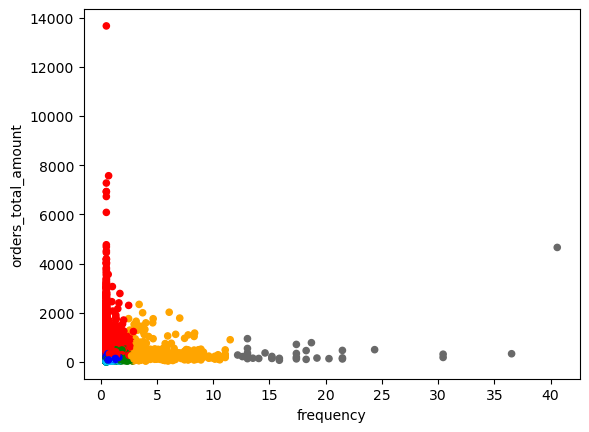

In [20]:
Full_DF.plot(kind='scatter', x='frequency', y='orders_total_amount',\
             c=Full_DF['color'])

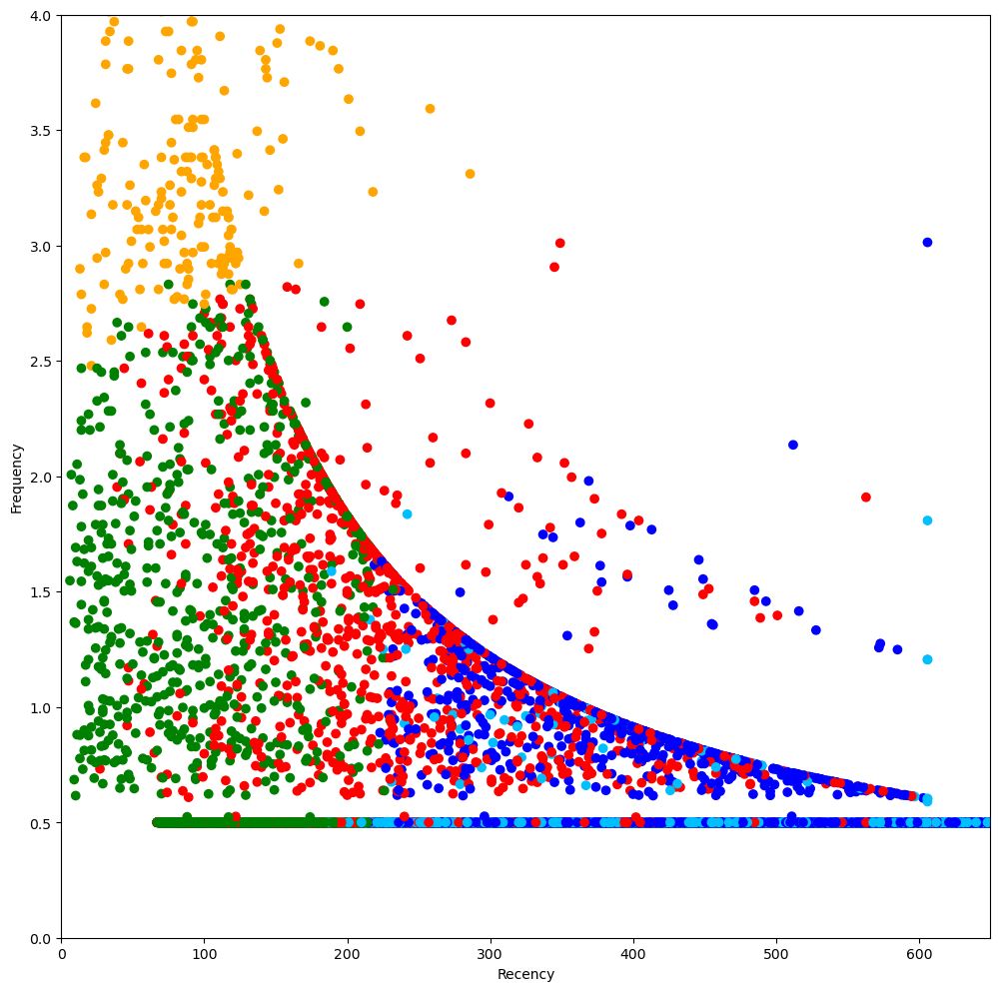

In [21]:
fig, graph = plt.subplots(1,1,figsize=(12,12))
plt.xlim(0,650)
plt.ylim(0,4)
graph.scatter(Full_DF['recency'], Full_DF['frequency'], c=Full_DF['color'])
graph.set_xlabel('Recency')
graph.set_ylabel('Frequency')
plt.show()

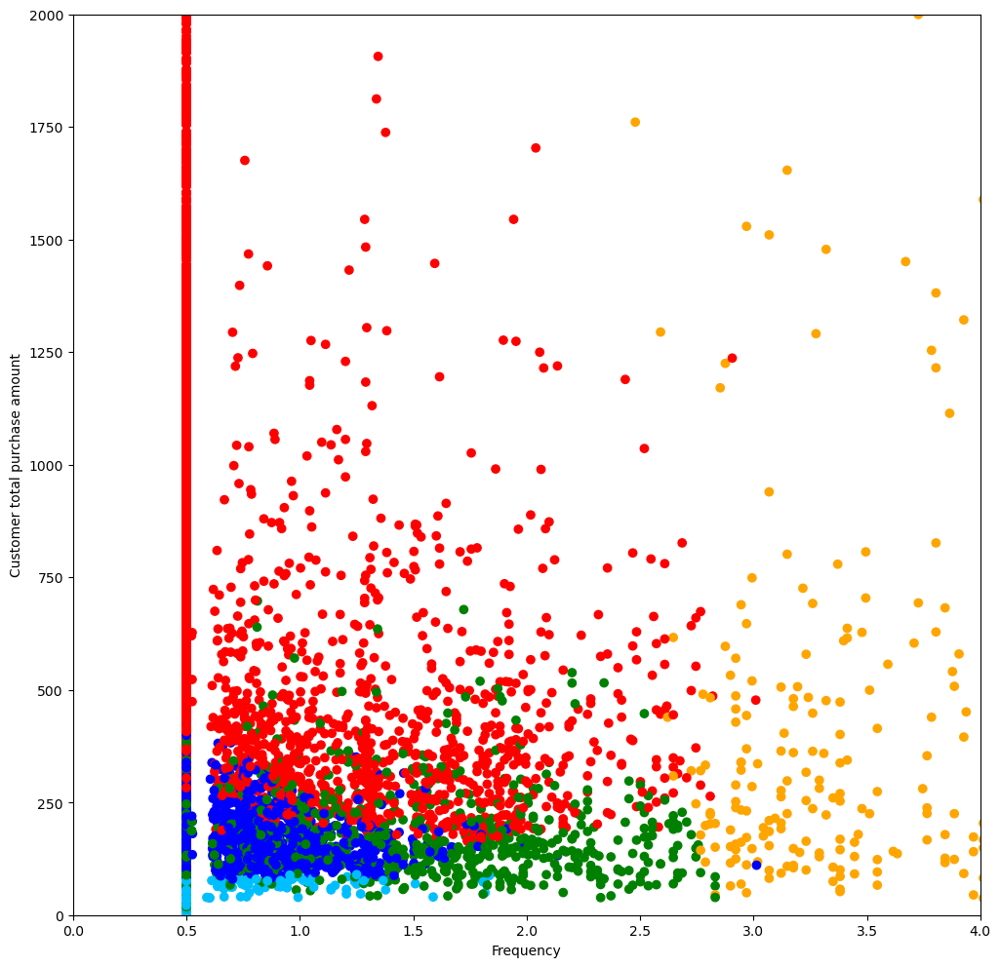

In [22]:
fig, graph = plt.subplots(1,1,figsize=(12,12))
plt.xlim(0,4)
plt.ylim(0,2000)
graph.scatter(Full_DF['frequency'], Full_DF['orders_total_amount'],\
              c=Full_DF['color'])
graph.set_xlabel('Frequency')
graph.set_ylabel('Customer total purchase amount')
plt.show()

<Axes: xlabel='order_count', ylabel='frequency'>

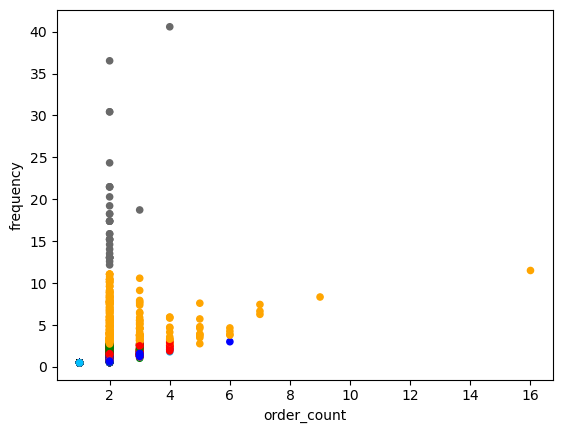

In [23]:
Full_DF.plot(kind='scatter', x='order_count', y='frequency', c=Full_DF['color'])

In [29]:
Full_DF.loc[Full_DF['order_count'] == 1, 'color'].unique()

array(['blue', 'red', 'green', 'deepskyblue'], dtype=object)

In [39]:
np.unique(Full_DF.loc[Full_DF['order_count'] == 1, 'color'], return_counts=True)

(array(['blue', 'deepskyblue', 'green', 'red'], dtype=object),
 array([29599, 26985, 24020, 11397], dtype=int64))

In [40]:
Full_DF.loc[Full_DF['color'] == 'orange', 'orders_total_amount'].max()

2340.08

In [41]:
Full_DF.loc[Full_DF['color'] == 'red', 'orders_total_amount'].min()

163.49

In [42]:
Full_DF.loc[Full_DF['color'] == 'deepskyblue', 'orders_total_amount'].max()

93.91

In [43]:
Full_DF.loc[Full_DF['color'] == 'blue', 'orders_total_amount'].max()

534.98

In [44]:
Full_DF.loc[Full_DF['color'] == 'blue', 'orders_total_amount'].min()

74.15

Cette segmentation est également interressante. On retrouve toujours une mini classe d'acheteurs "haute fréquence", ici de 32 clients comme pour la partition en cinq classes (cette fois **GRISE**).
<br>Puis une classe **ORANGE** de fréquence intermédiaire (entre 2.5 et 12 commandes par an), dont tous les clients ont effectué plusieurs achats.
<br>Une classe **ROUGE** se caractérisant par un montant minimum de 163 reals et n'ayant pas commandé depuis au moins un mois. 
<br>Une classe **VERTE** de fréquence inférieure à trois, mais ayant passé commande dans les sept derniers mois.
<br>Une classe **BLEUE CLAIRE** pour les clients ayant peu dépensé (moins de 94 reals), n'achetant pas souvent et rien depuis 200 jours au moins
<br>Enfin une classe **BLEUE FONCéE** de clients n'achetant pas souvent et rien depuis 220 jours au moins, et dont le montant total des dépenses est compris entre 74 et 535 reals
<br>On peut considérer que les deux classes bleues sont similaires à part le montant dépensé, de 0 à 94 pour l'une et 74 à 535 pour l'autre.
<br>Comparativement au '5-means' , on a deux classes identiques mais petites, de clients 'assidus' ou simplement réguliers, puis une division différente de la grosse partie des clients, par leurs montants d'achats, fréquence et récence. En fonction du niveau de précision souhaité par Olist, on pourrait proposer d'associer les deux ou trois 'k' les plus pertinents pour aboutir à une classification plus fine.
<br>Je suis maintenant curieux de voir ce que donne la partition à 10 classes, même s'il y en a trois toutes petites :

<Axes: xlabel='recency', ylabel='frequency'>

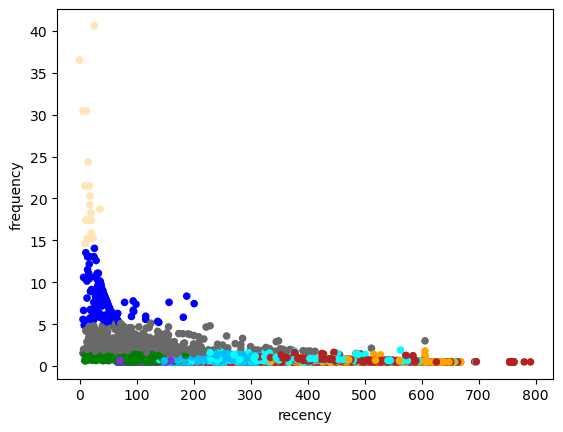

In [3]:
KM_data = StandardScaler().fit_transform(Full_DF.take([6,7,8], axis=1))
kmeans = KMeans(n_clusters=10, n_init=10)
kmeans.fit(KM_data)
Full_DF['kMeans_clust'] = kmeans.labels_
colors = ['firebrick','red','blue','aqua','green','orange','moccasin',\
          'deepskyblue','dimgrey','blueviolet']
Full_DF['color'] = Full_DF['kMeans_clust'].map(lambda p: colors[p])
Full_DF.plot(kind='scatter', x='recency', y='frequency', c=Full_DF['color'])

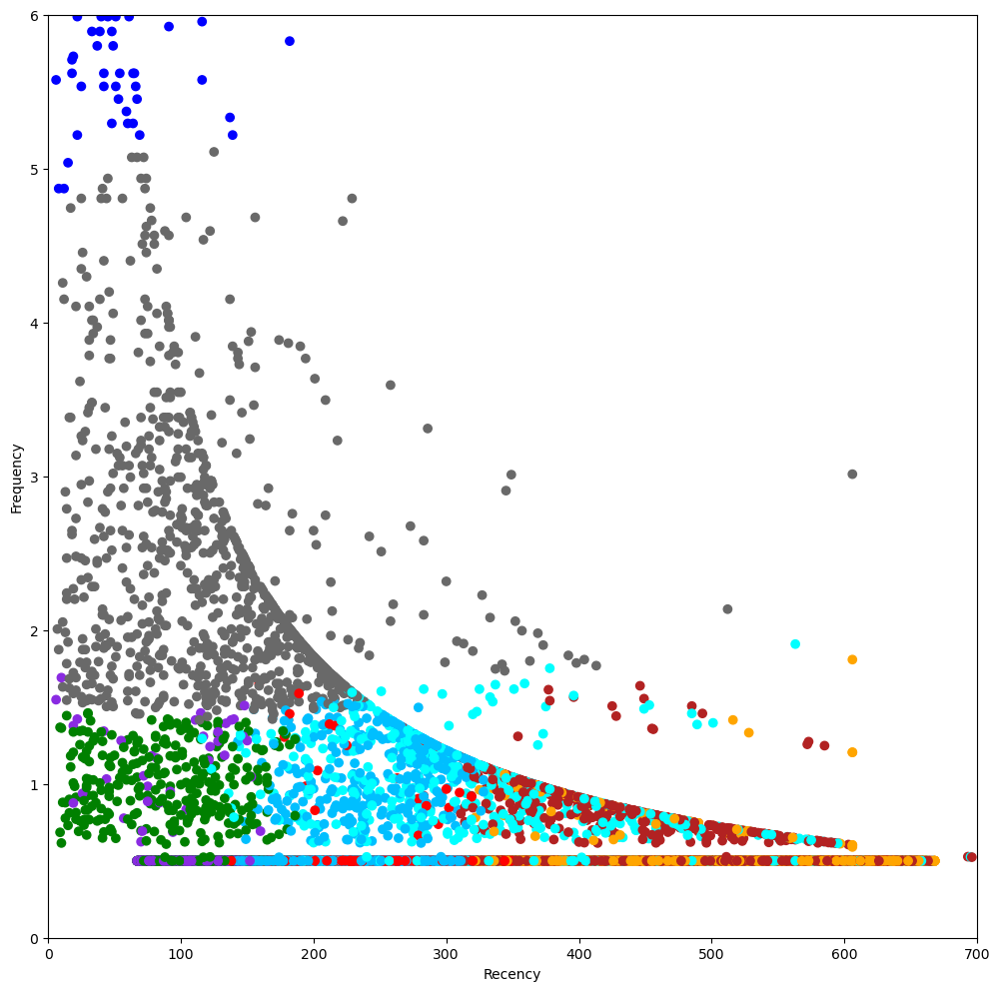

In [4]:
plt.figure(figsize=(12,12))
plt.xlim(0,700)
plt.ylim(0,6)
plt.scatter(Full_DF['recency'], Full_DF['frequency'], c=Full_DF['color'])
plt.xlabel('Recency')
plt.ylabel('Frequency')
plt.show()

This plot recomputed after a close / restart of Jupyter, and compared to former one, demonstrates the stability of the model.

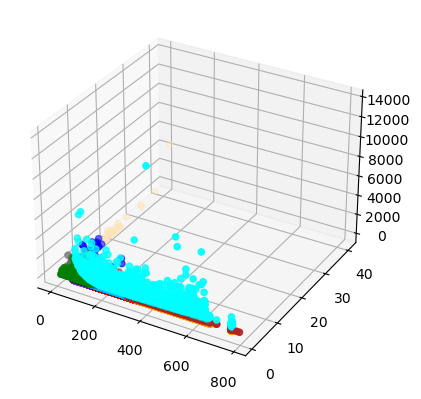

In [5]:
# %matplotlib <- provoque un affichage dans une fenêtre hors Jupyter !
# En plus le graphe n'y est pas visible.
from mpl_toolkits.mplot3d import Axes3D
ax = plt.axes(projection='3d')
ax.scatter(Full_DF['recency'], Full_DF['frequency'],\
           Full_DF['orders_total_amount'], c=Full_DF['color'])

<Axes: xlabel='frequency', ylabel='orders_total_amount'>

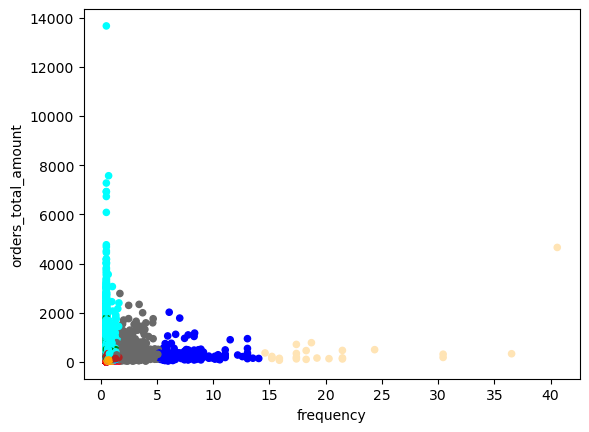

In [6]:
# I've tried above a 'new' 3D graph but I can't orientate it neither zoom in it !
Full_DF.plot(kind='scatter', x='frequency', y='orders_total_amount',\
             c=Full_DF['color'])

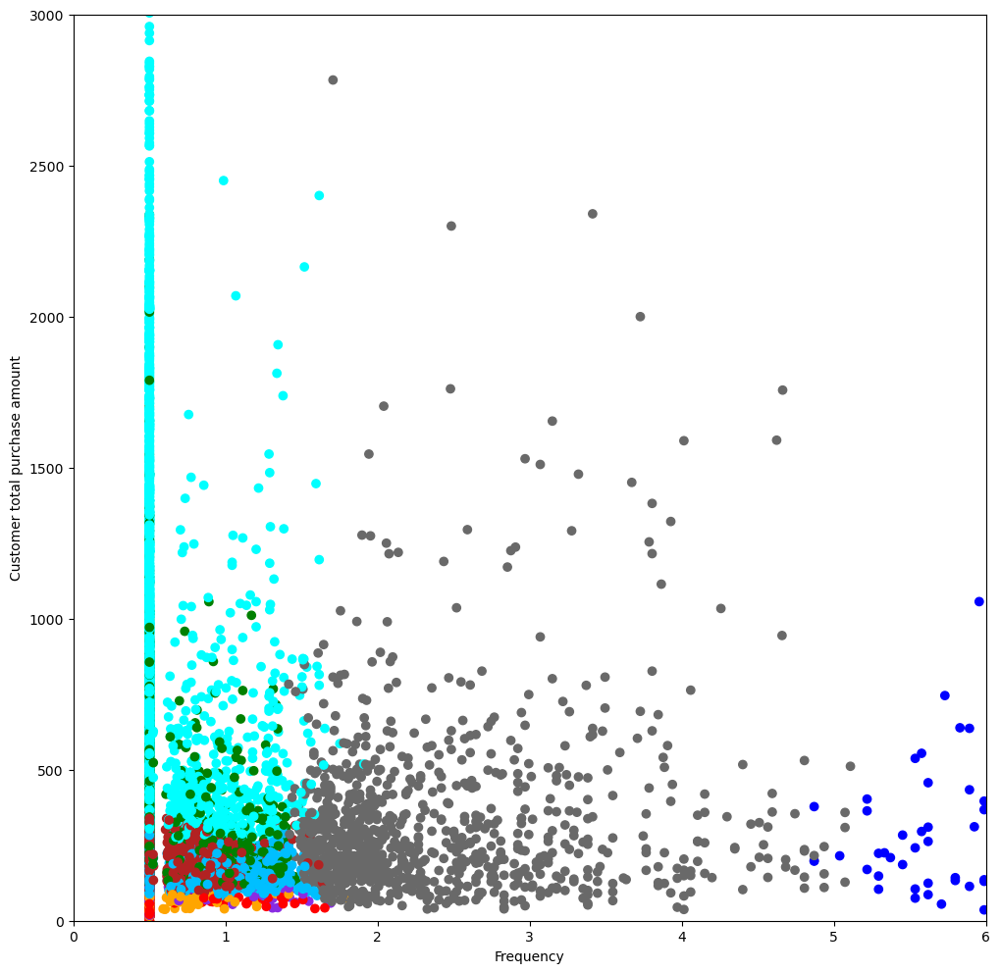

In [8]:
plt.figure(figsize=(12,12))
plt.xlim(0,6)
plt.ylim(0,3000)
plt.scatter(Full_DF['frequency'], Full_DF['orders_total_amount'],\
            c=Full_DF['color'])
plt.xlabel('Frequency')
plt.ylabel('Customer total purchase amount')
plt.show()

In [10]:
print('SKY BLUE : ' + str(Full_DF.loc[Full_DF['color'] == 'deepskyblue',\
                                   'customer_unique_id'].count()))
print('DARK RED : ' + str(Full_DF.loc[Full_DF['color'] == 'firebrick',\
                                   'customer_unique_id'].count()))
print('ORANGE   : ' + str(Full_DF.loc[Full_DF['color'] == 'orange',\
                                   'customer_unique_id'].count()))
print('RED      : ' + str(Full_DF.loc[Full_DF['color'] == 'red',\
                                   'customer_unique_id'].count()))
print('VIOLET   : ' + str(Full_DF.loc[Full_DF['color'] == 'blueviolet',\
                                   'customer_unique_id'].count()))
print('GREEN    : ' + str(Full_DF.loc[Full_DF['color'] == 'green',\
                                   'customer_unique_id'].count()))
print('AQUA BLUE: ' + str(Full_DF.loc[Full_DF['color'] == 'aqua',\
                                   'customer_unique_id'].count()))
print('GREY     : ' + str(Full_DF.loc[Full_DF['color'] == 'dimgrey',\
                                   'customer_unique_id'].count()))
print('DARK BLUE: ' + str(Full_DF.loc[Full_DF['color'] == 'blue',\
                                   'customer_unique_id'].count()))
print('FAWN     : ' + str(Full_DF.loc[Full_DF['color'] == 'moccasin',\
                                   'customer_unique_id'].count()))

SKY BLUE : 18402
DARK RED : 18344
ORANGE   : 17183
RED      : 13522
VIOLET   : 9441
GREEN    : 8737
AQUA BLUE: 8106
GREY     : 987
DARK BLUE: 144
FAWN     : 23


Les groupes ne sont pas assez distincts, ce partitionnement est effectivement nettement moins bon qu'avec les valeurs 'du coude'.
<br>Lors de tous ces essais avec l'algo. du k-means, nous avons toujours eu des minis groupes contenant les individus les plus excentrés pour une des caractéristiques. Ces individus sont facilement identifiables sans partitionnement, ils constituent plus une difficulté qu'une révélation pour la tâche de partitionnement, il serait donc interessant de les écarter avant. Nous allons donc reprendre la classification sur un jeu de données un peu plus restreint mais plus homogène, en espérant obtenir de meilleurs résultats.

In [2]:
Restricted_DF = Full_DF.loc[(Full_DF['frequency'] < 12) & \
                            (Full_DF['recency'] < 680) & \
                            (Full_DF['orders_total_amount'] < 5000), :]
Restricted_DF.shape    # Full_DF.shape : (94889, 9)

(94567, 9)

C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of

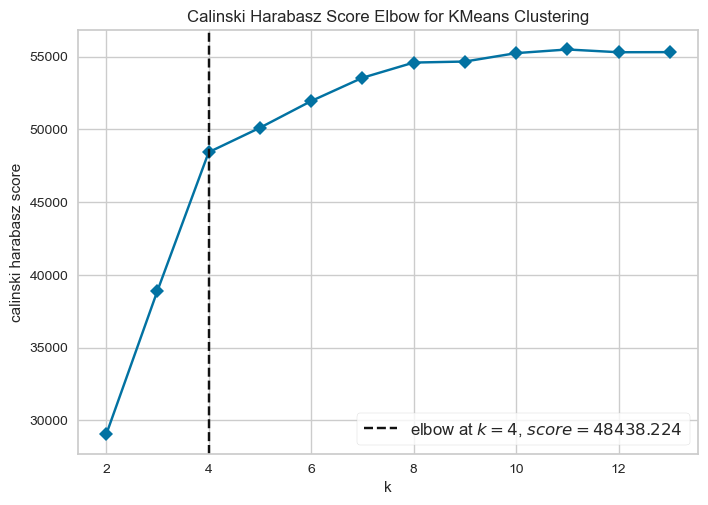

<Axes: title={'center': 'Calinski Harabasz Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='calinski harabasz score'>

In [8]:
KM_data = StandardScaler().fit_transform(Restricted_DF.take([6,7,8], axis=1))
visualizer = KElbowVisualizer(KMeans(), k=(2,14), metric='calinski_harabasz',\
                              timings=False)
visualizer.fit(KM_data)
visualizer.poof()

Nous avons de nouveau k=4 comme valeur optimale, mais ça ne signifie pas que k=5 n'est pas interessant, voyons avec les diagrammes 'silhouette' :

C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


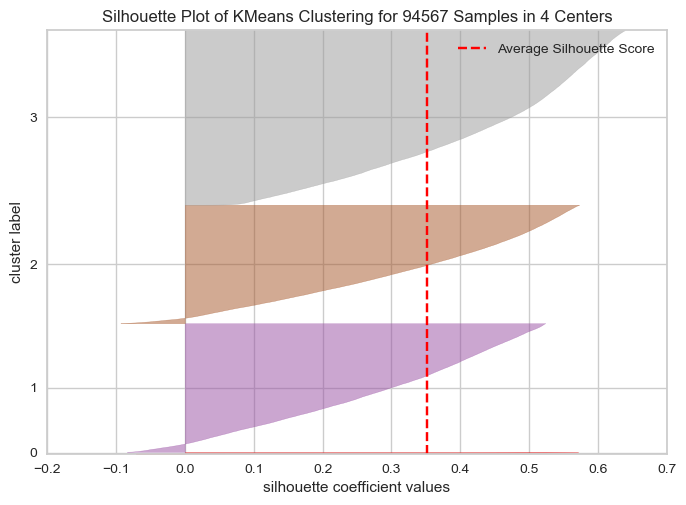

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 94567 Samples in 4 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [9]:
visualizer = SilhouetteVisualizer(KMeans(4))
visualizer.fit(KM_data)
visualizer.poof()

C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


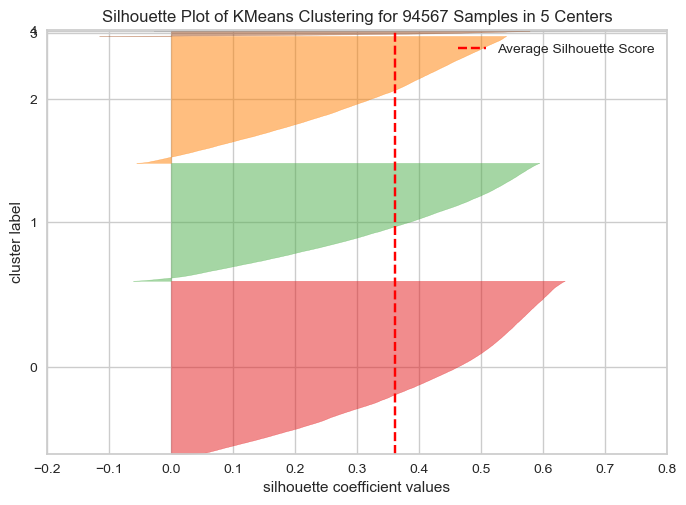

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 94567 Samples in 5 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [10]:
visualizer = SilhouetteVisualizer(KMeans(5))
visualizer.fit(KM_data)
visualizer.poof()

C:\Users\jlper\AppData\Local\Temp\ipykernel_17708\378409604.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Restricted_DF['kMeans_clust'] = kmeans.labels_
C:\Users\jlper\AppData\Local\Temp\ipykernel_17708\378409604.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Restricted_DF['color'] = Restricted_DF['kMeans_clust'].map(lambda p: colors[p])


<Axes: xlabel='recency', ylabel='frequency'>

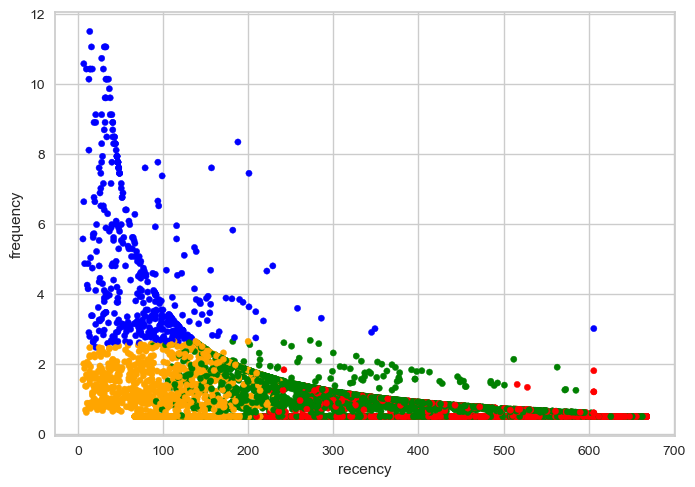

In [12]:
# Two tiny clusters, but the average silhouette score is a bit higher
kmeans = KMeans(n_clusters=4, n_init=10)
kmeans.fit(KM_data)
Restricted_DF['kMeans_clust'] = kmeans.labels_
colors = ['red','blue','green','orange']
Restricted_DF['color'] = Restricted_DF['kMeans_clust'].map(lambda p: colors[p])
Restricted_DF.plot(kind='scatter', x='recency', y='frequency',\
                   c=Restricted_DF['color'])

<Axes: xlabel='frequency', ylabel='orders_total_amount'>

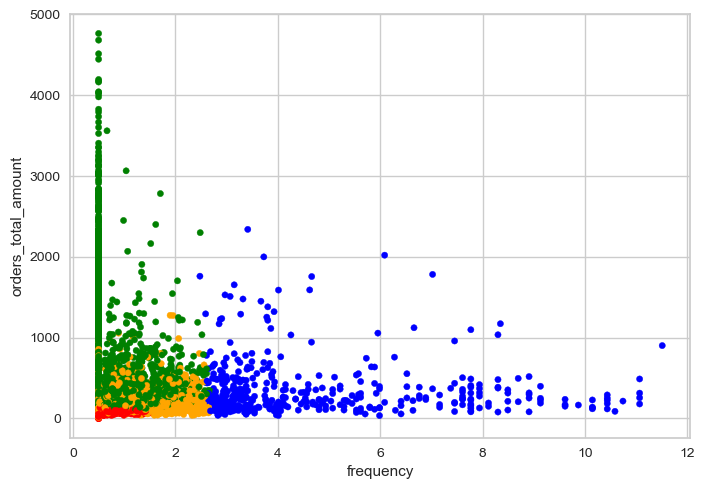

In [13]:
Restricted_DF.plot(kind='scatter', x='frequency', y='orders_total_amount',\
                   c=Restricted_DF['color'])

In [15]:
print('RED    : ' + str(Restricted_DF.loc[Restricted_DF['color'] == 'red',\
                                   'customer_unique_id'].count()))
print('GREEN  : ' + str(Restricted_DF.loc[Restricted_DF['color'] == 'green',\
                                   'customer_unique_id'].count()))
print('ORANGE : ' + str(Restricted_DF.loc[Restricted_DF['color'] == 'orange',\
                                   'customer_unique_id'].count()))
print('BLUE   : ' + str(Restricted_DF.loc[Restricted_DF['color'] == 'blue',\
                                   'customer_unique_id'].count()))

RED    : 38976
GREEN  : 28700
ORANGE : 26479
BLUE   : 412


Nous avons toujours un groupe plus petit d'acheteurs frequents qui, pour la plupart, ont passé commande il y a peu.
<br>En ROUGE on a les acheteurs les moins interessants (mais les plus nombreux) : petits montants, petites frequences et pas de commande depuis plus de six mois et demi.
<br>En ORANGE on trouve ceux qui ont commandé récemment, mais qui ne commandent pas souvent, et enfin
<br>En VERT les autres : ils n'ont pas acheté très récemment, mais ont dépensé plus que les rouges. Voyons quel est le seuil de dépense qui sépare les deux classes :

In [16]:
Restricted_DF.loc[Restricted_DF['color'] == 'red', 'orders_total_amount'].max()

147.55

In [17]:
Restricted_DF.loc[Restricted_DF['color'] == 'green', 'orders_total_amount']\
.min()

112.01

Il n'y a pas de seuil, mais une zone de transition autour de 130 reals. On peut regarder ce que donne la partition à cinq classes, pour pouvoir proposer un choix au client, voir une combinaison des deux classifications, qui l'interessera peut-être !

C:\Users\jlper\AppData\Local\Temp\ipykernel_17708\2136243426.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Restricted_DF['kMeans_clust'] = kmeans.labels_
C:\Users\jlper\AppData\Local\Temp\ipykernel_17708\2136243426.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Restricted_DF['color'] = Restricted_DF['kMeans_clust'].map(lambda p: colors[p])


<Axes: xlabel='recency', ylabel='frequency'>

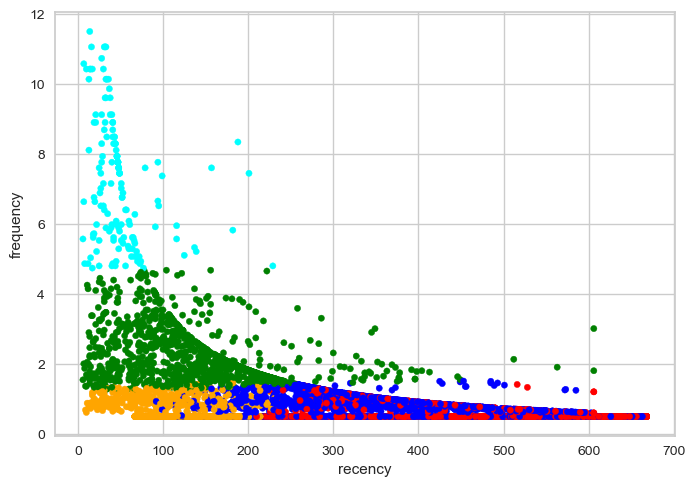

In [18]:
kmeans = KMeans(n_clusters=5, n_init=10)
kmeans.fit(KM_data)
Restricted_DF['kMeans_clust'] = kmeans.labels_
colors = ['red','blue','green','orange','aqua']
Restricted_DF['color'] = Restricted_DF['kMeans_clust'].map(lambda p: colors[p])
Restricted_DF.plot(kind='scatter', x='recency', y='frequency',\
                   c=Restricted_DF['color'])

<Axes: xlabel='frequency', ylabel='orders_total_amount'>

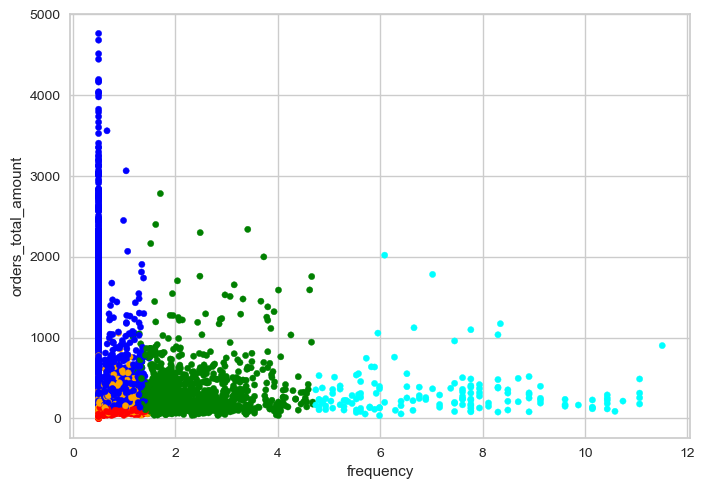

In [19]:
Restricted_DF.plot(kind='scatter', x='frequency', y='orders_total_amount',\
                   c=Restricted_DF['color'])

In [21]:
print('RED        : ' + str(Restricted_DF.loc[Restricted_DF['color'] == 'red',\
                                   'customer_unique_id'].count()))
print('DARK BLUE  : ' + str(Restricted_DF.loc[Restricted_DF['color'] == 'blue',\
                                   'customer_unique_id'].count()))
print('ORANGE     : ' + str(Restricted_DF.loc[Restricted_DF['color'] == 'orange',\
                                   'customer_unique_id'].count()))
print('GREEN      : ' + str(Restricted_DF.loc[Restricted_DF['color'] == 'green',\
                                   'customer_unique_id'].count()))
print('CLEAR BLUE : ' + str(Restricted_DF.loc[Restricted_DF['color'] == 'aqua',\
                                   'customer_unique_id'].count()))

RED        : 38641
DARK BLUE  : 28337
ORANGE     : 26335
GREEN      : 1103
CLEAR BLUE : 151


Toujours le petit groupe d'acheteurs frequents, ici en bleu clair.
<br>En ROUGE, on a presque le même groupe qu'avec k=4
<br>De nouveau en ORANGE ceux qui ont commandé récemment, mais qui ne commandent pas souvent, avec une fréquence plus basse pour faire la place à un groupe supplémentaire :
<br>En VERT, Intermédiaire entre les rouges-oranges + bleus foncés et les bleus clairs, donc caractérisés par une bande de fréquence moyenne
<br>Enfin en BLEU FONCé ceux qui n'ont pas acheté très récemment, mais ont dépensé plus que les rouges.
<br>Essentiellement la différence avec le partitionnement à quatre classes est l'existence de deux frontières globales de fréquences, alors qu'avec quatres classes il n'y a que pour les rouges qu'on a une deuxième frontière de fréquence.
<br>Connaissant précisement les individus mis de côté dans 'Restricted_DF', il faudrait spécifier les deux classifications à Olist pour connaître celle qui l'intéresse le plus; Ou bien une de celles sans la restriction des 'extrèmes', ou bien deux classifications cumulées ? Voyons par exemple ce que donne le cumul de k=4 et k=5 sur le jeu restreint :

In [25]:
kmeans = KMeans(n_clusters=4, n_init=10)
kmeans.fit(KM_data)
Restricted_DF['kMeans_clust1'] = kmeans.labels_
colors = ['red','blue','green','orange']
Restricted_DF['color1'] = Restricted_DF['kMeans_clust1'].map(lambda p: colors[p])

C:\Users\jlper\AppData\Local\Temp\ipykernel_17708\2785333327.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Restricted_DF['kMeans_clust1'] = kmeans.labels_
C:\Users\jlper\AppData\Local\Temp\ipykernel_17708\2785333327.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Restricted_DF['color1'] = Restricted_DF['kMeans_clust1'].map(lambda p: colors[p])


<Axes: xlabel='frequency', ylabel='orders_total_amount'>

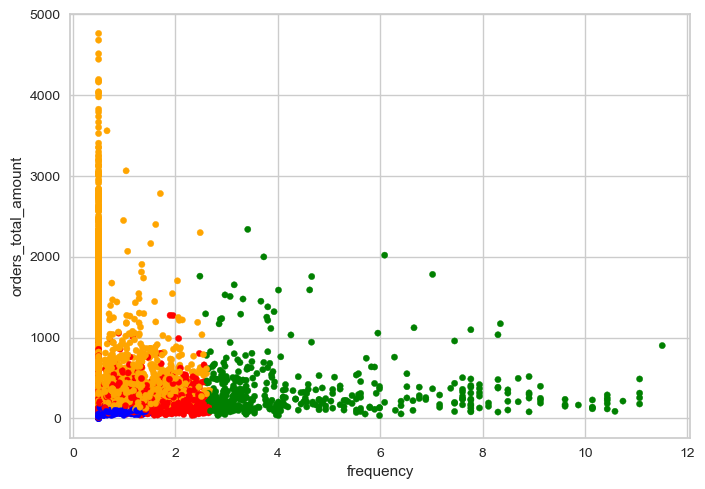

In [27]:
Restricted_DF.plot(kind='scatter', x='frequency', y='orders_total_amount',\
                   c=Restricted_DF['color1'])

<Axes: xlabel='frequency', ylabel='orders_total_amount'>

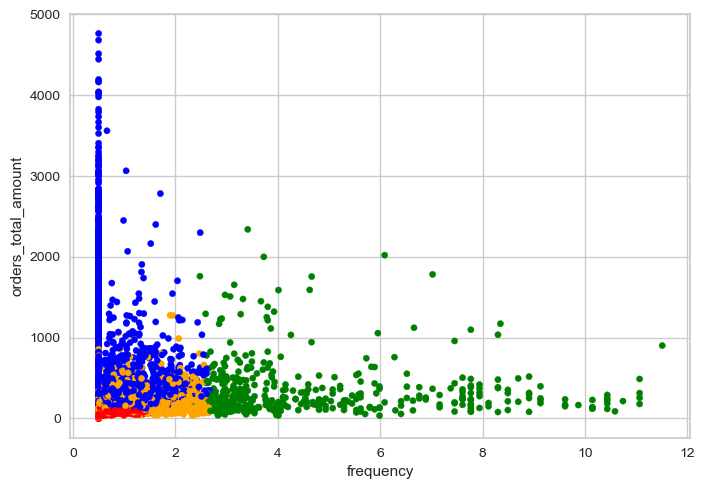

In [28]:
# We modify the colors for this second color column, in order to be
# aligned with the first one :
Restricted_DF.loc[Restricted_DF['color1'] == 'blue', 'color1'] = 'grey'
Restricted_DF.loc[Restricted_DF['color1'] == 'orange', 'color1'] = 'blue'
Restricted_DF.loc[Restricted_DF['color1'] == 'red', 'color1'] = 'orange'
Restricted_DF.loc[Restricted_DF['color1'] == 'grey', 'color1'] = 'red'
Restricted_DF.plot(kind='scatter', x='frequency', y='orders_total_amount',\
                   c=Restricted_DF['color1'])

In [30]:
Restricted_DF.loc[~(Restricted_DF['color1'] == Restricted_DF['color']),\
                  ['color','color1']].value_counts()

color   color1
green   orange    436
orange  red       419
green   blue      403
aqua    green     151
red     blue      114
blue    orange    113
orange  blue       19
blue    red        15
green   red         3
Name: count, dtype: int64

C:\Users\jlper\AppData\Local\Temp\ipykernel_17708\988220944.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Restricted_DF['color2'] = Restricted_DF.apply(lambda row: fillColor2(row), axis=1)


<Axes: xlabel='frequency', ylabel='orders_total_amount'>

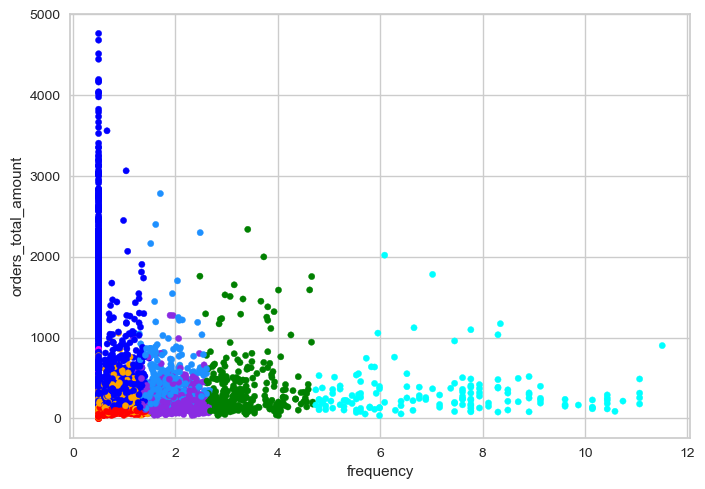

In [31]:
# we add a new color column, this way :
def fillColor2(row):
    if row['color'] == row['color1']:
        return row['color']
    elif (row['color'] == 'green') & (row['color1'] == 'orange') :
        return 'blueviolet'
    elif (row['color'] == 'orange') & (row['color1'] == 'red') :
        return 'sienna'
    elif (row['color'] == 'green') & (row['color1'] == 'blue') :
        return 'dodgerblue'    
    elif (row['color'] == 'aqua') & (row['color1'] == 'green') :
        return 'aqua'    
    elif (row['color'] == 'red') & (row['color1'] == 'blue') :
        return 'gold'    
    elif (row['color'] == 'blue') & (row['color1'] == 'orange') :
        return 'fuchsia'    
    else :
        return row['color']    

Restricted_DF['color2'] = Restricted_DF.apply(lambda row: fillColor2(row), axis=1)
Restricted_DF.plot(kind='scatter', x='frequency', y='orders_total_amount',\
                   c=Restricted_DF['color2'])

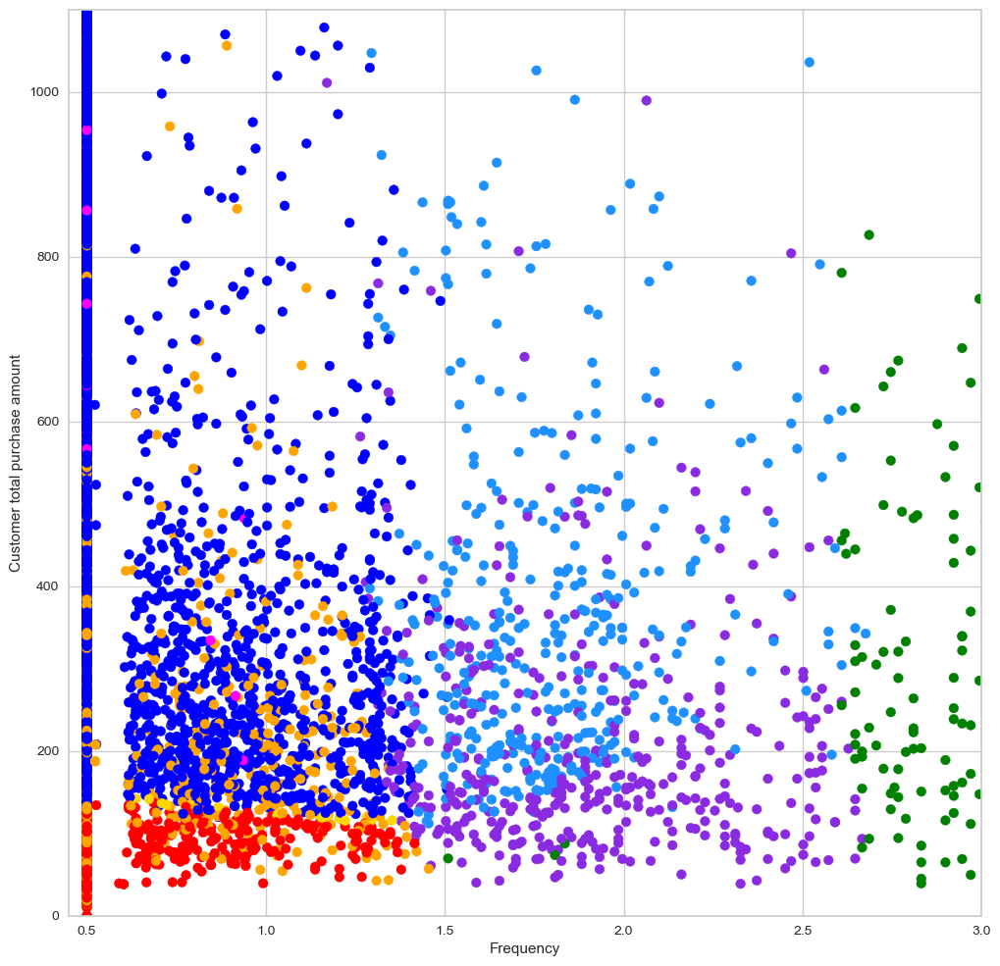

In [33]:
plt.figure(figsize=(12,12))
plt.xlim(0.45,3)
plt.ylim(0,1100)
plt.scatter(Restricted_DF['frequency'], Restricted_DF['orders_total_amount'],\
            c=Restricted_DF['color2'])
plt.xlabel('Frequency')
plt.ylabel('Customer total purchase amount')
plt.show()

<Axes: xlabel='recency', ylabel='frequency'>

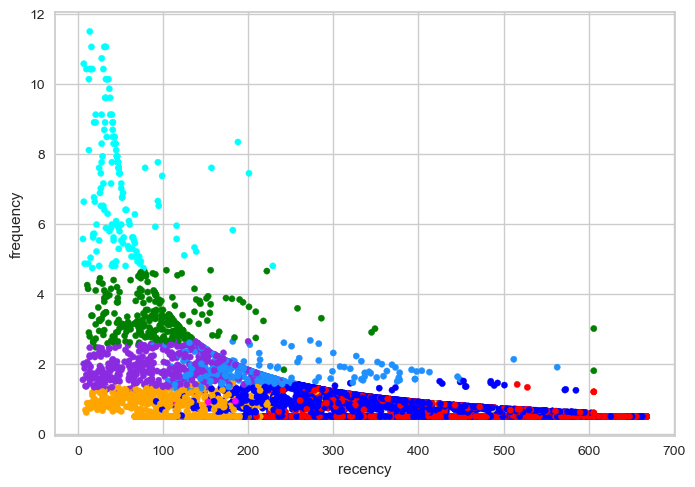

In [34]:
Restricted_DF.plot(kind='scatter', x='recency', y='frequency',\
                   c=Restricted_DF['color2'])

On obtient une segmentation plus détaillée qui pourrait interresser Olist, surtout que nous n'avons ici qu'un nombre réduit de commandes; Avec la totalité, les petits groupes seraient bien plus gros et leurs spécificités pourraient permettre un ciblage pertinent.
<br>J'ai vérifié à plusieurs reprises la stabilité dans le temps des classifications opérées par le k-means, en constatant qu'elles restaient identiques à chaque lancement (par défaut avec scikit-learn, il est déjà exécuté 10 fois de suite avec différents centroïdes, et le résultat retourné est celui de moindre inertie).
<br>Il y a un autre moyen de vérifier cette stabilité : c'est d'étudier les classifications produites avec l'autre méthode d'initialisation ('random' au lieu de 'greedy k-means++' par défaut); Si elles sont semblables à celles obtenues avec 'greedy k-means++', c'est qu'elles ne dépendent guère du choix initial des centroïdes, et donc qu'elles sont stables.
<br>Voyons cela avec notre jeu restreint, pour k = 4 et 5 :

In [3]:
KM_data = StandardScaler().fit_transform(Restricted_DF.take([6,7,8], axis=1))
kmeans = KMeans(n_clusters=4, init='random', n_init=10)
kmeans.fit(KM_data)
np.unique(kmeans.labels_, return_counts=True)

(array([0, 1, 2, 3]), array([28700, 26479,   412, 38976], dtype=int64))

In [4]:
# now with k = 5 :
kmeans = KMeans(n_clusters=5, init='random', n_init=10)
kmeans.fit(KM_data)
np.unique(kmeans.labels_, return_counts=True)

(array([0, 1, 2, 3, 4]),
 array([24537, 11900, 30092, 27656,   382], dtype=int64))

In [5]:
# with k = 4 again :
kmeans = KMeans(n_clusters=4, init='random', n_init=10)
kmeans.fit(KM_data)
np.unique(kmeans.labels_, return_counts=True)

(array([0, 1, 2, 3]), array([26476, 38978, 28701,   412], dtype=int64))

In [6]:
# with k = 5 again :
kmeans = KMeans(n_clusters=5, init='random', n_init=10)
kmeans.fit(KM_data)
np.unique(kmeans.labels_, return_counts=True)

(array([0, 1, 2, 3, 4]),
 array([27514, 30185, 11983, 24503,   382], dtype=int64))

Récapitulons:
<br>Tailles des classes pour k = 4
<br>Avec initialisation 'greedy k-means++' (toujours mêmes classes) : 38976, 28700, 26479, 412
<br>Avec initialisation 'random', premier essai : 38976, 28700, 26479, 412, deuxième essai : 38978, 28701, 26476, 412
<br>On observe donc **une stabilité quasi parfaite**
<br>Tailles des classes pour k = 5
<br>Avec initialisation 'greedy k-means++' : 38641, 28337, 26335, 1103, 151
<br>Avec initialisation 'random', 1-er essai : 30092, 27656, 24537, 11900, 382, 2-ème essai : 30185, 27514, 24503, 11983, 382
<br>On observe une bonne similitude entre les résultats 'random', mais ils sont différents de ceux obtenus avec la méthode préconisée par scikit-learn, qui sont aussi très stables, en voici la preuve :

In [7]:
kmeans = KMeans(n_clusters=5, n_init=10)
kmeans.fit(KM_data)
np.unique(kmeans.labels_, return_counts=True)

(array([0, 1, 2, 3, 4]),
 array([28603, 26343,   151, 38367,  1103], dtype=int64))

On peut en déduire que pour la valeur optimale de k on a une parfaite stabilité des classes indépendemment de la méthode d'initialisation, mais pour la valeur suivante (valeur optimale + 1) on a deux résultats différents selon la méthode d'initialisation, toutefois tous deux très stables; Encore une preuve pour la méthode 'random' :

In [8]:
# with k = 5 again :
kmeans = KMeans(n_clusters=5, init='random', n_init=10)
kmeans.fit(KM_data)
np.unique(kmeans.labels_, return_counts=True)

(array([0, 1, 2, 3, 4]),
 array([24516, 27747, 11841, 30087,   376], dtype=int64))

Text(0.5, 1.0, 'For k = 5, init. with random, third try')

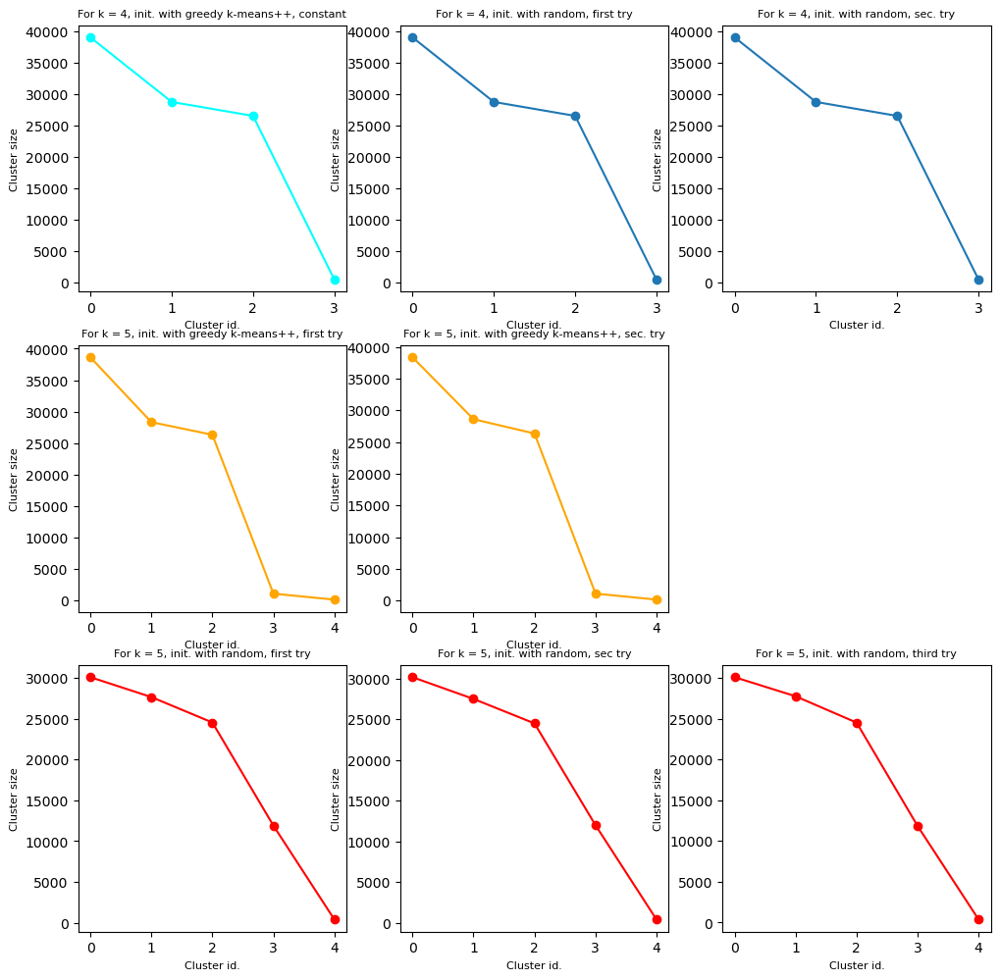

In [18]:
# visually :
plt.figure(figsize=(12,12))
plt.subplot(3,3,1)
plt.plot(range(0,4), [38976, 28700, 26479, 412], marker = 'o', c='cyan')
plt.xlabel('Cluster id.', size=8)
plt.ylabel('Cluster size', size=8)
plt.title('For k = 4, init. with greedy k-means++, constant', size=8)
plt.subplot(3,3,2)
plt.plot(range(0,4), [38976, 28700, 26479, 412], marker = 'o')
plt.xlabel('Cluster id.', size=8)
plt.ylabel('Cluster size', size=8)
plt.title('For k = 4, init. with random, first try', size=8)
plt.subplot(3,3,3)
plt.plot(range(0,4), [38978, 28701, 26476, 412], marker = 'o')
plt.xlabel('Cluster id.', size=8)
plt.ylabel('Cluster size', size=8)
plt.title('For k = 4, init. with random, sec. try', size=8)
plt.subplot(3,3,4)
plt.plot(range(0,5), [38641, 28337, 26335, 1103, 151], marker = 'o', c='orange')
plt.xlabel('Cluster id.', size=8)
plt.ylabel('Cluster size', size=8)
plt.title('For k = 5, init. with greedy k-means++, first try', size=8)
plt.subplot(3,3,5)
plt.plot(range(0,5), [38367, 28603, 26343, 1103, 151], marker = 'o', c='orange')
plt.xlabel('Cluster id.', size=8)
plt.ylabel('Cluster size', size=8)
plt.title('For k = 5, init. with greedy k-means++, sec. try', size=8)
plt.subplot(3,3,7)
plt.plot(range(0,5), [30092, 27656, 24537, 11900, 382], marker = 'o', c='red')
plt.xlabel('Cluster id.', size=8)
plt.ylabel('Cluster size', size=8)
plt.title('For k = 5, init. with random, first try', size=8)
plt.subplot(3,3,8)
plt.plot(range(0,5), [30185, 27514, 24503, 11983, 382], marker = 'o', c='red')
plt.xlabel('Cluster id.', size=8)
plt.ylabel('Cluster size', size=8)
plt.title('For k = 5, init. with random, sec try', size=8)
plt.subplot(3,3,9)
plt.plot(range(0,5), [30087, 27747, 24516, 11841, 376], marker = 'o', c='red')
plt.xlabel('Cluster id.', size=8)
plt.ylabel('Cluster size', size=8)
plt.title('For k = 5, init. with random, third try', size=8)

<a name='E4'>

Etudions à présent, de nouveau sur l'ensemble des clients, le partitionnement 'RFM' engendré par un autre algo. de classification : **le DBSCAN (Density-Based Spatial Clustering of Applications with Noise)**

In [2]:
# We try to have an idea of the right distance to neighbors to choose for
# DBSCAN clustering with two neighbors :
X = Full_DF.take([4,5,6], axis=1)
NNgbs = NearestNeighbors(n_neighbors=2)
ngbrs = NNgbs.fit(X)
distances, indices = ngbrs.kneighbors(X)
# the second column of 'distances' is the distance between
# the two elements given in 'indices'
distances

array([[0.        , 1.03580886],
       [0.        , 0.01      ],
       [0.        , 1.0384604 ],
       ...,
       [0.        , 1.04383507],
       [0.        , 0.83851487],
       [0.        , 1.04838781]])

In [3]:
indices # for each element of X, gives the indice of the nearest element

array([[    0, 89525],
       [    1, 13219],
       [    2,   767],
       ...,
       [94886, 19531],
       [94887, 50785],
       [94888, 42119]], dtype=int64)

In [4]:
Full_DF.shape[0]

94889

In [6]:
distances[:,0].max()

0.0

In [16]:
indices[767]

array([  767, 84179], dtype=int64)

In [7]:
X.iloc[0,:]

orders_total_amount    146.87
recency                537.00
frequency                0.50
Name: 0, dtype: float64

In [8]:
print(ngbrs.kneighbors([[147.0, 537.0, 1.0]]))

(array([[0.51662365, 1.12676528]]), array([[    0, 89525]], dtype=int64))


C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but NearestNeighbors was fitted with feature names
  warnings.warn(


Ci-dessus, signifie que les individus 0 et 89525 de X sont les plus proches de mon point (147.0, 537.0, 1.0), avec une distance respective de 0.5166... et 1.1267...

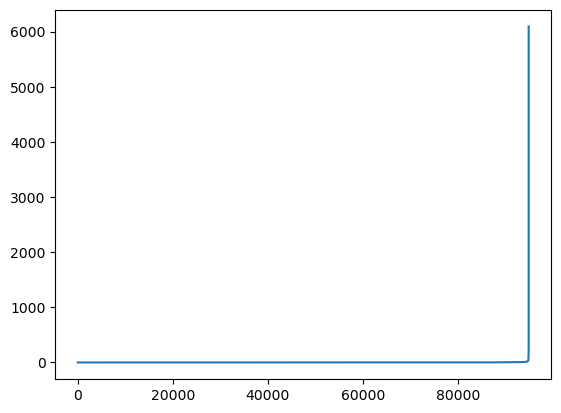

In [9]:
distances = distances[:,1]
distances = np.sort(distances)
plt.plot(distances)

In [10]:
# the longer distances are 'destroying' the graph !
distances[94880:]

array([ 183.09638944,  226.42443   ,  226.42443   ,  352.81174711,
        352.81174711,  437.8540323 ,  504.50431462,  670.8470872 ,
       6093.61206867])

In [11]:
distances[94840:94880]

array([ 51.36394066,  51.39477016,  51.39477016,  51.46248209,
        52.85660697,  53.00086886,  54.40981162,  57.41870862,
        57.77231171,  57.80557153,  58.08115787,  59.13469455,
        59.13469455,  59.34826366,  59.67119992,  60.21544735,
        62.03224968,  63.92436234,  63.92436234,  68.10443745,
        68.10443745,  71.06899816,  73.06201105,  75.70944723,
        79.97267096,  82.6892109 ,  82.6892109 ,  85.94424297,
        93.24994584,  93.24994584, 100.86427762, 100.86427762,
       113.10632166, 118.98942647, 118.98942647, 122.56452382,
       122.56452382, 134.37240193, 148.80053797, 168.63890536])

In [12]:
distances[94800]

35.570527125697815

In [13]:
distances[94700]

23.49500408193586

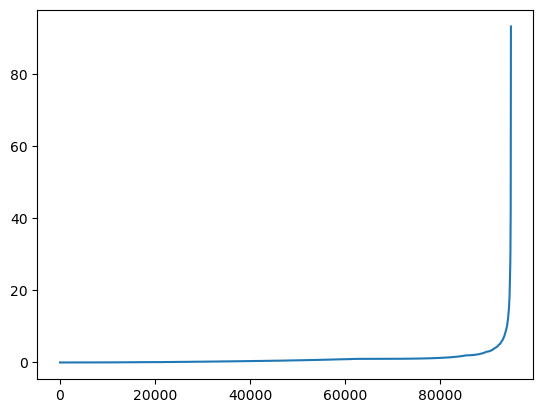

In [14]:
plt.plot(distances[0:94870])

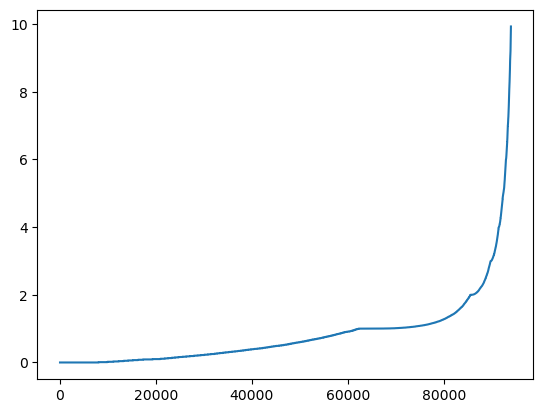

In [17]:
plt.plot(distances[0:94000])

In [18]:
# 3 seems to be a good value for the distance of the neighbors to get
# almost all the elements in a cluster, with 2 neighbors as other
# cluster criterion
Full_DF['DBSCAN_clust'] = DBSCAN(eps=3, min_samples=2).fit_predict(X)

In [19]:
Full_DF['DBSCAN_clust'].describe()

count    94889.000000
mean        70.476093
std        283.143373
min         -1.000000
25%          0.000000
50%          0.000000
75%          0.000000
max       2062.000000
Name: DBSCAN_clust, dtype: float64

In [21]:
# that's not good !
np.unique(Full_DF['DBSCAN_clust'], return_counts=True)

(array([  -1,    0,    1, ..., 2060, 2061, 2062], dtype=int64),
 array([ 5062, 80368,     3, ...,     2,     2,     2], dtype=int64))

In [22]:
# we increase the number of neighbors and decrease the 'epsilon' :
Full_DF['DBSCAN_clust'] = DBSCAN(eps=2, min_samples=5).fit_predict(X)

In [23]:
Full_DF['DBSCAN_clust'].describe()

count    94889.000000
mean        40.882895
std        145.134027
min         -1.000000
25%          1.000000
50%          1.000000
75%          1.000000
max        986.000000
Name: DBSCAN_clust, dtype: float64

In [24]:
# that's still not good, but a bit better
np.unique(Full_DF['DBSCAN_clust'], return_counts=True)

(array([ -1,   0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,
         12,  13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,
         25,  26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,
         38,  39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,
         51,  52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,
         64,  65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,
         77,  78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,
         90,  91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102,
        103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115,
        116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128,
        129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141,
        142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154,
        155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167,
        168, 169, 170, 171, 172, 173, 174, 175, 176

In [25]:
# let's search with the aim to have 20 clusters max
Full_DF['DBSCAN_clust'] = DBSCAN(eps=1.5, min_samples=10).fit_predict(X)

In [26]:
Full_DF['DBSCAN_clust'].describe()

count    94889.000000
mean        73.906459
std        178.595239
min         -1.000000
25%         -1.000000
50%         -1.000000
75%         17.000000
max        927.000000
Name: DBSCAN_clust, dtype: float64

In [27]:
# still a lot too much !
Full_DF['DBSCAN_clust'] = DBSCAN(eps=1, min_samples=15).fit_predict(X)

In [28]:
Full_DF['DBSCAN_clust'].describe()

count    94889.000000
mean        -0.900600
std          1.209194
min         -1.000000
25%         -1.000000
50%         -1.000000
75%         -1.000000
max         26.000000
Name: DBSCAN_clust, dtype: float64

In [29]:
np.unique(Full_DF['DBSCAN_clust'], return_counts=True)

(array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
        16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26], dtype=int64),
 array([93829,   218,    59,    39,    15,    50,   167,    37,    28,
           17,    63,    30,    16,    48,    31,    47,    20,    25,
           17,    15,    16,    15,     9,    15,    18,    15,    15,
           15], dtype=int64))

In [30]:
# almost all the elements are in the 'anomalies' cluster !
Full_DF['DBSCAN_clust'] = DBSCAN(eps=1, min_samples=5).fit_predict(X)

In [31]:
Full_DF['DBSCAN_clust'].describe()

count    94889.000000
mean       271.062642
std        595.056325
min         -1.000000
25%         -1.000000
50%         -1.000000
75%         95.000000
max       2673.000000
Name: DBSCAN_clust, dtype: float64

In [32]:
Full_DF['DBSCAN_clust'] = DBSCAN(eps=0.5, min_samples=5).fit_predict(X)

In [33]:
Full_DF['DBSCAN_clust'].describe()

count    94889.000000
mean        30.917072
std        140.972590
min         -1.000000
25%         -1.000000
50%         -1.000000
75%         -1.000000
max       1017.000000
Name: DBSCAN_clust, dtype: float64

In [34]:
Full_DF['DBSCAN_clust'] = DBSCAN(eps=0.5, min_samples=10).fit_predict(X)
Full_DF['DBSCAN_clust'].describe()

count    94889.000000
mean        -0.911159
std          1.363576
min         -1.000000
25%         -1.000000
50%         -1.000000
75%         -1.000000
max         34.000000
Name: DBSCAN_clust, dtype: float64

In [35]:
Full_DF['DBSCAN_clust'] = DBSCAN(eps=0.5, min_samples=15).fit_predict(X)
Full_DF['DBSCAN_clust'].describe()

count    94889.000000
mean        -0.988492
std          0.263523
min         -1.000000
25%         -1.000000
50%         -1.000000
75%         -1.000000
max          8.000000
Name: DBSCAN_clust, dtype: float64

In [36]:
Full_DF['DBSCAN_clust'] = DBSCAN(eps=2, min_samples=15).fit_predict(X)
Full_DF['DBSCAN_clust'].describe()

count    94889.00000
mean        29.98806
std         83.30058
min         -1.00000
25%         -1.00000
50%         -1.00000
75%          4.00000
max        475.00000
Name: DBSCAN_clust, dtype: float64

In [37]:
# Now we try to have an idea of the right distance to neighbors to choose for
# DBSCAN clustering with TEN neighbors :
NNgb = NearestNeighbors(n_neighbors=10)
ngbrs = NNgb.fit(X)
distances, indices = ngbrs.kneighbors(X)
distances

array([[0.        , 1.03580886, 1.22      , ..., 2.37453153, 2.37453153,
        2.48211603],
       [0.        , 0.01      , 2.78632374, ..., 5.11863263, 5.13965952,
        6.13371829],
       [0.        , 1.0384604 , 1.04694795, ..., 2.05912603, 2.09095672,
        2.16480946],
       ...,
       [0.        , 1.04383507, 1.05128095, ..., 4.56420767, 4.66712884,
        4.68697041],
       [0.        , 0.83851487, 0.90261132, ..., 1.82175937, 1.93835167,
        2.08353238],
       [0.        , 1.04838781, 1.78168937, ..., 2.8569944 , 2.88643673,
        3.00930507]])

In [38]:
distances[3,:]

array([0.        , 0.29      , 0.77      , 0.95      , 1.02610916,
       1.02610916, 1.02610916, 1.03324731, 1.11803399, 1.15602768])

In [39]:
indices[3,:]

array([    3, 25744, 51454, 49304, 31450, 30355, 87882,  7104, 37346,
         203], dtype=int64)

In [40]:
distances[:,9].max()

9016.091110542922

In [41]:
distances[:,9].mean()

3.8789565022428865

In [42]:
distances[:,9].std()

36.71067997692813

In [43]:
Full_DF['DBSCAN_clust'] = DBSCAN(eps=4, min_samples=10).fit_predict(X)
Full_DF['DBSCAN_clust'].describe()

count    94889.000000
mean         1.487928
std         11.771386
min         -1.000000
25%          0.000000
50%          0.000000
75%          0.000000
max        150.000000
Name: DBSCAN_clust, dtype: float64

In [45]:
Full_DF['DBSCAN_clust'] = DBSCAN(eps=5, min_samples=8).fit_predict(X)
Full_DF['DBSCAN_clust'].describe()

count    94889.000000
mean         1.251631
std         10.442151
min         -1.000000
25%          0.000000
50%          0.000000
75%          0.000000
max        146.000000
Name: DBSCAN_clust, dtype: float64

In [46]:
Full_DF['DBSCAN_clust'] = DBSCAN(eps=6, min_samples=7).fit_predict(X)
Full_DF['DBSCAN_clust'].describe()

count    94889.000000
mean         1.093562
std          9.567643
min         -1.000000
25%          0.000000
50%          0.000000
75%          0.000000
max        141.000000
Name: DBSCAN_clust, dtype: float64

In [47]:
Full_DF['DBSCAN_clust'] = DBSCAN(eps=6, min_samples=5).fit_predict(X)
Full_DF['DBSCAN_clust'].describe()

count    94889.000000
mean         1.831782
std         14.798222
min         -1.000000
25%          0.000000
50%          0.000000
75%          0.000000
max        210.000000
Name: DBSCAN_clust, dtype: float64

In [48]:
Full_DF['DBSCAN_clust'] = DBSCAN(eps=10, min_samples=5).fit_predict(X)
Full_DF['DBSCAN_clust'].describe()

count    94889.000000
mean         1.064602
std          9.707917
min         -1.000000
25%          0.000000
50%          0.000000
75%          0.000000
max        153.000000
Name: DBSCAN_clust, dtype: float64

In [49]:
Full_DF['DBSCAN_clust'] = DBSCAN(eps=12, min_samples=4).fit_predict(X)
Full_DF['DBSCAN_clust'].describe()

count    94889.000000
mean         0.678867
std          7.334516
min         -1.000000
25%          0.000000
50%          0.000000
75%          0.000000
max        134.000000
Name: DBSCAN_clust, dtype: float64

In [50]:
Full_DF['DBSCAN_clust'] = DBSCAN(eps=15, min_samples=3).fit_predict(X)
Full_DF['DBSCAN_clust'].describe()

count    94889.000000
mean         0.453161
std          5.764177
min         -1.000000
25%          0.000000
50%          0.000000
75%          0.000000
max        128.000000
Name: DBSCAN_clust, dtype: float64

In [51]:
Full_DF['DBSCAN_clust'] = DBSCAN(eps=15, min_samples=12).fit_predict(X)
Full_DF['DBSCAN_clust'].describe()

count    94889.000000
mean         0.049026
std          1.034478
min         -1.000000
25%          0.000000
50%          0.000000
75%          0.000000
max         24.000000
Name: DBSCAN_clust, dtype: float64

In [52]:
Full_DF['DBSCAN_clust'] = DBSCAN(eps=15, min_samples=15).fit_predict(X)
Full_DF['DBSCAN_clust'].describe()

count    94889.000000
mean         0.048783
std          1.106661
min         -1.000000
25%          0.000000
50%          0.000000
75%          0.000000
max         23.000000
Name: DBSCAN_clust, dtype: float64

In [53]:
np.unique(Full_DF['DBSCAN_clust'], return_counts=True)

(array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
        16, 17, 18, 19, 20, 21, 22, 23], dtype=int64),
 array([ 2995, 91032,   205,    53,    24,    65,    35,    20,    40,
           39,    31,    16,    43,    23,    24,    27,    28,    23,
            9,    30,    25,    15,    15,    11,    61], dtype=int64))

In [54]:
Full_DF['DBSCAN_clust'] = DBSCAN(eps=15, min_samples=20).fit_predict(X)
Full_DF['DBSCAN_clust'].describe()

count    94889.00000
mean         0.00900
std          0.70949
min         -1.00000
25%          0.00000
50%          0.00000
75%          0.00000
max         16.00000
Name: DBSCAN_clust, dtype: float64

In [55]:
np.unique(Full_DF['DBSCAN_clust'], return_counts=True)

(array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
        16], dtype=int64),
 array([ 3793, 90329,   201,    43,    33,    20,    20,   174,    62,
           21,    21,    29,    22,    30,    14,    21,    18,    38],
       dtype=int64))

Il va être difficile de ne pas avoir un énorme cluster, ou une majorité d'anomalies, avec cet algorithme pour nos données; Il ne semble pas adapté. On peut quand même regarder le dernier résultat :

In [56]:
colors = ['lightgray','moccasin','firebrick','red','salmon','sienna','tan',\
          'gold','olivedrab','chartreuse','limegreen','green','aqua',\
          'steelblue','royalblue','darkblue','blueviolet','fuchsia']
Full_DF['color'] = 'white'
for i in range(18):
    Full_DF.loc[Full_DF['DBSCAN_clust'] == (i - 1), 'color'] = colors[i]

In [57]:
import plotly.express as px
fig= px.scatter_3d(Full_DF, x='frequency', y='orders_total_amount', z='recency',\
                   color='color',opacity=0.8)
fig.update_traces(marker_size = 3)
fig.show()

Malheureusement px considère les couleurs qu'on lui passe comme des catégories quelconques et met en place ses couleurs. Toutefois on voit bien que les classes crées par le DBSCAN sont très ponctuelles et ne semblent pas réveler des catégories de clients bien caractérisées, dans le sens ou les caractères de la classe sont aussi présents chez les voisins n'appartenant pas à la classe.

In [59]:
Full_DF.loc[Full_DF['DBSCAN_clust'] == 13, :]

,customer_unique_id,order_count,first_purchase_date,last_purchase_date,orders_total_amount,recency,frequency,M,R,DBSCAN_clust,color
30505,5a49489ef92cdd53d89ead5476bd3f65,1,2018-01-14 12:23:16,NaN,698.50,294,0.500000,6.550366,5.686975,13,royalblue
33668,f55b07d4db1bf6894473295c7fd5989e,1,2018-01-11 22:10:06,NaN,710.22,297,0.500000,6.566982,5.697093,13,royalblue
40320,d5340d65f40498ff9e47f7772081ab39,1,2018-01-04 12:32:11,NaN,690.68,304,0.500000,6.539123,5.720312,13,royalblue
43725,0309db53bd596593382d0accd83d292e,1,2018-01-15 19:26:18,NaN,702.97,293,0.500000,6.556736,5.683580,13,royalblue
44144,751499e23bee98be291ec8f63463a5be,1,2018-01-23 00:55:19,NaN,698.50,285,0.500000,6.550366,5.655992,13,royalblue
44777,4d64fae536cbb332a2a84c3ee7a8f3c5,1,2018-01-14 17:18:57,NaN,712.05,294,0.500000,6.569552,5.686975,13,royalblue
48477,e73e97b69887ff2806910c7f9afeb471,1,2018-01-06 17:50:14,NaN,702.18,302,0.500000,6.555613,5.713733,13,royalblue
57556,21611dfeeecee2c4646828b01d61cd38,1,2018-01-13 15:24:28,NaN,710.98,295,0.500000,6.568050,5.690359,13,royalblue
58450,727cf95c2abbc5281e538936d22837e2,1,2018-01-25 21:51:21,NaN,701.04,283,0.500000,6.553990,5.648974,13,royalblue
63710,d4bfb52232b293647e88915939ceb6ca,1,2018-01-15 13:33:36,NaN,704.32,293,0.500000,6.558652,5.683580,13,royalblue


In [2]:
# To close this step, let's try to visualize the clusters when they are very few :
X = Full_DF.take([4,5,6], axis=1)
Full_DF['DBSCAN_clust'] = DBSCAN(eps=3, min_samples=100).fit_predict(X)

In [3]:
Full_DF['DBSCAN_clust'].describe()

count    94889.000000
mean        -0.983402
std          0.174424
min         -1.000000
25%         -1.000000
50%         -1.000000
75%         -1.000000
max          2.000000
Name: DBSCAN_clust, dtype: float64

In [4]:
#import numpy as np
np.unique(Full_DF['DBSCAN_clust'], return_counts=True)

(array([-1,  0,  1,  2], dtype=int64),
 array([93881,   543,   363,   102], dtype=int64))

In [8]:
# to remove
Full_DF['DBSCAN_clust'] = DBSCAN(eps=3, min_samples=100).fit_predict(X)
Full_DF['DBSCAN_clust'].describe()

count    94889.000000
mean        -0.983402
std          0.174424
min         -1.000000
25%         -1.000000
50%         -1.000000
75%         -1.000000
max          2.000000
Name: DBSCAN_clust, dtype: float64

<Axes: xlabel='frequency', ylabel='orders_total_amount'>

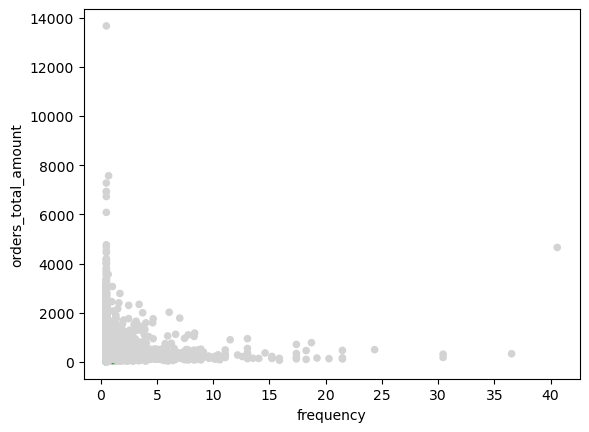

In [10]:
colors = ['lightgray','green','aqua','royalblue']
Full_DF['color'] = 'white'
for i in range(4):
    Full_DF.loc[Full_DF['DBSCAN_clust'] == (i - 1), 'color'] = colors[i]
    
Full_DF.plot(kind='scatter', x='frequency', y='orders_total_amount',\
                   c=Full_DF['color'])

<Axes: xlabel='recency', ylabel='frequency'>

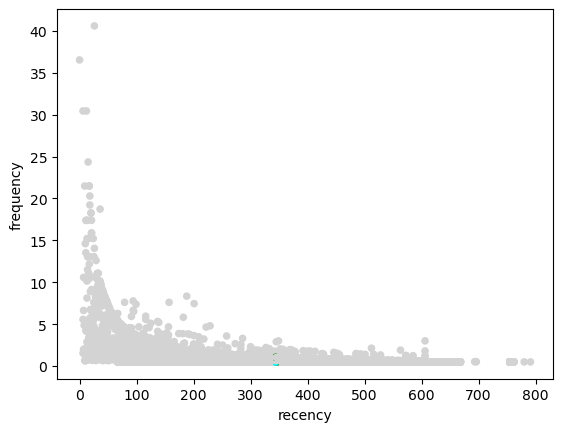

In [11]:
Full_DF.plot(kind='scatter', x='recency', y='frequency',\
                   c=Full_DF['color'])

<Axes: xlabel='recency', ylabel='frequency'>

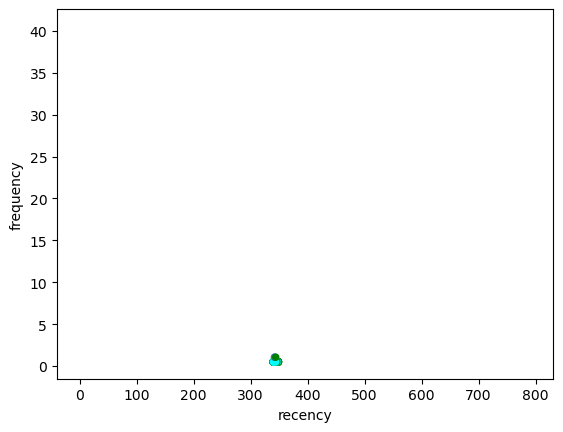

In [12]:
# almost impossible to see the few non-grey points, so let's hide the grey points
Full_DF.loc[Full_DF['DBSCAN_clust'] == -1, 'color'] = 'none'
Full_DF.plot(kind='scatter', x='recency', y='frequency',\
                   c=Full_DF['color'])

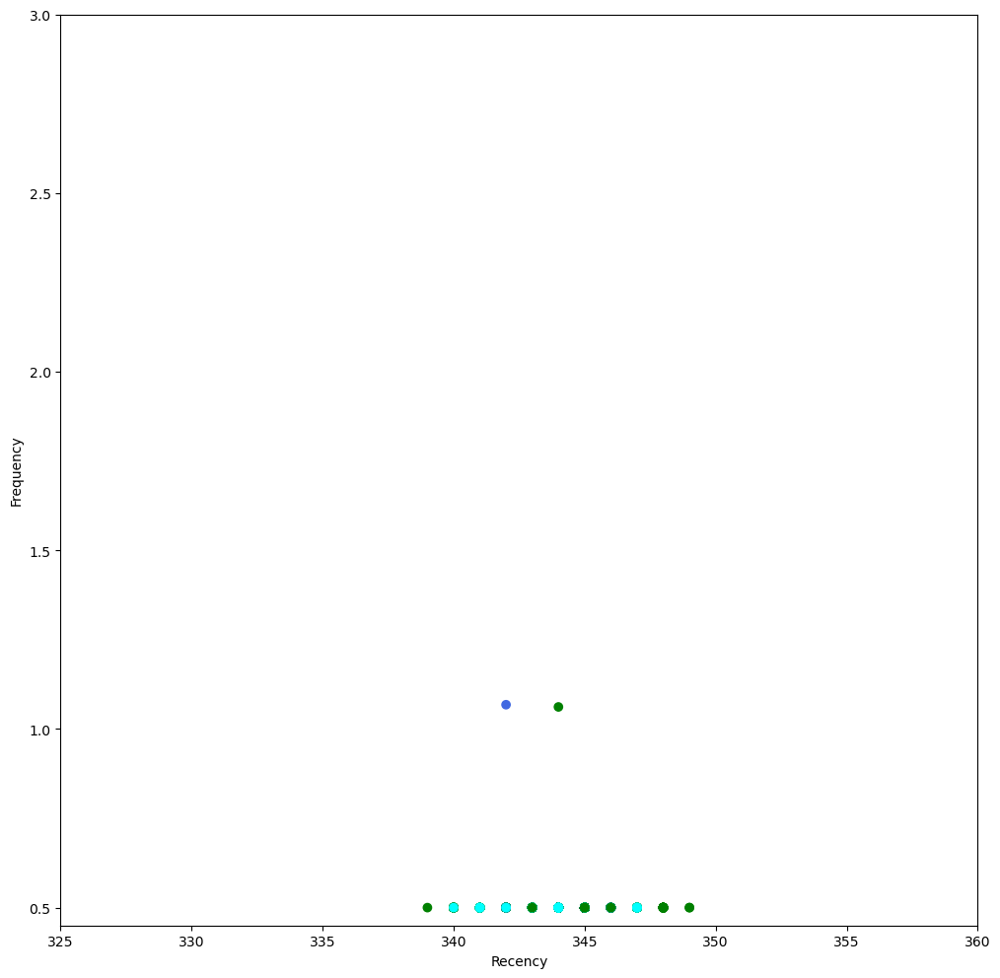

In [15]:
# We have here more than 1000 rows ! But very close to each other.
plt.figure(figsize=(12,12))
plt.xlim(325,360)
plt.ylim(0.45,3)
plt.scatter(Full_DF['recency'], Full_DF['frequency'],\
            c=Full_DF['color'])
plt.xlabel('Recency')
plt.ylabel('Frequency')
plt.show()

<a name='E5'>

Nous allons donc essayer une autre méthode de classification : la Classification Ascendante Hiérarchique ou 'CAH'. Toujours avec les mêmes données.  Mais comme nous avons un grand nombre d'individus, la CAH risque d'être laborieuse, nous allons donc essayer de lui faciliter la tâche en réalisant au préalable un k-means avec un grand nombre de classes, puis faire la CAH sur ces classes, chacune comportant beaucoup d'individus, qui seront tous représentés par le centre de la classe, donc identiques du point de vu de la CAH.

In [18]:
Full_DF = Full_DF.drop(['DBSCAN_clust','color'], axis=1)

In [20]:
KM_data = StandardScaler().fit_transform(Full_DF.take([6,7,8], axis=1))
kmeans = KMeans(n_clusters=300, n_init=10)
kmeans.fit(KM_data)
Full_DF['kMeans_clust'] = kmeans.labels_
Full_DF['kMeans_clust'].describe()

count    94889.000000
mean       142.689100
std         85.871658
min          0.000000
25%         68.000000
50%        143.000000
75%        214.000000
max        299.000000
Name: kMeans_clust, dtype: float64

In [21]:
Full_DF.loc[Full_DF['kMeans_clust'] == 50, :].count()

customer_unique_id     20
order_count            20
first_purchase_date    20
last_purchase_date     20
orders_total_amount    20
recency                20
frequency              20
M                      20
R                      20
kMeans_clust           20
dtype: int64

In [23]:
np.unique(Full_DF['kMeans_clust'], return_counts=True)

(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
        117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
        130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
        143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
        156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
        169, 170, 171, 172, 173, 174, 175, 176, 177

In [25]:
np.unique(Full_DF['kMeans_clust'], return_counts=True)[1].mean()

316.2966666666667

In [26]:
Full_DF['clust_mean_amount'] = 55
for i in range(300):
    Full_DF.loc[Full_DF['kMeans_clust'] == i, 'clust_mean_amount'] =\
    Full_DF.loc[Full_DF['kMeans_clust'] == i, 'orders_total_amount'].mean()


In [27]:
Full_DF['clust_mean_recency'] = 55
for i in range(300):
    Full_DF.loc[Full_DF['kMeans_clust'] == i, 'clust_mean_recency'] =\
    Full_DF.loc[Full_DF['kMeans_clust'] == i, 'recency'].mean()


In [28]:
Full_DF['clust_mean_freq'] = 55
for i in range(300):
    Full_DF.loc[Full_DF['kMeans_clust'] == i, 'clust_mean_freq'] =\
    Full_DF.loc[Full_DF['kMeans_clust'] == i, 'frequency'].mean()


In [29]:
Full_DF.head()

,customer_unique_id,order_count,first_purchase_date,last_purchase_date,orders_total_amount,recency,frequency,M,R,kMeans_clust,clust_mean_amount,clust_mean_recency,clust_mean_freq
0,861eff4711a542e4b93843c6dd7febb0,1,2017-05-16 15:05:35,NaN,146.87,537,0.5,4.996334,6.287859,100,149.811797,534.326823,0.501607
1,290c77bc529b7ac935b93aa66c333dc3,1,2018-01-12 20:48:24,NaN,335.48,296,0.5,5.818539,5.693732,235,315.793522,281.302956,0.501693
2,060e732b5b29e8181a18229c7b0b2b5e,1,2018-05-19 16:07:45,NaN,157.73,169,0.5,5.067205,5.135798,179,168.816220,181.699405,0.500000
3,259dac757896d24d7702b9acbbff3f3c,1,2018-03-13 16:06:38,NaN,173.30,236,0.5,5.160778,5.468060,96,166.048890,242.983970,0.500000
4,345ecd01c38d18a9036ed96c73b8d066,1,2018-07-29 09:51:30,NaN,252.25,98,0.5,5.534377,4.595120,170,248.587309,105.832861,0.503321


Nous allons maintenant faire travailler une CAH sur les trois nouvelles colonnes, ne contenant que 300 individus différents, mais dont la majorité sont répétés, 316 fois en moyenne.

In [30]:
Full_DF.to_csv('Full_DF_ACH.csv')

In [2]:
CAH_DF = Full_DF.take([10,11,12], axis=1)

# let's try at first with three clusters :
cah = AgglomerativeClustering(n_clusters=3, linkage="ward")
cah.fit(CAH_DF)
Full_DF['CAH_clust'] = cah.labels_

MemoryError: unable to allocate array data.

La stratégie tentée n'a pas permis d'aider la CAH à aboutir. Comme cet algo. est trop gourmand en mémoire, on va le faire travailler sur les 300 clusters uniquement, puis affecter la partition obtenue aux individus de notre jeu initial. Ainsi, même si le 'poid' des classes issues du k-means n'est pas pris en compte dans la CAH, il le sera ensuite avec le nombre d'individus ayant la même classe CAH.

In [4]:
Full_DF[['clust_mean_amount','clust_mean_recency','clust_mean_freq']].nunique()

clust_mean_amount     299
clust_mean_recency    299
clust_mean_freq       203
dtype: int64

In [3]:
CAH_DF = CAH_DF.drop_duplicates(['clust_mean_amount', 'clust_mean_recency',
                                 'clust_mean_freq'], keep='first')
CAH_DF.shape

(300, 3)

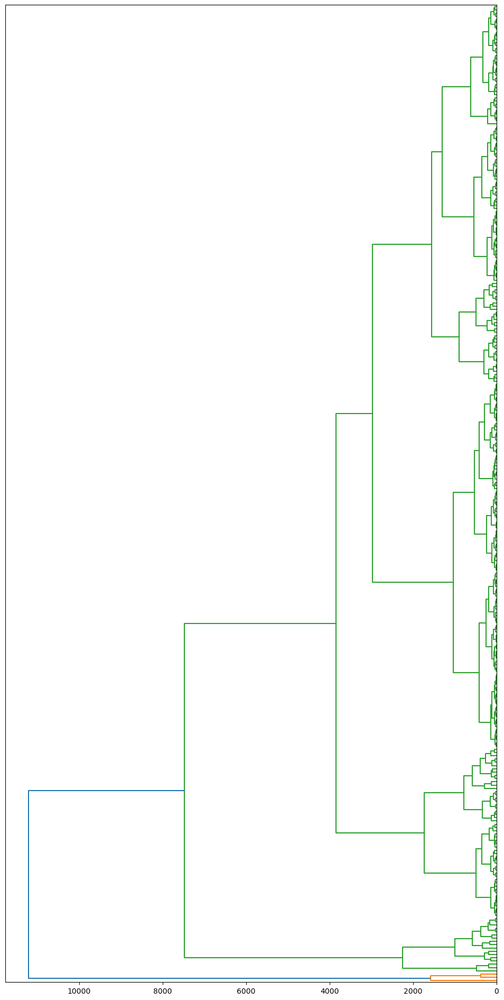

In [11]:
# let's see the shape of the linkage got with scipy :
Z = linkage(CAH_DF, 'ward')
plt.figure(figsize=(12, 24))
#dn = dendrogram(Z, orientation='left', labels=[str(i) for i in range(1,301)])
dn = dendrogram(Z, orientation='left', no_labels=True)

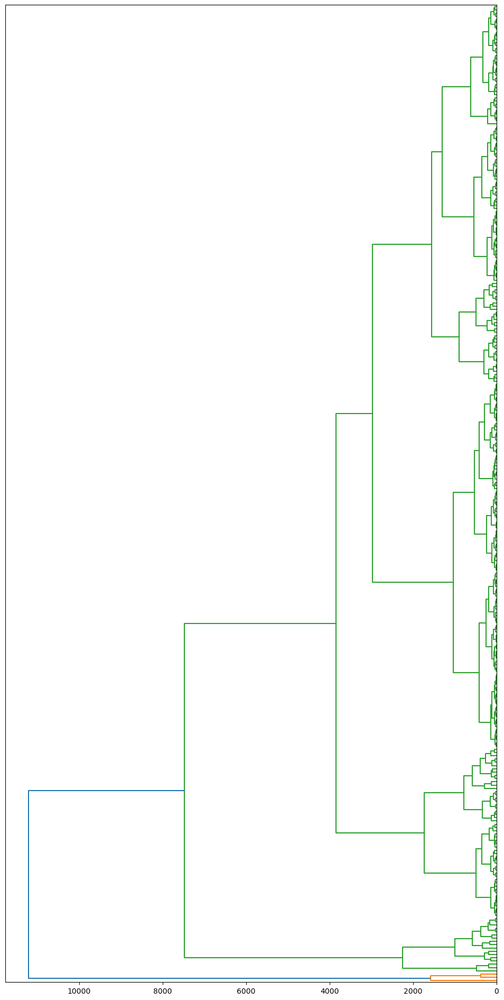

In [21]:
# as for the k-means clustering, the clusters sizes are
# very differents each other.
# A try with scikit-learn :

def create_linkage_matrix(cah):                # a pity that it is not
    counts = np.zeros(cah.children_.shape[0])  # already-done like for scipy
    n_samples = len(cah.labels_)
    for i, merge in enumerate(cah.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count
        
    return np.column_stack([cah.children_, cah.distances_, counts]
                          ).astype(float)

cah = AgglomerativeClustering(n_clusters=None, compute_full_tree=True,
                              linkage="ward", distance_threshold=0)
cah.fit(CAH_DF)
linkage_matrix = create_linkage_matrix(cah)
plt.figure(figsize=(12, 24))
dendrogram(linkage_matrix, orientation='left', no_labels=True)
plt.show()   # useless except to avoid the display of linkage_matrix
#Full_DF['CAH_clust'] = cah.labels_

Les dendrogrammes obtenus par les deux librairies sont visuellement identiques, et suggèrent une classification pertinente en quatre ou cinq classes. Nous allons essayer ces deux nombres de classes.

In [25]:
cah4 = AgglomerativeClustering(n_clusters=4, linkage="ward")
cah4.fit(CAH_DF)
CAH_DF['cah4_clust'] = cah4.labels_
display(CAH_DF)

,clust_mean_amount,clust_mean_recency,clust_mean_freq,cah4_clust
0,149.811797,534.326823,0.501607,0
1,315.793522,281.302956,0.501693,0
2,168.816220,181.699405,0.500000,0
3,166.048890,242.983970,0.500000,0
4,248.587309,105.832861,0.503321,0
...,...,...,...,...
93325,189.323333,15.333333,6.681902,0
94110,133.070000,18.000000,20.291667,0
94273,4655.880000,26.000000,40.583333,3
94426,248.280000,9.000000,30.437500,0


In [26]:
Full_CAH_DF = pd.merge(Full_DF, CAH_DF, how='left', left_on=['clust_mean_amount',
                                                 'clust_mean_recency',
                                                 'clust_mean_freq'],
                       right_on=['clust_mean_amount',
                                 'clust_mean_recency',
                                 'clust_mean_freq'])
display(Full_CAH_DF)

,customer_unique_id,order_count,first_purchase_date,last_purchase_date,orders_total_amount,recency,frequency,M,R,kMeans_clust,clust_mean_amount,clust_mean_recency,clust_mean_freq,cah4_clust
0,861eff4711a542e4b93843c6dd7febb0,1,2017-05-16 15:05:35,NaN,146.87,537,0.500000,4.996334,6.287859,100,149.811797,534.326823,0.501607,0
1,290c77bc529b7ac935b93aa66c333dc3,1,2018-01-12 20:48:24,NaN,335.48,296,0.500000,5.818539,5.693732,235,315.793522,281.302956,0.501693,0
2,060e732b5b29e8181a18229c7b0b2b5e,1,2018-05-19 16:07:45,NaN,157.73,169,0.500000,5.067205,5.135798,179,168.816220,181.699405,0.500000,0
3,259dac757896d24d7702b9acbbff3f3c,1,2018-03-13 16:06:38,NaN,173.30,236,0.500000,5.160778,5.468060,96,166.048890,242.983970,0.500000,0
4,345ecd01c38d18a9036ed96c73b8d066,1,2018-07-29 09:51:30,NaN,252.25,98,0.500000,5.534377,4.595120,170,248.587309,105.832861,0.503321,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94884,ff22e30958c13ffe219db7d711e8f564,2,2018-08-24 17:02:19,2018-09-03 09:06:57,332.92,0,36.525000,5.810901,0.000000,12,332.920000,0.000000,36.525000,1
94885,ff44401d0d8f5b9c54a47374eb48c1b8,2,2017-05-19 21:20:54,2017-05-19 21:20:54,68.00,472,0.773835,4.234107,6.159095,89,82.919091,435.800000,0.866918,0
94886,ff8892f7c26aa0446da53d01b18df463,2,2017-05-24 16:09:14,2017-11-26 23:25:43,330.14,281,0.782120,5.802541,5.641907,79,360.252500,236.326923,0.869205,0
94887,ff922bdd6bafcdf99cb90d7f39cea5b3,3,2017-02-22 12:26:42,2017-09-14 14:24:04,139.60,354,1.309140,4.945919,5.872118,145,108.883594,273.750000,1.270629,0


In [27]:
Full_CAH_DF.to_csv('Full_DF_ACH.csv')

<Axes: xlabel='recency', ylabel='frequency'>

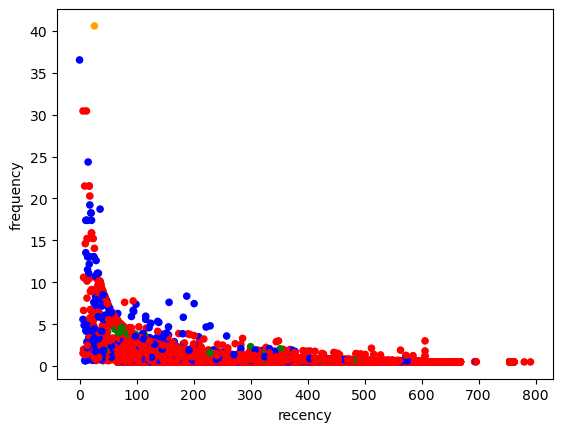

In [3]:
colors = ['red','blue','green','orange']
Full_CAH_DF['color'] = Full_CAH_DF['cah4_clust'].map(lambda p: colors[p])
Full_CAH_DF.plot(kind='scatter', x='recency', y='frequency',\
                   c=Full_CAH_DF['color'])

<Axes: xlabel='frequency', ylabel='orders_total_amount'>

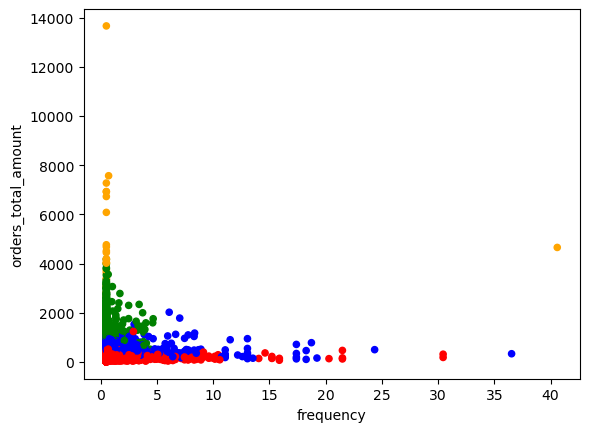

In [4]:
Full_CAH_DF.plot(kind='scatter', x='frequency', y='orders_total_amount',\
                   c=Full_CAH_DF['color'])

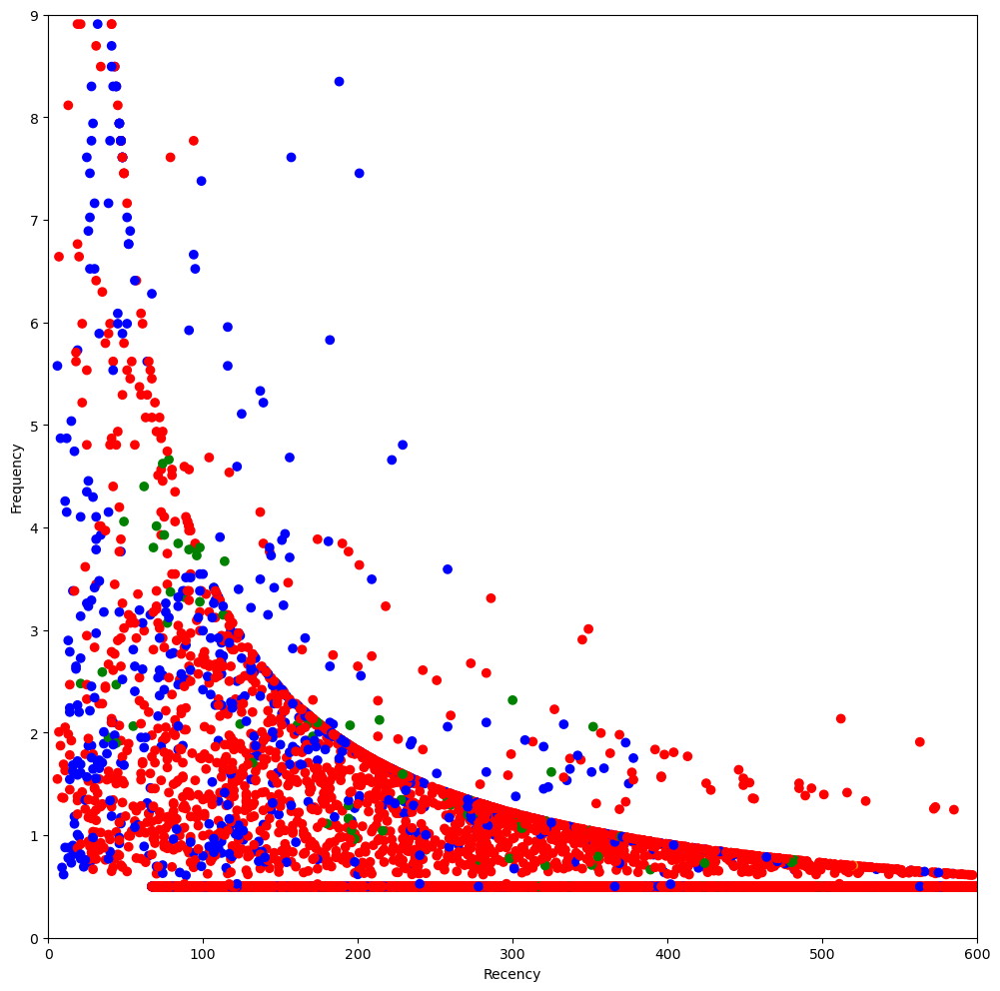

In [5]:
plt.figure(figsize=(12,12))
plt.xlim(0,600)
plt.ylim(0,9)
plt.scatter(Full_CAH_DF['recency'], Full_CAH_DF['frequency'],\
            c=Full_CAH_DF['color'])
plt.xlabel('Recency')
plt.ylabel('Frequency')
plt.show()

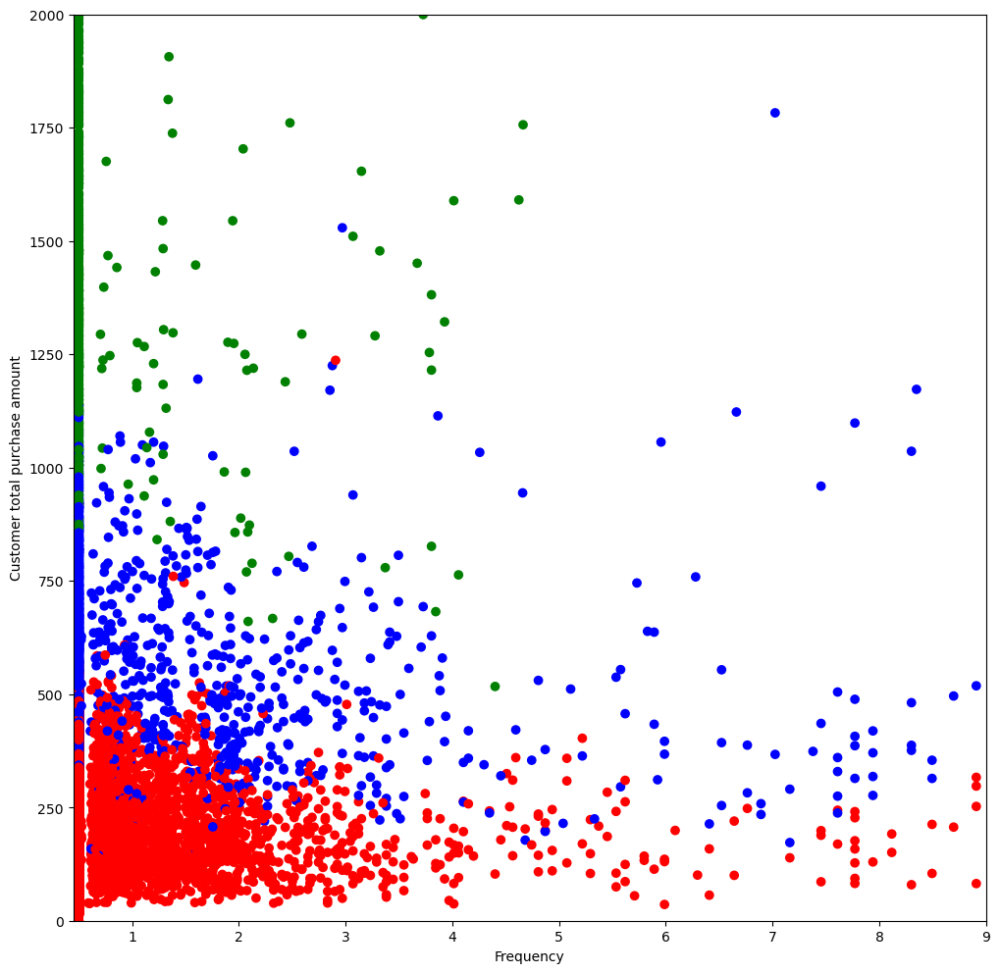

In [6]:
plt.figure(figsize=(12,12))
plt.xlim(0.45,9)
plt.ylim(0,2000)
plt.scatter(Full_CAH_DF['frequency'], Full_CAH_DF['orders_total_amount'],\
            c=Full_CAH_DF['color'])
plt.xlabel('Frequency')
plt.ylabel('Customer total purchase amount')
plt.show()

In [7]:
Limited_DF = Full_CAH_DF.loc[(Full_CAH_DF['frequency'] < 9) &\
                              (Full_CAH_DF['orders_total_amount'] < 1300) &\
                              (Full_CAH_DF['recency'] < 500),\
                              ['frequency','orders_total_amount',\
                               'recency','color']]
fig = px.scatter_3d(Limited_DF, x='frequency', y='orders_total_amount',\
                   z='recency',\
                   color='color',opacity=0.8)
fig.update_traces(marker_size = 3)
fig.show()   # newplot1.png

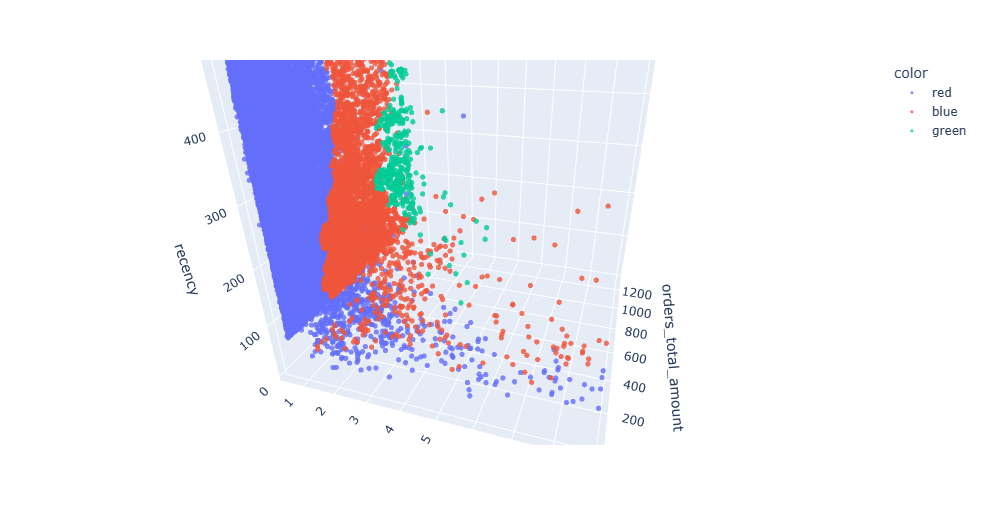

Les couleurs rouge et bleu sont inversées ici par rapport aux graphes 2D précédents.
<br>Ces classes sont plus difficiles à interpréter en termes de RFM que celles données par le k-means. Il en sera sans doute de même si on 'coupe' la CAH à cinq 'branches', vérifions :

In [2]:
cah5 = AgglomerativeClustering(n_clusters=5, linkage="ward")
cah5.fit(CAH_DF)
CAH_DF['cah5_clust'] = cah5.labels_
Full_CAH_DF = pd.merge(Full_CAH_DF, CAH_DF, how='left', left_on=['clust_mean_amount',
                                                 'clust_mean_recency',
                                                 'clust_mean_freq'],
                       right_on=['clust_mean_amount',
                                 'clust_mean_recency',
                                 'clust_mean_freq'])
display(Full_CAH_DF)

,customer_unique_id,order_count,first_purchase_date,last_purchase_date,orders_total_amount,recency,frequency,M,R,kMeans_clust,clust_mean_amount,clust_mean_recency,clust_mean_freq,cah4_clust,cah5_clust
0,861eff4711a542e4b93843c6dd7febb0,1,2017-05-16 15:05:35,NaN,146.87,537,0.500000,4.996334,6.287859,100,149.811797,534.326823,0.501607,0,2
1,290c77bc529b7ac935b93aa66c333dc3,1,2018-01-12 20:48:24,NaN,335.48,296,0.500000,5.818539,5.693732,235,315.793522,281.302956,0.501693,0,2
2,060e732b5b29e8181a18229c7b0b2b5e,1,2018-05-19 16:07:45,NaN,157.73,169,0.500000,5.067205,5.135798,179,168.816220,181.699405,0.500000,0,4
3,259dac757896d24d7702b9acbbff3f3c,1,2018-03-13 16:06:38,NaN,173.30,236,0.500000,5.160778,5.468060,96,166.048890,242.983970,0.500000,0,2
4,345ecd01c38d18a9036ed96c73b8d066,1,2018-07-29 09:51:30,NaN,252.25,98,0.500000,5.534377,4.595120,170,248.587309,105.832861,0.503321,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94884,ff22e30958c13ffe219db7d711e8f564,2,2018-08-24 17:02:19,2018-09-03 09:06:57,332.92,0,36.525000,5.810901,0.000000,12,332.920000,0.000000,36.525000,1,1
94885,ff44401d0d8f5b9c54a47374eb48c1b8,2,2017-05-19 21:20:54,2017-05-19 21:20:54,68.00,472,0.773835,4.234107,6.159095,89,82.919091,435.800000,0.866918,0,2
94886,ff8892f7c26aa0446da53d01b18df463,2,2017-05-24 16:09:14,2017-11-26 23:25:43,330.14,281,0.782120,5.802541,5.641907,79,360.252500,236.326923,0.869205,0,2
94887,ff922bdd6bafcdf99cb90d7f39cea5b3,3,2017-02-22 12:26:42,2017-09-14 14:24:04,139.60,354,1.309140,4.945919,5.872118,145,108.883594,273.750000,1.270629,0,2


<Axes: xlabel='recency', ylabel='frequency'>

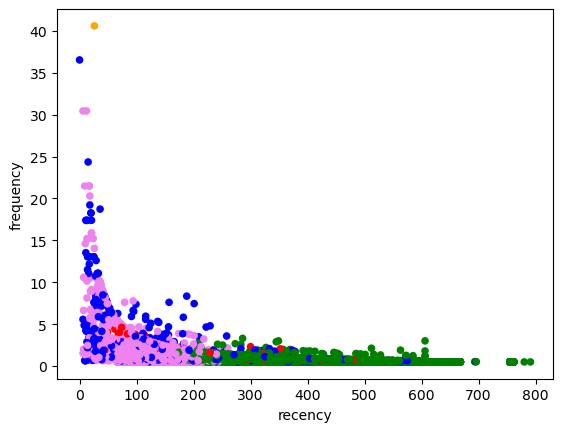

In [3]:
Full_CAH_DF.to_csv('Full_DF_ACH.csv')

colors = ['red','blue','green','orange','violet']
Full_CAH_DF['color'] = Full_CAH_DF['cah5_clust'].map(lambda p: colors[p])
Full_CAH_DF.plot(kind='scatter', x='recency', y='frequency',\
                   c=Full_CAH_DF['color'])

<Axes: xlabel='frequency', ylabel='orders_total_amount'>

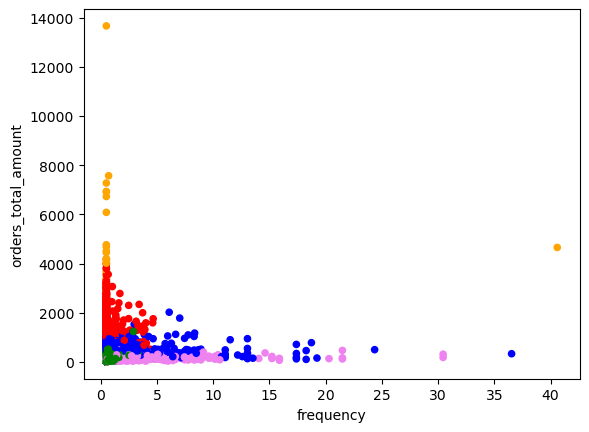

In [4]:
Full_CAH_DF.plot(kind='scatter', x='frequency', y='orders_total_amount',\
                   c=Full_CAH_DF['color'])

In [5]:
Limited_DF = Full_CAH_DF.loc[(Full_CAH_DF['frequency'] < 9) &\
                              (Full_CAH_DF['orders_total_amount'] < 1500) &\
                              (Full_CAH_DF['recency'] < 500),\
                              ['frequency','orders_total_amount',\
                               'recency','color']]
fig = px.scatter_3d(Limited_DF, x='frequency', y='orders_total_amount',\
                   z='recency', color='color', opacity=0.8)
fig.update_traces(marker_size = 3)
fig.show()   # newplot2.png

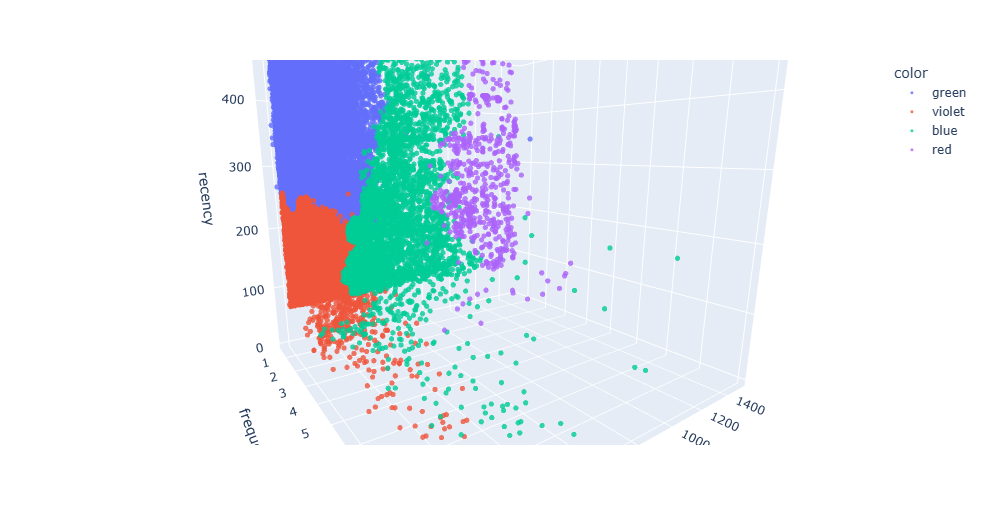

Encore des inversions de couleurs, mais on voit clairement que la plus grosse classe de la 'coupure à 4' a été divisée en deux sous classes. Cela donne une meilleure segmentation, avec la classe qui dépense le plus, celles qui dépensent le moins avec deux sous classes : les clients qui ont commandé dans les huits derniers mois et ceux dont la dernière commande est plus ancienne, une micro classe des plus gros acheteurs, et une classe 'moyenne' avec tous les autres.
<br>Globalement la CAH, qui requière un k-means pour diminuer le nombre d'individus au préalable, ne donne pas de résultat plus intéressant que le k-means seul (avec un k optimum ou presque). Nous adopterons donc le k-means pour le partitionnement RFM.
<br>Néanmoins on peut voir rapidement ce que donne la CAH avec une autre approche : étudier la classification sur un échantillon des données. Pour que cet échantillon soit représentatif, du moins ait plus de chance de l'être, nous allons le prélever de façon uniforme, par exemple prendre séquentiellement un individus sur 20.

In [2]:
Full_DF.index

RangeIndex(start=0, stop=94889, step=1)

In [2]:
Sample_DF = Full_DF.loc[[x for x in range(0,94881,20)]]

In [13]:
Sample_DF.shape

(4745, 9)

In [3]:
Sample_DF = Sample_DF.take([4,5,6], axis=1)

In [4]:
Sample_DF.head()

,orders_total_amount,recency,frequency
0,146.87,537,0.5
20,94.63,569,0.5
40,143.25,201,0.5
60,46.78,419,0.5
80,40.27,139,0.5


<Axes: xlabel='recency', ylabel='frequency'>

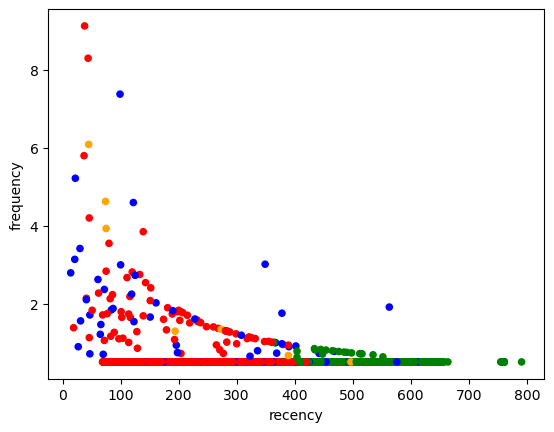

In [5]:
cah4 = AgglomerativeClustering(n_clusters=4, linkage="ward")
cah4.fit(Sample_DF)
Sample_DF['cah4_clust'] = cah4.labels_

colors = ['red','blue','green','orange']
Sample_DF['color'] = Sample_DF['cah4_clust'].map(lambda p: colors[p])
Sample_DF.plot(kind='scatter', x='recency', y='frequency',\
                   c=Sample_DF['color'])

<Axes: xlabel='frequency', ylabel='orders_total_amount'>

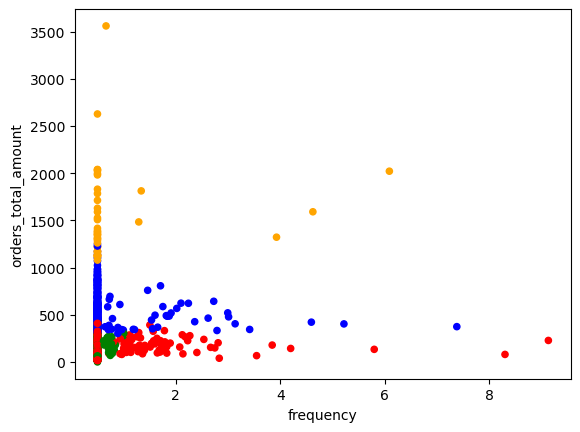

In [6]:
Sample_DF.plot(kind='scatter', x='frequency', y='orders_total_amount',\
                   c=Sample_DF['color'])

On obtient une segmentation assez différente de la précédente, elle ressemble davantage à celle obtenue avec le k-means. Voyons pour 'la coupe à cinq classes' :

<Axes: xlabel='recency', ylabel='frequency'>

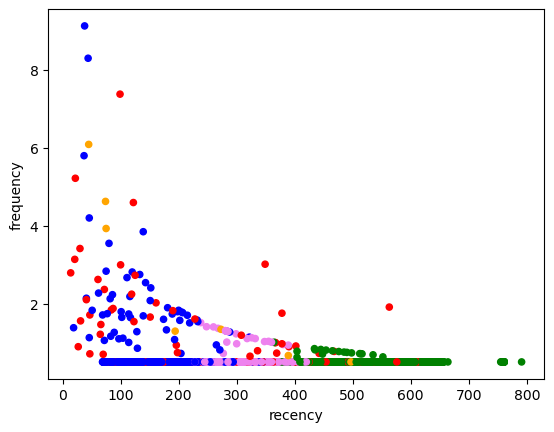

In [8]:
cah5 = AgglomerativeClustering(n_clusters=5, linkage="ward")
Sample_DF = Sample_DF.take([0,1,2], axis=1)
cah5.fit(Sample_DF)
Sample_DF['cah5_clust'] = cah5.labels_

colors = ['red','blue','green','orange','violet']
Sample_DF['color'] = Sample_DF['cah5_clust'].map(lambda p: colors[p])
Sample_DF.plot(kind='scatter', x='recency', y='frequency',\
                   c=Sample_DF['color'])

<Axes: xlabel='frequency', ylabel='orders_total_amount'>

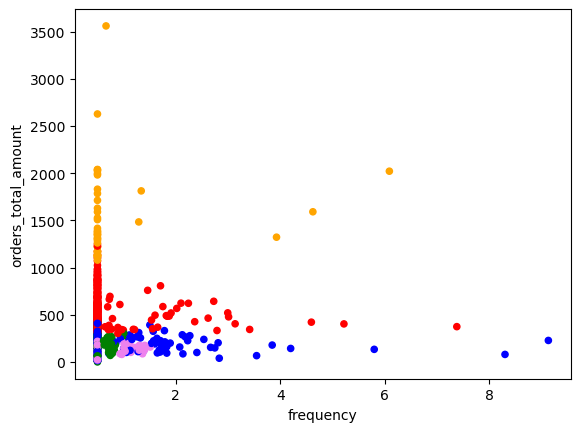

In [9]:
Sample_DF.plot(kind='scatter', x='frequency', y='orders_total_amount',\
                   c=Sample_DF['color'])

Une des classes précédente à été maintenant divisée en deux sous classes (les autres restent identiques). On obtient ainsi une segmentation bien différente du k-means à cinq classes, mais globalement les classes issues de la CAH ne sont pas plus intéressantes que celles issues du k-means.

<a name='E6'>

Il y a d'autres données très interessantes à étudier dans les données Olist, mais elles sont qualitatives contrairement aux RFM qui sont quantitatives, il faut donc faire appel à d'autres algorithmes de classification si on veut observer les partitionnements mis en évidence par l'apprentissage non supervisé.
<br>Toutefois une des données qualitatives peut être considérée comme quantitative : c'est le niveau de satisfaction client ou 'review score' noté de 1 à 5. Il peut être tout à fait interessant pour cibler les communications en plus des segments RFM, nous allons donc l'utiliser avec un k-means :

In [1]:
# At first, we need to get the relevent dataset (all clients) :

# orders = pd.read_csv('olist_orders_dataset.csv')
# customers = pd.read_csv('olist_customers_dataset.csv')

RFMS_DF = orders.take([0,1,2,3], axis=1)
RFMS_DF = pd.merge(RFMS_DF, customers, how='left', on='customer_id')

RFMS_DF.head()

,order_id,customer_id,order_status,order_purchase_timestamp,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,af07308b275d755c9edb36a90c618231,47813,barreiras,BA
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,7c142cf63193a1473d2e66489a9ae977,59296,sao goncalo do amarante,RN
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,72632f0f9dd73dfee390c9b22eb56dd6,9195,santo andre,SP


In [2]:
RFMS_DF['order_status'].unique()

array(['delivered', 'invoiced', 'shipped', 'processing', 'unavailable',
       'canceled', 'created', 'approved'], dtype=object)

In [3]:
RFMS_DF = RFMS_DF.loc[~RFMS_DF['order_status'].\
                      isin(['unavailable','canceled']), :]

In [4]:
# items =  pd.read_csv('olist_order_items_dataset.csv')
items = items.groupby('order_id').agg({'price':'sum', 'freight_value':'sum'})
items['price'] = items['price'] + items['freight_value']
items = items.drop('freight_value', axis=1)
RFMS_DF = pd.merge(RFMS_DF, items, how='left', on='order_id')
RFMS_DF.head()

,order_id,customer_id,order_status,order_purchase_timestamp,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,price
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,38.71
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,af07308b275d755c9edb36a90c618231,47813,barreiras,BA,141.46
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO,179.12
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,7c142cf63193a1473d2e66489a9ae977,59296,sao goncalo do amarante,RN,72.20
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,72632f0f9dd73dfee390c9b22eb56dd6,9195,santo andre,SP,28.62


In [5]:
# reviews = pd.read_csv('olist_order_reviews_dataset.csv')
reviews = reviews.take([1,2], axis=1)
reviews = reviews.drop_duplicates('order_id', keep='first')
RFMS_DF = pd.merge(RFMS_DF, reviews, how='left', on='order_id')
RFMS_DF.head()

,order_id,customer_id,order_status,order_purchase_timestamp,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,price,review_score
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,38.71,4.0
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,af07308b275d755c9edb36a90c618231,47813,barreiras,BA,141.46,4.0
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO,179.12,5.0
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,7c142cf63193a1473d2e66489a9ae977,59296,sao goncalo do amarante,RN,72.20,5.0
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,72632f0f9dd73dfee390c9b22eb56dd6,9195,santo andre,SP,28.62,5.0


In [6]:
RFMS_DF.isnull().sum()

order_id                      0
customer_id                   0
order_status                  0
order_purchase_timestamp      0
customer_unique_id            0
customer_zip_code_prefix      0
customer_city                 0
customer_state                0
price                         8
review_score                734
dtype: int64

In [7]:
reviews['review_score'].mean()

4.0868525331144285

In [8]:
RFMS_DF.loc[RFMS_DF['review_score'].isna(), 'review_score'] = 4

In [9]:
RFMS_DF.loc[RFMS_DF['price'].isna(), :]

,order_id,customer_id,order_status,order_purchase_timestamp,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,price,review_score
7352,b5359909123fa03c50bdb0cfed07f098,438449d4af8980d107bf04571413a8e7,created,2017-12-05 01:07:52,55fbb57fd54c35a38c80c2a032a6ca6e,15300,general salgado,SP,NaN,1.0
9132,dba5062fbda3af4fb6c33b1e040ca38f,964a6df3d9bdf60fe3e7b8bb69ed893a,created,2018-02-09 17:21:04,2e015e68fbfa36910263df5384e8e45c,73401,brasilia,DF,NaN,4.0
21176,7a4df5d8cff4090e541401a20a22bb80,725e9c75605414b21fd8c8d5a1c2f1d6,created,2017-11-25 11:10:33,355862aa14375fe3950ee04fef9c7a53,22621,rio de janeiro,RJ,NaN,1.0
22968,a68ce1686d536ca72bd2dadc4b8671e5,d7bed5fac093a4136216072abaf599d5,shipped,2016-10-05 01:47:40,f15a952dfc52308d0361288fbf42c7b3,91250,porto alegre,RS,NaN,1.0
54403,35de4050331c6c644cddc86f4f2d0d64,4ee64f4bfc542546f422da0aeb462853,created,2017-12-05 01:07:58,10d5890ed5e7ec78a7db23b5ac579b17,93025,sao leopoldo,RS,NaN,4.0
56881,2ce9683175cdab7d1c95bcbb3e36f478,b2d7ae0415dbbca535b5f7b38056dd1f,invoiced,2016-10-05 21:03:33,6a2da481aa7827b951175772a0fe8bb8,16012,aracatuba,SP,NaN,1.0
58234,90ab3e7d52544ec7bc3363c82689965f,7d61b9f4f216052ba664f22e9c504ef1,created,2017-11-06 13:12:34,161e5b2b4513edb336986a8909218365,87720,paranavai,PR,NaN,5.0
69061,e04f1da1f48bf2bbffcf57b9824f76e1,0d00d77134cae4c58695086ad8d85100,invoiced,2016-10-05 13:22:20,8886115442775dd8a20c2dcc921c7cc8,88070,florianopolis,SC,NaN,1.0


In [16]:
ITEMS =  pd.read_csv('olist_order_items_dataset.csv')
ITEMS.loc[ITEMS['order_id'].isin(RFMS_DF.loc[RFMS_DF['price'].\
                                             isna(), 'order_id']), :]

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value


In [10]:
# we suppress these few rows :
RFMS_DF = RFMS_DF.loc[~RFMS_DF['price'].isna(), :]
RFMS_DF.shape

(98199, 10)

In [11]:
RFMS_DF = RFMS_DF.sort_values('order_purchase_timestamp')
RFMS_DF = RFMS_DF.groupby('customer_unique_id')\
.agg({'order_id': 'last', 'customer_id': 'count', 'order_status': 'last',
      'order_purchase_timestamp': ['first', 'last'],
      'customer_zip_code_prefix': 'last', 'customer_city': 'last',
      'customer_state': 'last', 'price': 'sum', 'review_score': 'mean'})
display(RFMS_DF)

order_id  \
                                                              last   
customer_unique_id                                                   
0000366f3b9a7992bf8c76cfdf3221e2  e22acc9c116caa3f2b7121bbb380d08e   
0000b849f77a49e4a4ce2b2a4ca5be3f  3594e05a005ac4d06a72673270ef9ec9   
0000f46a3911fa3c0805444483337064  b33ec3b699337181488304f362a6b734   
0000f6ccb0745a6a4b88665a16c9f078  41272756ecddd9a9ed0180413cc22fb6   
0004aac84e0df4da2b147fca70cf8255  d957021f1127559cd947b62533f484f7   
...                                                            ...   
fffcf5a5ff07b0908bd4e2dbc735a684  725cf8e9c24e679a8a5a32cb92c9ce1e   
fffea47cd6d3cc0a88bd621562a9d061  c71b9252fd7b3b263aaa4cb09319a323   
ffff371b4d645b6ecea244b27531430a  fdc45e6c7555e6cb3cc0daca2557dbe1   
ffff5962728ec6157033ef9805bacc48  94d3ee0bc2a0af9d4fa47a4d63616e8d   
ffffd2657e2aad2907e67c3e9daecbeb  f79a35da168301ae56922475da21117b   

                                 customer_id order_status  \
                                       count         last   
customer_unique_id                                          
0000366f3b9a7992bf8c76cfdf3221e2           1    delivered   
0000b849f77a49e4a4ce2b2a4ca5be3f           1    delivered   
0000f46a3911fa3c0805444483337064           1    delivered   
0000f6ccb0745a6a4b88665a16c9f078           1    delivered   
0004aac84e0df4da2b147fca70cf8255           1    delivered   
...                                      ...          ...   
fffcf5a5ff07b0908bd4e2dbc735a684           1    delivered   
fffea47cd6d3cc0a88bd621562a9d061           1    delivered   
ffff371b4d645b6ecea244b27531430a           1    delivered   
ffff5962728ec6157033ef9805bacc48           1    delivered   
ffffd2657e2aad2907e67c3e9daecbeb           1    delivered   

                                 order_purchase_timestamp  \
                                                    first   
customer_unique_id                                          
0000366f3b9a7992bf8c76cfdf3221e2      2018-05-10 10:56:27   
0000b849f77a49e4a4ce2b2a4ca5be3f      2018-05-07 11:11:27   
0000f46a3911fa3c0805444483337064      2017-03-10 21:05:03   
0000f6ccb0745a6a4b88665a16c9f078      2017-10-12 20:29:41   
0004aac84e0df4da2b147fca70cf8255      2017-11-14 19:45:42   
...                                                   ...   
fffcf5a5ff07b0908bd4e2dbc735a684      2017-06-08 21:00:36   
fffea47cd6d3cc0a88bd621562a9d061      2017-12-10 20:07:56   
ffff371b4d645b6ecea244b27531430a      2017-02-07 15:49:16   
ffff5962728ec6157033ef9805bacc48      2018-05-02 15:17:41   
ffffd2657e2aad2907e67c3e9daecbeb      2017-05-02 20:18:45   

                                                       \
                                                 last   
customer_unique_id                                      
0000366f3b9a7992bf8c76cfdf3221e2  2018-05-10 10:56:27   
0000b849f77a49e4a4ce2b2a4ca5be3f  2018-05-07 11:11:27   
0000f46a3911fa3c0805444483337064  2017-03-10 21:05:03   
0000f6ccb0745a6a4b88665a16c9f078  2017-10-12 20:29:41   
0004aac84e0df4da2b147fca70cf8255  2017-11-14 19:45:42   
...                                               ...   
fffcf5a5ff07b0908bd4e2dbc735a684  2017-06-08 21:00:36   
fffea47cd6d3cc0a88bd621562a9d061  2017-12-10 20:07:56   
ffff371b4d645b6ecea244b27531430a  2017-02-07 15:49:16   
ffff5962728ec6157033ef9805bacc48  2018-05-02 15:17:41   
ffffd2657e2aad2907e67c3e9daecbeb  2017-05-02 20:18:45   

                                 customer_zip_code_prefix       customer_city  \
                                                     last                last   
customer_unique_id                                                              
0000366f3b9a7992bf8c76cfdf3221e2                     7787             cajamar   
0000b849f77a49e4a4ce2b2a4ca5be3f                     6053              osasco   
0000f46a3911fa3c0805444483337064                    88115            sao jose   
0000f6ccb0745a6a4b88665a16c9f078                    66812               belem   
0

In [12]:
RFMS_DF = RFMS_DF.reset_index()
# doing only 'RFMS_DF.reset_index()' makes 'customer_unique_id' disappear !
RFMS_DF.columns

MultiIndex([(      'customer_unique_id',      ''),
            (                'order_id',  'last'),
            (             'customer_id', 'count'),
            (            'order_status',  'last'),
            ('order_purchase_timestamp', 'first'),
            ('order_purchase_timestamp',  'last'),
            ('customer_zip_code_prefix',  'last'),
            (           'customer_city',  'last'),
            (          'customer_state',  'last'),
            (                   'price',   'sum'),
            (            'review_score',  'mean')],
           )

In [13]:
RFMS_DF.columns = ['customer_unique_id','last_order_id','nb_of_orders',
                  'last_order_status','first_purchase_date',
                   'last_purchase_date','cust_zip_code_prefix',
                   'cust_city','cust_state','orders_total_amount',
                   'review_score']
RFMS_DF.head()

,customer_unique_id,last_order_id,nb_of_orders,last_order_status,first_purchase_date,last_purchase_date,cust_zip_code_prefix,cust_city,cust_state,orders_total_amount,review_score
0,0000366f3b9a7992bf8c76cfdf3221e2,e22acc9c116caa3f2b7121bbb380d08e,1,delivered,2018-05-10 10:56:27,2018-05-10 10:56:27,7787,cajamar,SP,141.90,5.0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,3594e05a005ac4d06a72673270ef9ec9,1,delivered,2018-05-07 11:11:27,2018-05-07 11:11:27,6053,osasco,SP,27.19,4.0
2,0000f46a3911fa3c0805444483337064,b33ec3b699337181488304f362a6b734,1,delivered,2017-03-10 21:05:03,2017-03-10 21:05:03,88115,sao jose,SC,86.22,3.0
3,0000f6ccb0745a6a4b88665a16c9f078,41272756ecddd9a9ed0180413cc22fb6,1,delivered,2017-10-12 20:29:41,2017-10-12 20:29:41,66812,belem,PA,43.62,4.0
4,0004aac84e0df4da2b147fca70cf8255,d957021f1127559cd947b62533f484f7,1,delivered,2017-11-14 19:45:42,2017-11-14 19:45:42,18040,sorocaba,SP,196.89,5.0


In [17]:
# Create recency & frequency
from datetime import date, datetime, timedelta
RFMS_DF['first_purchase_date'] = RFMS_DF['first_purchase_date']\
.apply(lambda x: datetime.strptime(x,'%Y-%m-%d %H:%M:%S'))
RFMS_DF['last_purchase_date'] = RFMS_DF['last_purchase_date']\
.apply(lambda x: datetime.strptime(x,'%Y-%m-%d %H:%M:%S'))
ref_date = datetime.strptime('2018-09-04 00:00:00','%Y-%m-%d %H:%M:%S')

RFMS_DF['recency'] = ref_date - RFMS_DF['last_purchase_date']
RFMS_DF['recency'] = RFMS_DF['recency'].apply(lambda x: x.days)
RFMS_DF['frequency'] = ref_date - RFMS_DF['first_purchase_date']
RFMS_DF['frequency'] = RFMS_DF['frequency'].apply(lambda x: x.days)
RFMS_DF['frequency'] = (RFMS_DF['nb_of_orders'] - 1)* 365.25\
/ RFMS_DF['frequency']
RFMS_DF.loc[RFMS_DF['frequency'] == 0.0, 'frequency'] = 0.5
RFMS_DF.head()

,customer_unique_id,last_order_id,nb_of_orders,last_order_status,first_purchase_date,last_purchase_date,cust_zip_code_prefix,cust_city,cust_state,orders_total_amount,review_score,recency,frequency
0,0000366f3b9a7992bf8c76cfdf3221e2,e22acc9c116caa3f2b7121bbb380d08e,1,delivered,2018-05-10 10:56:27,2018-05-10 10:56:27,7787,cajamar,SP,141.90,5.0,116,0.5
1,0000b849f77a49e4a4ce2b2a4ca5be3f,3594e05a005ac4d06a72673270ef9ec9,1,delivered,2018-05-07 11:11:27,2018-05-07 11:11:27,6053,osasco,SP,27.19,4.0,119,0.5
2,0000f46a3911fa3c0805444483337064,b33ec3b699337181488304f362a6b734,1,delivered,2017-03-10 21:05:03,2017-03-10 21:05:03,88115,sao jose,SC,86.22,3.0,542,0.5
3,0000f6ccb0745a6a4b88665a16c9f078,41272756ecddd9a9ed0180413cc22fb6,1,delivered,2017-10-12 20:29:41,2017-10-12 20:29:41,66812,belem,PA,43.62,4.0,326,0.5
4,0004aac84e0df4da2b147fca70cf8255,d957021f1127559cd947b62533f484f7,1,delivered,2017-11-14 19:45:42,2017-11-14 19:45:42,18040,sorocaba,SP,196.89,5.0,293,0.5


C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\jlper\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of

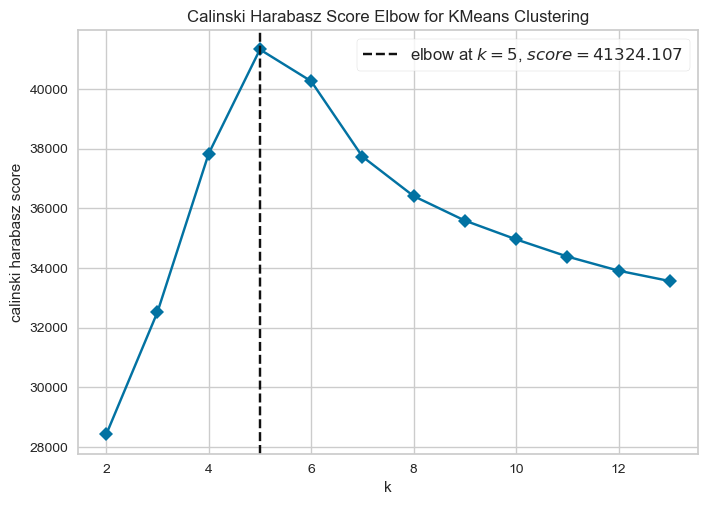

<Axes: title={'center': 'Calinski Harabasz Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='calinski harabasz score'>

In [21]:
RFMS_DF['M'] = np.log(RFMS_DF['orders_total_amount'] + 1)
RFMS_DF['R'] = np.log(RFMS_DF['recency'] + 1)

KM_data = StandardScaler().fit_transform(RFMS_DF.take([9,10,13,14], axis=1))

visualizer = KElbowVisualizer(KMeans(), k=(2,14), metric='calinski_harabasz',\
                              timings=False)
visualizer.fit(KM_data)
visualizer.poof()

<Axes: xlabel='recency', ylabel='frequency'>

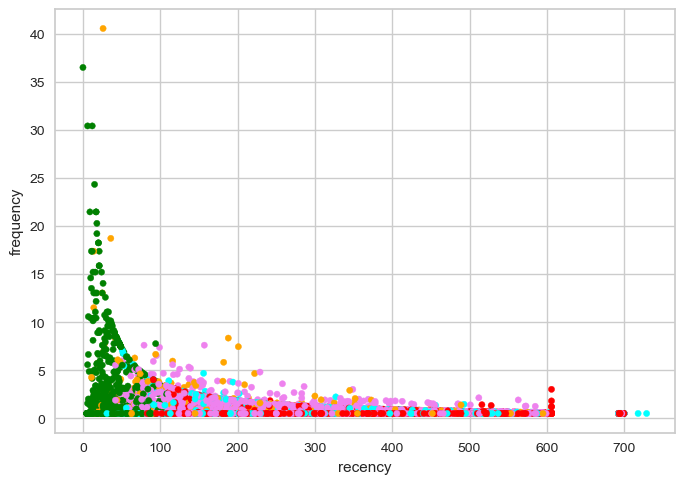

In [22]:
RFMS_DF.to_csv('RFMS_DF.csv')
kmeans = KMeans(n_clusters=5, n_init=10)
kmeans.fit(KM_data)
RFMS_DF['kMeans_clust'] = kmeans.labels_
colors = ['red','aqua','green','orange','violet']
RFMS_DF['color'] = RFMS_DF['kMeans_clust'].map(lambda p: colors[p])
RFMS_DF.plot(kind='scatter', x='recency', y='frequency', c=RFMS_DF['color'])

In [25]:
print('RED    : ' + str(RFMS_DF.loc[RFMS_DF['color'] == 'red',\
                                   'customer_unique_id'].count()))
print('VIOLET : ' + str(RFMS_DF.loc[RFMS_DF['color'] == 'violet',\
                                   'customer_unique_id'].count()))
print('GREEN  : ' + str(RFMS_DF.loc[RFMS_DF['color'] == 'green',\
                                   'customer_unique_id'].count()))
print('BLUE   : ' + str(RFMS_DF.loc[RFMS_DF['color'] == 'aqua',\
                                   'customer_unique_id'].count()))
print('ORANGE : ' + str(RFMS_DF.loc[RFMS_DF['color'] == 'orange',\
                                   'customer_unique_id'].count()))

RED    : 35804
VIOLET : 25689
GREEN  : 15691
BLUE   : 14859
ORANGE : 2940


<Axes: xlabel='recency', ylabel='orders_total_amount'>

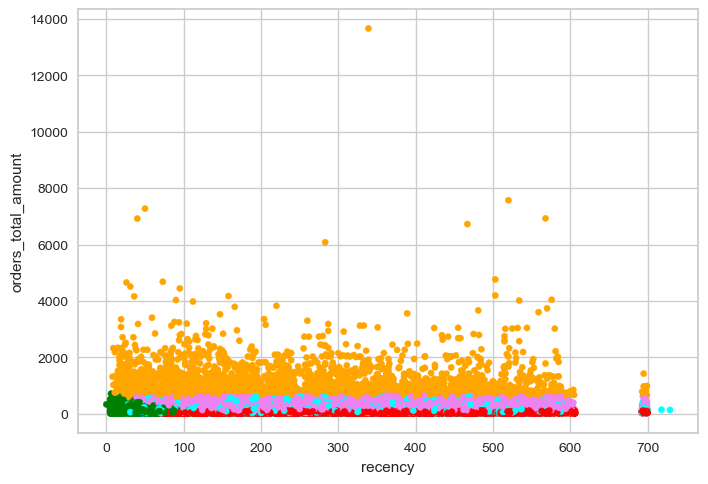

In [26]:
RFMS_DF.plot(kind='scatter', x='recency', y='orders_total_amount', c=RFMS_DF['color'])

<Axes: xlabel='frequency', ylabel='review_score'>

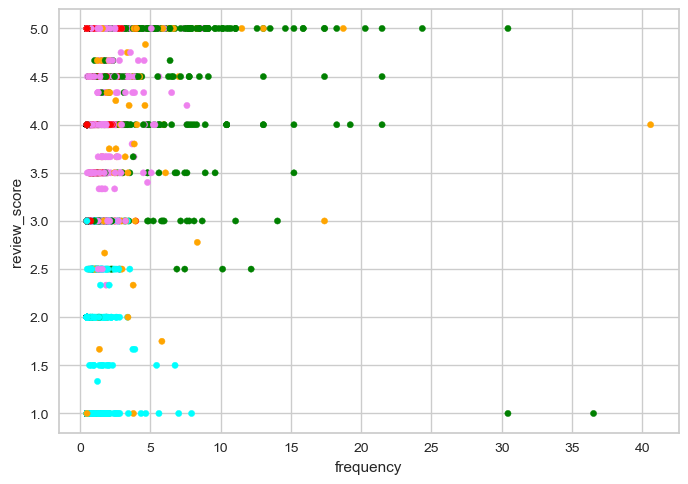

In [27]:
RFMS_DF.plot(kind='scatter', x='frequency', y='review_score', c=RFMS_DF['color'])

<Axes: xlabel='review_score', ylabel='recency'>

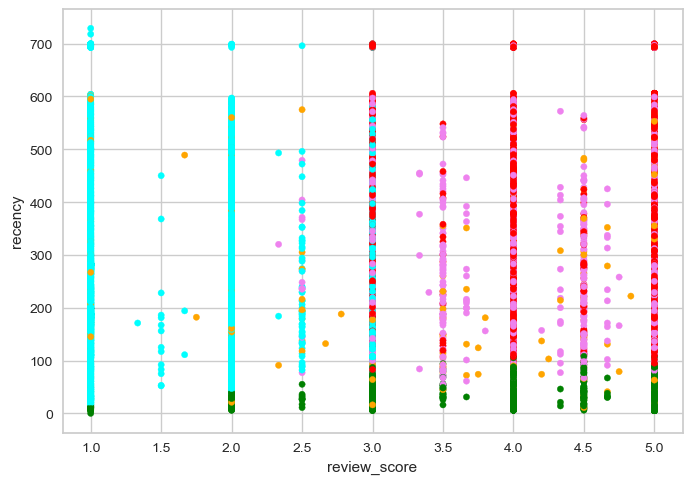

In [28]:
RFMS_DF.plot(kind='scatter', x='review_score', y='recency', c=RFMS_DF['color'])

<Axes: xlabel='orders_total_amount', ylabel='frequency'>

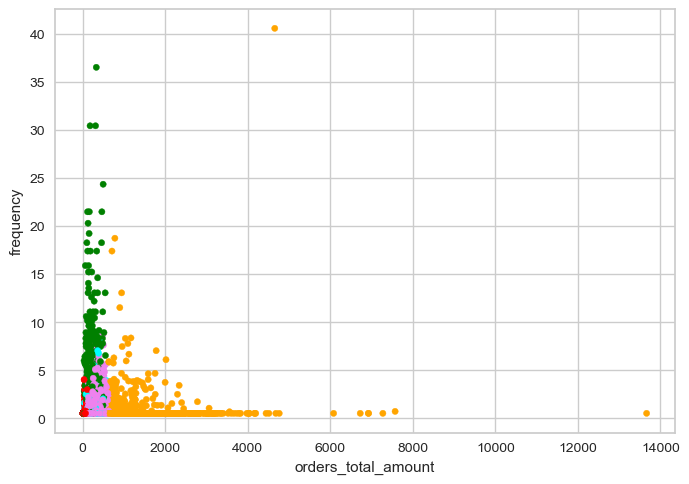

In [29]:
RFMS_DF.plot(kind='scatter', x='orders_total_amount', y='frequency', c=RFMS_DF['color'])

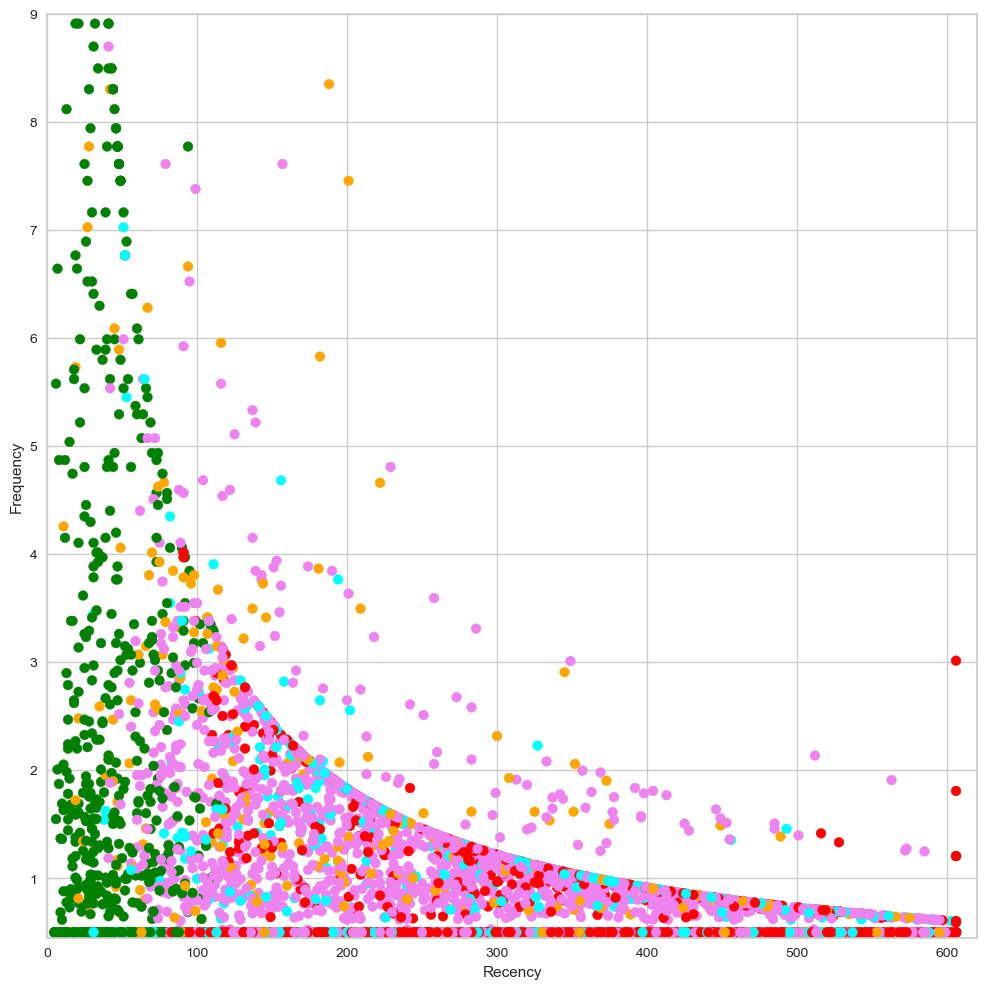

In [33]:
# we need to see these plots more in detail to interpret them relevently
plt.figure(figsize=(12,12))
plt.xlim(0,620)
plt.ylim(0.45,9)
plt.scatter(RFMS_DF['recency'], RFMS_DF['frequency'], c=RFMS_DF['color'])
plt.xlabel('Recency')
plt.ylabel('Frequency')
plt.show()

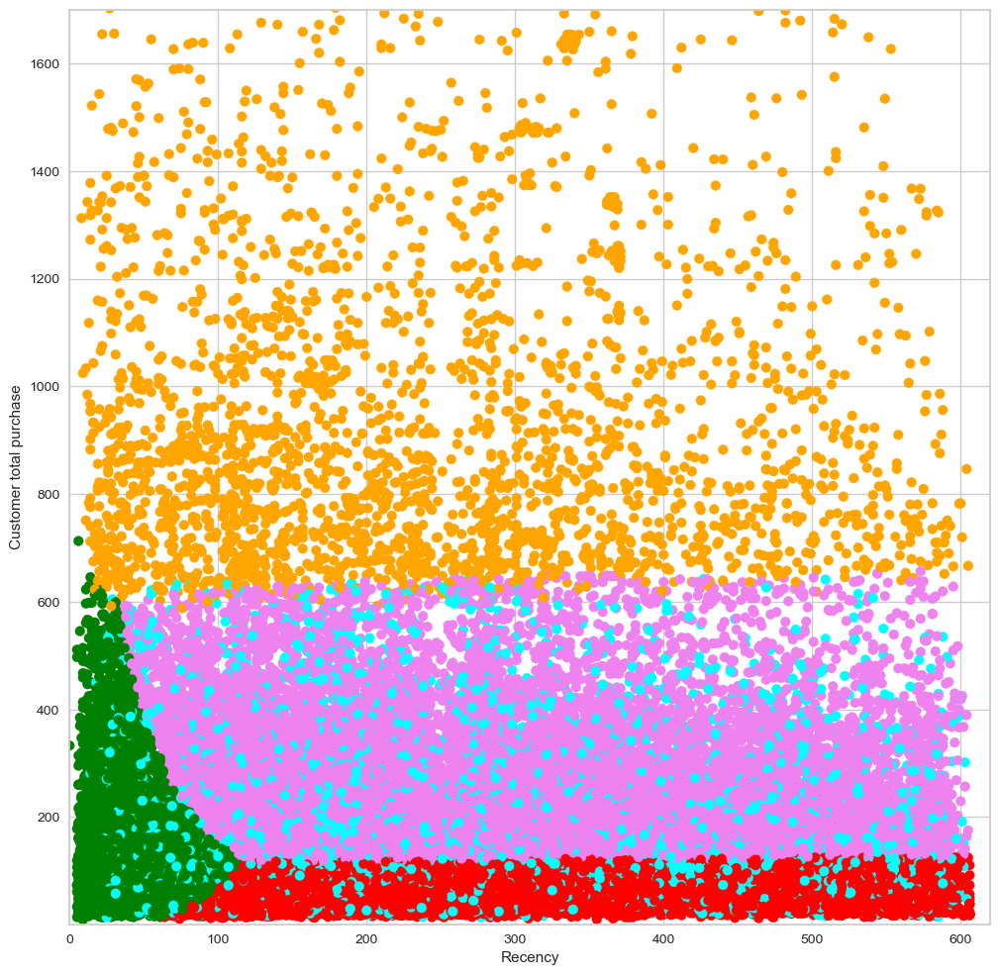

In [32]:
plt.figure(figsize=(12,12))
plt.xlim(0,620)
plt.ylim(1,1700)
plt.scatter(RFMS_DF['recency'], RFMS_DF['orders_total_amount'], c=RFMS_DF['color'])
plt.xlabel('Recency')
plt.ylabel('Customer total purchase')
plt.show()

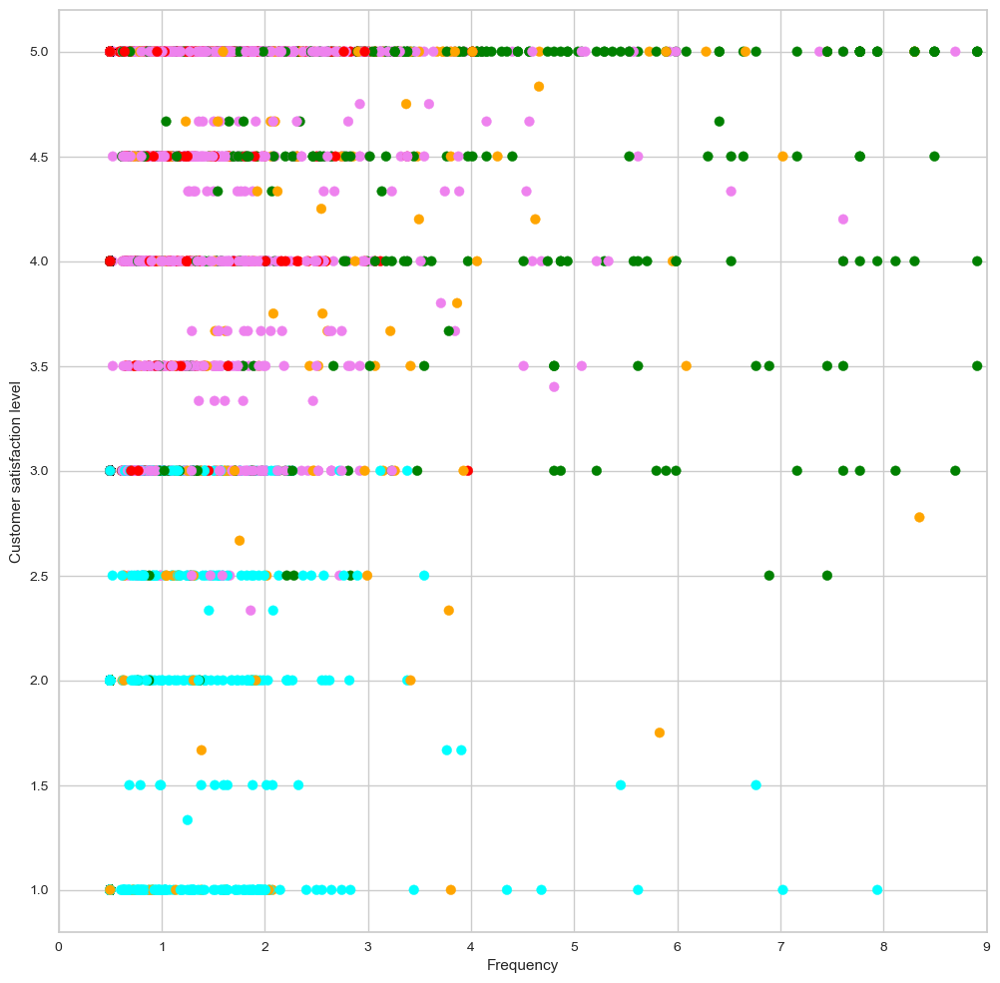

In [35]:
plt.figure(figsize=(12,12))
plt.xlim(0,9)
plt.ylim(0.8,5.2)
plt.scatter(RFMS_DF['frequency'], RFMS_DF['review_score'], c=RFMS_DF['color'])
plt.xlabel('Frequency')
plt.ylabel('Customer satisfaction level')
plt.show()

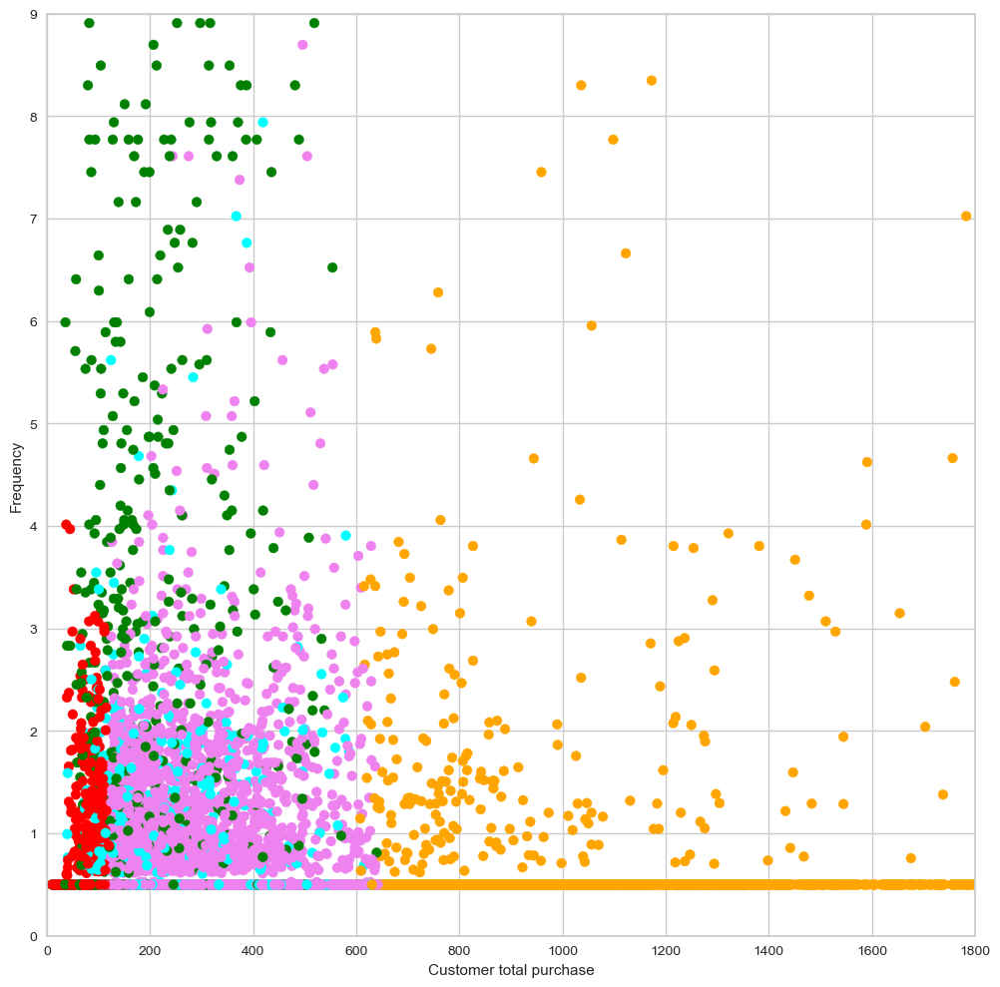

In [37]:
plt.figure(figsize=(12,12))
plt.xlim(0,1800)
plt.ylim(0,9)
plt.scatter(RFMS_DF['orders_total_amount'], RFMS_DF['frequency'], c=RFMS_DF['color'])
plt.xlabel('Customer total purchase')
plt.ylabel('Frequency')
plt.show()

La plus grosse classe est ici la ROUGE, c'est celle des petits acheteurs qui sont satisfaits des services de Olist.
<br>Vient ensuite la VIOLETTE représentant des acheteurs un peu plus dépensiers : minimum de 117 BRL (cf. ci-dessous) et eux aussi sont en grande majorité satisfaits.
<br>Puis la VERTE, caractérisée par un achat récent (moins de 120 jours) mais de montant cumulé limité (moins de 713 BRL), avec un bon niveau de satisfaction global
<br>La classe ORANGE concerne uniquement les plus gros achateurs, quelques soient les autres critères (montant cumulé minimum de 572 BRL)
<br>Enfin la classe BLEUE (bien plus grosse que la orange qui est la plus petite) est caractérisée par un montant cumulé limité (à 643 BRL mais peut être beaucoup plus bas, jusqu'à 13.78 seulement) et surtout par un niveau de satisfaction plutôt mauvais.
<br>**Cette segmentation est donc très interessante, et peut être associée à celle(s) seulement 'RFM' pour un meilleur ciblage des communications.**

In [5]:
RFMS_DF.loc[RFMS_DF['color'] == 'violet', 'orders_total_amount'].min()

117.05

In [6]:
RFMS_DF.loc[RFMS_DF['color'] == 'green', 'recency'].max()

119

In [7]:
RFMS_DF.loc[RFMS_DF['color'] == 'green', 'orders_total_amount'].max()

712.9

In [8]:
RFMS_DF.loc[RFMS_DF['color'] == 'orange', 'orders_total_amount'].min()

572.87

In [9]:
RFMS_DF.loc[RFMS_DF['color'] == 'aqua', 'orders_total_amount'].min()

13.78

In [10]:
RFMS_DF.loc[RFMS_DF['color'] == 'aqua', 'orders_total_amount'].max()

642.64

<a name='E7'>

Nous allons maintenant nous interesser à d'autres données catégorielles (ou qualitatives) qui requièrent d'autres algorithmes de classification, en apprentissage non supervisé.
<br>Considérons par exemple le 'customer_state', le 'product_category_name' et le 'seller_state'; Pourra-t-on trouver des classes signifiantes avec ces trois caractéristiques ?
<br>Nous allons utiliser l'algorithmes du 'K-Modes' pour cela, inspiré du k-means.

In [1]:
customers['customer_state'].value_counts()

customer_state
SP    41746
RJ    12852
MG    11635
RS     5466
PR     5045
SC     3637
BA     3380
DF     2140
ES     2033
GO     2020
PE     1652
CE     1336
PA      975
MT      907
MA      747
MS      715
PB      536
PI      495
RN      485
AL      413
SE      350
TO      280
RO      253
AM      148
AC       81
AP       68
RR       46
Name: count, dtype: int64

In [2]:
products =  pd.read_csv('olist_products_dataset.csv')
products['product_category_name'].value_counts()

product_category_name
cama_mesa_banho                  3029
esporte_lazer                    2867
moveis_decoracao                 2657
beleza_saude                     2444
utilidades_domesticas            2335
                                 ... 
fashion_roupa_infanto_juvenil       5
casa_conforto_2                     5
pc_gamer                            3
seguros_e_servicos                  2
cds_dvds_musicais                   1
Name: count, Length: 73, dtype: int64

In [3]:
products['product_category_name'].value_counts()[0:15]

product_category_name
cama_mesa_banho                3029
esporte_lazer                  2867
moveis_decoracao               2657
beleza_saude                   2444
utilidades_domesticas          2335
automotivo                     1900
informatica_acessorios         1639
brinquedos                     1411
relogios_presentes             1329
telefonia                      1134
bebes                           919
perfumaria                      868
papelaria                       849
fashion_bolsas_e_acessorios     849
cool_stuff                      789
Name: count, dtype: int64

In [4]:
sellers = pd.read_csv('olist_sellers_dataset.csv')
sellers['seller_state'].value_counts()

seller_state
SP    1849
PR     349
MG     244
SC     190
RJ     171
RS     129
GO      40
DF      30
ES      23
BA      19
CE      13
PE       9
PB       6
RN       5
MS       5
MT       4
RO       2
SE       2
PI       1
AC       1
MA       1
AM       1
PA       1
Name: count, dtype: int64

In [5]:
# We have to build the required dataset, based on the items :
items =  pd.read_csv('olist_order_items_dataset.csv')
Cat_DF = items.take([0,1,2,3], axis=1)
products = products.take([0,1], axis=1)
Cat_DF = pd.merge(Cat_DF, products, how='left', on='product_id')
Cat_DF.isnull().sum()

order_id                    0
order_item_id               0
product_id                  0
seller_id                   0
product_category_name    1603
dtype: int64

In [6]:
Cat_DF = Cat_DF.loc[~Cat_DF['product_category_name'].isna(), :]
Cat_DF.shape

(111047, 5)

In [7]:
Cat_DF = pd.merge(Cat_DF, sellers, how='left', on='seller_id')
Cat_DF.isnull().sum()

order_id                  0
order_item_id             0
product_id                0
seller_id                 0
product_category_name     0
seller_zip_code_prefix    0
seller_city               0
seller_state              0
dtype: int64

In [8]:
orders = pd.read_csv('olist_orders_dataset.csv')
orders = orders.take([0,1], axis=1)
Cat_DF = pd.merge(Cat_DF, orders, how='left', on='order_id')
Cat_DF.isnull().sum()

order_id                  0
order_item_id             0
product_id                0
seller_id                 0
product_category_name     0
seller_zip_code_prefix    0
seller_city               0
seller_state              0
customer_id               0
dtype: int64

In [9]:
Cat_DF = pd.merge(Cat_DF, customers, how='left', on='customer_id')
Cat_DF.shape

(111047, 13)

In [10]:
Cat_DF.columns

Index(['order_id', 'order_item_id', 'product_id', 'seller_id',
       'product_category_name', 'seller_zip_code_prefix', 'seller_city',
       'seller_state', 'customer_id', 'customer_unique_id',
       'customer_zip_code_prefix', 'customer_city', 'customer_state'],
      dtype='object')

In [11]:
Cat_DF = Cat_DF.take([4,7,12], axis=1)
Cat_DF.head()

,product_category_name,seller_state,customer_state
0,cool_stuff,SP,RJ
1,pet_shop,SP,SP
2,moveis_decoracao,MG,MG
3,perfumaria,SP,SP
4,ferramentas_jardim,PR,SP


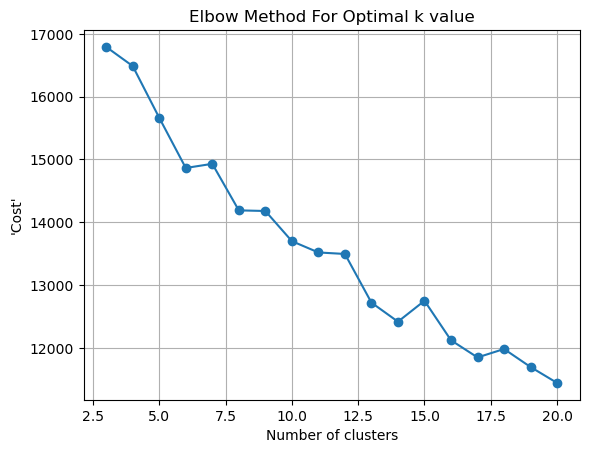

In [13]:
# conda install -c conda-forge kmodes
# from kmodes.kmodes import KModes
Sample_Cat_DF = Cat_DF.loc[[x for x in range(0,111047,10)]]
cost = []
for nb_clusters in range(3,21):
    kmode = KModes(n_clusters=nb_clusters, init = "random", n_init = 5) #, verbose=1)
    kmode.fit_predict(Sample_Cat_DF)
    cost.append(kmode.cost_)

plt.plot(range(3,21), cost, 'o-')
plt.xlabel('Number of clusters')
plt.ylabel('\'Cost\'')
plt.title('Elbow Method For Optimal k value')
plt.grid()
plt.show()

Nous avons plusieurs 'coudes', nous allons voir ce qu'on obtient avec k = 14. Pour cette recherche nous n'avons utilisé qu'un échantillon de 10% des données, maintenant nous allons considérer l'ensemble complet.

In [14]:
kmode = KModes(n_clusters = 14, init = "random", n_init = 28)
clusters = kmode.fit_predict(Cat_DF)
len(clusters)

111047

In [15]:
np.unique(clusters, return_counts=True)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13],
       dtype=uint16),
 array([43109,  7616, 14743,  5756,  4243,  3961,  3893,  1971,  5974,
         1383,  7982,  3704,  5235,  1477], dtype=int64))

In [16]:
Cat_DF['clusters'] = clusters
Cat_DF.head(15)

,product_category_name,seller_state,customer_state,clusters
0,cool_stuff,SP,RJ,10
1,pet_shop,SP,SP,0
2,moveis_decoracao,MG,MG,2
3,perfumaria,SP,SP,13
4,ferramentas_jardim,PR,SP,0
5,utilidades_domesticas,SP,MG,2
6,telefonia,SP,SP,0
7,ferramentas_jardim,SP,SP,0
8,beleza_saude,SP,SP,0
9,livros_tecnicos,SP,SP,0


In [18]:
# Let's study a bit these clusters :
Clust_0 = Cat_DF.loc[Cat_DF['clusters'] == 0, ['product_category_name',
                                               'seller_state',
                                               'customer_state']]
np.unique(Clust_0, return_counts=True)

(array(['AC', 'AL', 'AM', 'AP', 'BA', 'CE', 'DF', 'ES', 'GO', 'MA', 'MG',
        'MS', 'MT', 'PA', 'PB', 'PE', 'PI', 'PR', 'RJ', 'RN', 'RO', 'RR',
        'RS', 'SC', 'SE', 'SP', 'TO', 'agro_industria_e_comercio',
        'alimentos', 'alimentos_bebidas', 'artes', 'artes_e_artesanato',
        'artigos_de_festas', 'artigos_de_natal', 'audio', 'automotivo',
        'bebes', 'bebidas', 'beleza_saude', 'brinquedos', 'casa_conforto',
        'casa_conforto_2', 'casa_construcao', 'cds_dvds_musicais',
        'cine_foto', 'climatizacao', 'consoles_games',
        'construcao_ferramentas_construcao',
        'construcao_ferramentas_ferramentas',
        'construcao_ferramentas_iluminacao',
        'construcao_ferramentas_jardim',
        'construcao_ferramentas_seguranca', 'cool_stuff', 'dvds_blu_ray',
        'eletrodomesticos', 'eletrodomesticos_2', 'eletronicos',
        'eletroportateis', 'esporte_lazer', 'fashion_bolsas_e_acessorios',
        'fashion_calcados', 'fashion_esporte', 'fash

In [20]:
Clust_0[['product_category_name','seller_state','customer_state']].nunique()

product_category_name    68
seller_state             22
customer_state           27
dtype: int64

On trouve pratiquement de tout dans cette classe, elle ne devrait donc pas être très utile en termes de segmentation; Regardons une plus petite :

In [21]:
Clust_2 = Cat_DF.loc[Cat_DF['clusters'] == 2, ['product_category_name',
                                               'seller_state',
                                               'customer_state']]
Clust_2[['product_category_name','seller_state','customer_state']].nunique()

product_category_name    69
seller_state             20
customer_state           26
dtype: int64

In [22]:
# Not really better, so let's try with the last cluster :
Clust_13 = Cat_DF.loc[Cat_DF['clusters'] == 13, ['product_category_name',
                                                 'seller_state',
                                                 'customer_state']]
Clust_13[['product_category_name','seller_state','customer_state']].nunique()

product_category_name     1
seller_state             10
customer_state            1
dtype: int64

In [23]:
# More interresting !
Clust_13.head()

,product_category_name,seller_state,customer_state
3,perfumaria,SP,SP
17,perfumaria,SP,SP
195,perfumaria,SP,SP
217,perfumaria,SP,SP
242,perfumaria,SP,SP


In [25]:
Clust_13['seller_state'].unique()

array(['SP', 'MG', 'RJ', 'PR', 'DF', 'MT', 'GO', 'RS', 'SC', 'ES'],
      dtype=object)

In [26]:
# above we have 9 of the 10 bigger seller states
np.unique(Clust_2.loc[Clust_2['product_category_name'] == 'climatizacao',
                      ['seller_state','customer_state']], return_counts=True)

(array(['DF', 'MG', 'RJ', 'SP'], dtype=object),
 array([ 1, 23,  2,  8], dtype=int64))

In [27]:
Clust_2.loc[Clust_2['product_category_name'] == 'climatizacao',
                      ['seller_state','customer_state']]

,seller_state,customer_state
7553,SP,MG
8768,SP,MG
10128,SP,MG
22298,SP,MG
22724,SP,MG
22725,SP,MG
22726,SP,MG
34322,MG,MG
34817,DF,MG
51049,SP,MG


In [28]:
Clust_2.value_counts()

product_category_name      seller_state  customer_state
cama_mesa_banho            SP            MG                1154
moveis_decoracao           SP            MG                 674
beleza_saude               SP            MG                 612
                                         RJ                 575
esporte_lazer              SP            MG                 571
                                                           ... 
cine_foto                  DF            MG                   1
                           SP            MG                   1
climatizacao               DF            MG                   1
consoles_games             DF            MG                   1
agro_industria_e_comercio  MG            MG                   1
Name: count, Length: 457, dtype: int64

In [29]:
Clust_13.value_counts()

product_category_name  seller_state  customer_state
perfumaria             SP            SP                1062
                       RJ            SP                 225
                       PR            SP                  75
                       MG            SP                  44
                       SC            SP                  29
                       DF            SP                  15
                       MT            SP                  14
                       GO            SP                   8
                       RS            SP                   3
                       ES            SP                   2
Name: count, dtype: int64

In [31]:
Clust_5 = Cat_DF.loc[Cat_DF['clusters'] == 5, ['product_category_name',
                                               'seller_state',
                                               'customer_state']]
Clust_5.value_counts()

product_category_name  seller_state  customer_state
cama_mesa_banho        SP            PR                392
moveis_decoracao       SP            PR                363
perfumaria             SP            RJ                246
esporte_lazer          SP            PR                243
telefonia              SP            PR                226
                                                      ... 
perfumaria             SC            BA                  1
                       ES            RS                  1
                       MT            RN                  1
                       SC            DF                  1
                       GO            BA                  1
Name: count, Length: 139, dtype: int64

En regardant en détail, on voit qu'il y a des liens entre les différentes catégories des classes constituées. Mais c'est un peu difficile à exploiter, il me semble plus simple de chercher directement ce qui nous intéresse dans Cat_DF, par exemple le nombre et l'emplacement des commandes de 'audio' dont le vendeur est dans l'état DF :

In [34]:
Cat_DF.loc[(Cat_DF['product_category_name'] == 'audio') &
           (Cat_DF['seller_state'] == 'DF'), 'customer_state'].value_counts()

customer_state
SP    4
MG    1
BA    1
DF    1
RJ    1
PE    1
Name: count, dtype: int64

Cette classification n'est pas très pertinente avec les données choisies ici, mais pour certains types de données elle peut être très utile. Le nombre de clusters choisi dans notre exemple n'est peut être pas non plus le plus pertinent, par contre il peut être interessant de choisir précisément certains centroïdes qui nous intéressent plutôt que de faire une initialisation aléatoire. Mais la documentation est faible à ce sujet, à part 'random' les modes d'initialisation sont 'Huang' et 'Cao' (?) mais pas de 'custom' apparemment.
<br>https://github.com/nicodv/kmodes